In [1]:
###########################################################################################################################
#
# Antonio Vieira da Silva Neto - NUSP  5690149 - Doutorando em Ciências
# Henrique Lefundes da Silva   - NUSP 11808280 - Pesquisador de Iniciação Científica e Graduando em Engenharia Elétrica
#
# Escola Politécnica da Universidade de São Paulo
# Programa de Pós-Graduação em Engenharia Elétrica
# Departamento de Engenharia de Computação e Sistemas Digitais
# Área de Concentração: Confiabilidade e Segurança
#
# Tese de Doutorado: Safety ArtISt: Um Método para a Garantia de Segurança Crítica de Sistemas com Inteligência Artificial
#
# Estudo de Caso 4 - Sistema de Controle de Frenagem de Veículos
#
# Arquivo para geração do modelo base de IA
#
###########################################################################################################################

###########################################################################################################################
#
# Tabela de Controle de Versões do Código
#
#--------|-------------------|------------------------------|--------------------------------------------------------------
# Versão | Data (dd/mm/aaaa) | Autor                        | Descrição da Versão
#--------|-------------------|------------------------------|--------------------------------------------------------------
#   01   |    28/07/2022     | Henrique Lefundes da Silva   | Versão inicial.
#--------|-------------------|------------------------------|--------------------------------------------------------------
#   01   |    04/08/2022     | Henrique Lefundes da Silva   | Testes com diferentes datasets; função de testes automáticos;
#        |                   |                              | Árvore com dataset estraficado.
#--------|-------------------|------------------------------|--------------------------------------------------------------
#   03   |    29/12/2022     | Henrique Lefundes da Silva   | Multiplas árvores criadas, com diferentes tipos de estrafica-
#        |                   |                              | ção; função de votação de saídas; conversão das árvores uti-
#        |                   |                              | lizando o Conifer; Análise de erros da floresta aletória em 
#        |                   |                              | HDL; Análise da influência da precisão no erro.
#--------|-------------------|------------------------------|--------------------------------------------------------------
#   04   |    20/01/2023     | Henrique Lefundes da Silva   | Novas árvores criadas; segunda árvore criada para outro FGPA;
#        |                   |                              | Implementação de funções para votação considerando FPGA 1 e 2;
#        |                   |                              | Análise do uso de LUT's de para diferentes max_depth;
#        |                   |                              | Verificação da função de conversão criada.
#--------|-------------------|------------------------------|--------------------------------------------------------------
###########################################################################################################################

# Importação de Bibliotecas
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import plot_tree
from sklearn.tree import export_graphviz
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import make_scorer, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, classification_report 
from stratify import StratifyData
from scipy.stats import mode

In [2]:
# Pré-processamento dos dados (pre_processing)

def pre_processing(address):
    dataColumns = ["Distância Ruidosa", "Velocidade Ruidosa", "Capacidade de Frenagem Ruidosa",
                    "Decisão"]
    
    dataset = pd.read_csv(address, header = None, names = dataColumns)
    
    return dataset

In [3]:
# Função criada para automatizar o processo de testes para diferentes datasets, 
# caso queira testar a árvore no dataset de testes 1, basta chamar automatic_test(1)
# Nome padrão dos datasets de teste: DatasetTX, onde X corresponde a numeração do dataset

def automatic_test(dataset_test_number, decision_tree): 
    # Lê base de dados 
    pp_dataset_test = pre_processing(f"DatasetT{dataset_test_number}.csv")
    
    # Define entradas e saída
    pp_data_inputs_test = pp_dataset_test.drop(columns = ['Decisão'])
    pp_data_outputs_test = pp_dataset_test[['Decisão']]

    # Valores preditos pela árvore treinada
    predicted_apply_brakes = decision_tree.predict(pp_data_inputs_test)

    # Métricas de performance
    finalAccuracy = accuracy_score(pp_data_outputs_test, predicted_apply_brakes)
    finalPrecision = precision_score(pp_data_outputs_test, predicted_apply_brakes)
    finalRecall = recall_score(pp_data_outputs_test, predicted_apply_brakes)
    finalF1 = f1_score(pp_data_outputs_test, predicted_apply_brakes)
    finalConfusionMatrix = confusion_matrix(pp_data_outputs_test, predicted_apply_brakes)
    finalClassificationReport = classification_report(pp_data_outputs_test, predicted_apply_brakes)

    # Imprime resultados finais
    print(f'******** Resultados DatasetT{dataset_test_number} ********')
    print('Accuracy:', finalAccuracy*100)
    print('Precision:', finalPrecision*100)
    print('Recall:', finalRecall*100)
    print('F1-Score:', finalF1*100)
    print(finalConfusionMatrix)
    ConfusionMatrixDisplay(finalConfusionMatrix).plot()
    plt.show()

In [4]:
def voting(dataset, classifiers):
    pp_dataset_test = pre_processing(dataset)
    
    # Define entradas e saída
    pp_data_inputs_test = pp_dataset_test.drop(columns = ['Decisão'])

    lines = len(pp_data_inputs_test)
    columns = len(classifiers)

    decision_tree_inputs = np.zeros((lines,columns))

    for i in range(len(classifiers)):
        decision_tree_inputs[:,i] = classifiers[i].predict(pp_data_inputs_test)

    final_prediction = np.zeros((lines))

    for i in range(len(pp_data_inputs_test)):
        final_prediction[i] = mode(decision_tree_inputs[i], keepdims = False)[0]

    return final_prediction

<h1>decision_tree_1</h1>

In [5]:
# Realiza a leitura do arquivo CSV
# O arquivo se encontra numa pasta dentro do diretório deste programa:
# ./Árvore de Decisão/Dataset/Dataset.csv
pp_dataset = pre_processing("DatasetT&V.csv")
display(pp_dataset)

#Define as entradas e as saídas do dataset
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,0.000000,0.000000,1.3950,1.0
1,0.000000,0.000000,1.1625,1.0
2,1.579846,0.000000,0.9300,1.0
3,0.282185,0.000000,0.7800,1.0
4,0.394876,0.000000,0.6500,1.0
...,...,...,...,...
57280,2000.433820,26.977928,1.3950,0.0
57281,1999.988138,28.886308,1.1625,0.0
57282,1998.246886,28.409583,0.9300,0.0
57283,2002.044078,27.358991,0.7800,0.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,0.000000,0.000000,1.3950
1,0.000000,0.000000,1.1625
2,1.579846,0.000000,0.9300
3,0.282185,0.000000,0.7800
4,0.394876,0.000000,0.6500
...,...,...,...
57280,2000.433820,26.977928,1.3950
57281,1999.988138,28.886308,1.1625
57282,1998.246886,28.409583,0.9300
57283,2002.044078,27.358991,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


In [6]:
random_state = 1

# Definição dos hiperparâmetros

criterion = ['entropy', 'gini']

splitter = ['best', 'random']

max_depth = [int(x) for x in np.arange(1, 22, step = 2)] # max_depth já limitado

min_samples_split = [int(x) for x in np.arange(2, 18, step = 3)]

min_samples_leaf = [int(x) for x in np.arange(1, 18, step = 3)]

min_weight_fraction_leaf = [float(x) for x in np.linspace(0,0.5,5)] # não houve 1 RandomSearch que fosse diferente de 0

max_leaf_nodes = [int(x) for x in np.arange(200, 510, step = 10)]
max_leaf_nodes.append(None)

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 
max_features.append('log2')
max_features.append('sqrt')
max_features.append(None)

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')


Número de combinações possíveis: 1520640
{'criterion': ['entropy', 'gini'], 'splitter': ['best', 'random'], 'max_depth': [1, 3, 5, 7, 9, 11, 13, 15, 17, 19, 21], 'min_samples_split': [2, 5, 8, 11, 14, 17], 'min_samples_leaf': [1, 4, 7, 10, 13, 16], 'min_weight_fraction_leaf': [0.0, 0.125, 0.25, 0.375, 0.5], 'max_leaf_nodes': [200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, None], 'max_features': [1, 2, 3, 'log2', 'sqrt', None]}
Tempo estimado de processamento: 178.6 segundos


In [20]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com RandomSearch
dtTries = RandomizedSearchCV(estimator = starting_decision_tree, param_distributions = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1, n_iter = n_iter)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)


Fitting 10 folds for each of 2500 candidates, totalling 25000 fits


RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=2500, n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [1, 3, 5, 7, 9, 11, 13, 15,
                                                      17, 19, 21],
                                        'max_features': [1, 2, 3, 'log2',
                                                         'sqrt', None],
                                        'max_leaf_nodes': [200, 210, 220, 230,
                                                           240, 250, 260, 270,
                                                           280, 290, 300, 310,
                                                           320, 330, 340, 350,
                                                           360, 370, 380, 390,
                                                           400, 410, 420, 430,
                                                           440, 450, 460, 470,
                                                           480, 490, ...],
                                        'min_samples_leaf': [1, 4, 7, 10, 13,
                                                             16],
                                        'min_samples_split': [2, 5, 8, 11, 14,
                                                              17],
                                        'min_weight_fraction_leaf': [0.0, 0.125,
                                                                     0.25,
                                                                     0.375,
                                                                     0.5],
                                        'splitter': ['best', 'random']},
                   scoring='recall', verbose=3)

In [21]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'splitter': 'best', 'min_weight_fraction_leaf': 0.0, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_leaf_nodes': 250, 'max_features': 3, 'max_depth': 17, 'criterion': 'entropy'}
10 - Fold Best recall-score:  96.31851175121963


In [24]:
# Segunda iteração

splitter = ['best']

min_weight_fraction_leaf = [0]

min_samples_split = [int(x) for x in np.arange(2, 8, step = 1)]

min_samples_leaf = [int(x) for x in np.arange(1, 4, step = 1)]

max_leaf_nodes = [int(x) for x in np.arange(230, 280, step = 5)]

max_features = [2,3] 

max_depth = [int(x) for x in np.arange(15, 20, step = 1)]

criterion = ['entropy']

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

{'criterion': ['entropy'], 'splitter': ['best'], 'max_depth': [15, 16, 17, 18, 19], 'min_samples_split': [2, 3, 4, 5, 6, 7], 'min_samples_leaf': [1, 2, 3], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [230, 235, 240, 245, 250, 255, 260, 265, 270, 275], 'max_features': [2, 3]}


In [25]:
# Optimização dos hiperparâmetros com GridSearch
dtTries = GridSearchCV(estimator = starting_decision_tree, param_grid = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 1800 candidates, totalling 18000 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['entropy'],
                         'max_depth': [15, 16, 17, 18, 19],
                         'max_features': [2, 3],
                         'max_leaf_nodes': [230, 235, 240, 245, 250, 255, 260,
                                            265, 270, 275],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4, 5, 6, 7],
                         'min_weight_fraction_leaf': [0],
                         'splitter': ['best']},
             scoring='recall', verbose=3)

In [26]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'criterion': 'entropy', 'max_depth': 16, 'max_features': 3, 'max_leaf_nodes': 270, 'min_samples_leaf': 3, 'min_samples_split': 6, 'min_weight_fraction_leaf': 0, 'splitter': 'best'}
10 - Fold Best recall-score:  96.66626648913098


<h2>final_decision_tree_1</h2>

Accuracy: 99.3104652177708
Precision: 97.29493891797557
Recall: 95.87274290627687
F1-Score: 96.57860545690777
[[10263    31]
 [   48  1115]]


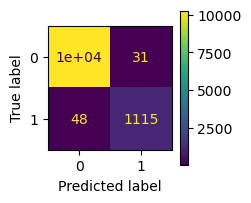

******** Resultados DatasetT1 ********
Accuracy: 99.36632626341975
Precision: 97.26938561176264
Recall: 96.4087439278279
F1-Score: 96.83715256600158
[[51365   156]
 [  207  5557]]


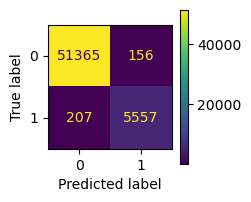

******** Resultados DatasetT2 ********
Accuracy: 99.35236100200751
Precision: 97.21589914200666
Recall: 96.32199861207495
F1-Score: 96.76688453159042
[[51362   159]
 [  212  5552]]


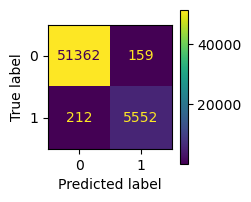

******** Resultados DatasetT3 ********
Accuracy: 99.36807192109627
Precision: 97.18728162124388
Recall: 96.51283830673144
F1-Score: 96.84888579387186
[[51360   161]
 [  201  5563]]


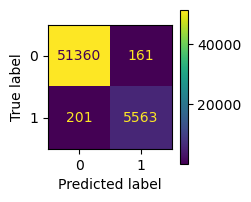

In [6]:
# Árvore de decisão final
#final_decision_tree_1 = dtTries.best_estimator_

final_decision_tree_1 = DecisionTreeClassifier(criterion = 'entropy', 
                                            max_depth = 16, 
                                            max_features = 3, 
                                            max_leaf_nodes = 270, 
                                            min_samples_leaf = 3, 
                                            min_samples_split = 6,
                                            min_weight_fraction_leaf = 0, 
                                            splitter = 'best')

# Holdout test
inputsTrain, inputsTest, outputsTrain, outputsTest = train_test_split(pp_data_inputs, 
                                                                      pp_data_outputs,
                                                                      test_size = 0.2)

final_decision_tree_1.fit(inputsTrain, outputsTrain)

# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_1.predict(inputsTest)

# Métricas de performance
finalAccuracy = accuracy_score(outputsTest, predicted_apply_brakes)
finalPrecision = precision_score(outputsTest, predicted_apply_brakes)
finalRecall = recall_score(outputsTest, predicted_apply_brakes)
finalF1 = f1_score(outputsTest, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(outputsTest, predicted_apply_brakes)
finalClassificationReport = classification_report(outputsTest, predicted_apply_brakes)

plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 100
# Plot da árvore de decisão treinada, comentado para diminuir tempo de execução
# plot_tree(final_decision_tree)
# plt.show()

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

# Testes para DatasetT1, DatasetT2 e DatasetT3
automatic_test(1,final_decision_tree_1)
automatic_test(2,final_decision_tree_1)
automatic_test(3,final_decision_tree_1)

In [53]:
# Teste para dataset sem ruído 
dataColumns = ['Distancia Ruidosa', 'Velocidade Ruidosa', 'Capacidade de Frenagem Ruidosa', 'Distancia', 'Velocidade', 
                'Capacidade de Frenagem', 'Decisão', 'Aceleracao', 'AW', 'AG', 'VH', 'VC', 'V50', 'DS', 'Decisao Ruidosa', 
                'Aceleracao Ruidosa', 'AW Ruidosa', 'AG Ruidosa', 'VH Ruidosa', 'VC Ruidosa', 'V50 Ruidosa', 'DS Ruidosa']
    
pp_dataset_test = pd.read_csv("DatasetT&VDebug.csv", header = None, names = dataColumns)

pp_data_inputs_test = pp_dataset_test[['Distancia', 'Velocidade', 'Capacidade de Frenagem']]
pp_data_inputs_test = pp_data_inputs_test.rename(columns={"Distancia":"Distância Ruidosa","Velocidade":"Velocidade Ruidosa", "Capacidade de Frenagem":"Capacidade de Frenagem Ruidosa"})

print(pp_data_inputs_test)

pp_data_outputs_test = pp_dataset_test[['Decisão']]

print(pp_data_outputs_test)



       Distância Ruidosa  Velocidade Ruidosa  Capacidade de Frenagem Ruidosa
0                    0.0                 0.0                          1.3950
1                    0.0                 0.0                          1.1625
2                    0.0                 0.0                          0.9300
3                    0.0                 0.0                          0.7800
4                    0.0                 0.0                          0.6500
...                  ...                 ...                             ...
57280             2000.0                28.0                          1.3950
57281             2000.0                28.0                          1.1625
57282             2000.0                28.0                          0.9300
57283             2000.0                28.0                          0.7800
57284             2000.0                28.0                          0.6500

[57285 rows x 3 columns]
       Decisão
0          1.0
1          1.0
2    

******** Resultados dataset sem ruido ********
Accuracy: 99.52692676966048
Precision: 97.64093668690373
Recall: 97.65787647467037
F1-Score: 97.64940584612717
[[51385   136]
 [  135  5629]]


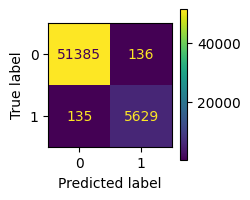

In [54]:
# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_1.predict(pp_data_inputs_test)

# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs_test, predicted_apply_brakes)
finalPrecision = precision_score(pp_data_outputs_test, predicted_apply_brakes)
finalRecall = recall_score(pp_data_outputs_test, predicted_apply_brakes)
finalF1 = f1_score(pp_data_outputs_test, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(pp_data_outputs_test, predicted_apply_brakes)
finalClassificationReport = classification_report(pp_data_outputs_test, predicted_apply_brakes)

# Imprime resultados finais
print(f'******** Resultados dataset sem ruido ********')
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()  

<h1>decision_tree_2</h1>

In [7]:
pp_dataset = pre_processing("DatasetStratified80v3.csv")
display(pp_dataset) 

pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs) #Entradas

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs) #Saídas

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,1513.240000,19.404649,0.780,0.0
1,1579.179929,19.212684,1.395,0.0
2,140.877769,18.508253,0.780,1.0
3,131.171315,18.916247,1.395,1.0
4,1039.015117,3.290000,0.780,0.0
...,...,...,...,...
57280,540.216937,13.603871,0.930,0.0
57281,1547.625493,16.070486,1.395,0.0
57282,10.800206,4.257071,1.395,1.0
57283,1509.641991,11.400315,0.930,0.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,1513.240000,19.404649,0.780
1,1579.179929,19.212684,1.395
2,140.877769,18.508253,0.780
3,131.171315,18.916247,1.395
4,1039.015117,3.290000,0.780
...,...,...,...
57280,540.216937,13.603871,0.930
57281,1547.625493,16.070486,1.395
57282,10.800206,4.257071,1.395
57283,1509.641991,11.400315,0.930


,Decisão
0,0.0
1,0.0
2,1.0
3,1.0
4,0.0
...,...
57280,0.0
57281,0.0
57282,1.0
57283,0.0


In [15]:
random_state = 1
# Definição dos hiperparâmetros

criterion = ['entropy', 'gini']

splitter = ['best', 'random']

max_depth = [int(x) for x in np.arange(1, 10, step = 1)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 18, step = 3)]

min_samples_leaf = [int(x) for x in np.arange(1, 18, step = 3)]

min_weight_fraction_leaf = [0] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(200, 510, step = 10)]
max_leaf_nodes.append(None)

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 
max_features.append('log2')
max_features.append('sqrt')
max_features.append(None)

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500 

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')

Número de combinações possíveis: 248832
{'criterion': ['entropy', 'gini'], 'splitter': ['best', 'random'], 'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9], 'min_samples_split': [2, 5, 8, 11, 14, 17], 'min_samples_leaf': [1, 4, 7, 10, 13, 16], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, None], 'max_features': [1, 2, 3, 'log2', 'sqrt', None]}
Tempo estimado de processamento: 178.6 segundos


In [16]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com RandomSearch
dtTries = RandomizedSearchCV(estimator = starting_decision_tree, param_distributions = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 1, n_jobs = -1, n_iter = n_iter)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)


Fitting 10 folds for each of 2500 candidates, totalling 25000 fits


RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=2500, n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [1, 2, 3, 4, 5, 6, 7, 8,
                                                      9],
                                        'max_features': [1, 2, 3, 'log2',
                                                         'sqrt', None],
                                        'max_leaf_nodes': [200, 210, 220, 230,
                                                           240, 250, 260, 270,
                                                           280, 290, 300, 310,
                                                           320, 330, 340, 350,
                                                           360, 370, 380, 390,
                                                           400, 410, 420, 430,
                

In [18]:
print(dtTries.best_params_) 
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'splitter': 'best', 'min_weight_fraction_leaf': 0, 'min_samples_split': 8, 'min_samples_leaf': 4, 'max_leaf_nodes': 480, 'max_features': None, 'max_depth': 9, 'criterion': 'entropy'}
10 - Fold Best recall-score:  97.89751863340747


In [19]:
# Segunda iteração

splitter = ['best']

min_weight_fraction_leaf = [0] 

min_samples_split = [int(x) for x in np.arange(5, 11, step = 1)]

min_samples_leaf = [int(x) for x in np.arange(2, 7, step = 1)]

max_leaf_nodes = [int(x) for x in np.arange(460, 505, step = 5)]

max_features = [None] 

max_depth = [int(x) for x in np.arange(5, 10, step = 1)]

criterion = ['entropy']

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

{'criterion': ['entropy'], 'splitter': ['best'], 'max_depth': [5, 6, 7, 8, 9], 'min_samples_split': [5, 6, 7, 8, 9, 10], 'min_samples_leaf': [2, 3, 4, 5, 6], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [460, 465, 470, 475, 480, 485, 490, 495, 500], 'max_features': [None]}


In [20]:
# Optimização dos hiperparâmetros com GridSearch
dtTries = GridSearchCV(estimator = starting_decision_tree, param_grid = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 1, n_jobs = -1)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 1350 candidates, totalling 13500 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['entropy'], 'max_depth': [5, 6, 7, 8, 9],
                         'max_features': [None],
                         'max_leaf_nodes': [460, 465, 470, 475, 480, 485, 490,
                                            495, 500],
                         'min_samples_leaf': [2, 3, 4, 5, 6],
                         'min_samples_split': [5, 6, 7, 8, 9, 10],
                         'min_weight_fraction_leaf': [0],
                         'splitter': ['best']},
             scoring='recall', verbose=1)

In [21]:
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'criterion': 'entropy', 'max_depth': 8, 'max_features': None, 'max_leaf_nodes': 465, 'min_samples_leaf': 3, 'min_samples_split': 8, 'min_weight_fraction_leaf': 0, 'splitter': 'best'}
10 - Fold Best recall-score:  97.78097595615463


<h2>final_decision_tree_2</h2>

Accuracy: 98.49881301494204
Precision: 96.08443990466462
Recall: 96.57768651608487
F1-Score: 96.33043181430277
[[11285   115]
 [  100  2822]]


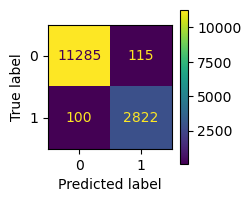

******** Resultados DatasetT1 ********
Accuracy: 98.88277908702104
Precision: 91.94499017681729
Recall: 97.4323386537127
F1-Score: 94.60916442048517
[[51029   492]
 [  148  5616]]


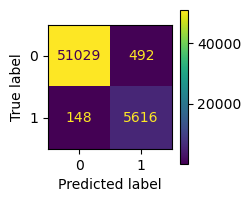

******** Resultados DatasetT2 ********
Accuracy: 98.89849000610981
Precision: 92.02554445718029
Recall: 97.50173490631506
F1-Score: 94.6845253137899
[[51034   487]
 [  144  5620]]


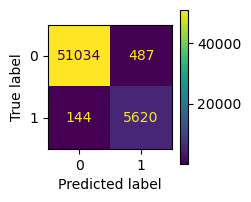

******** Resultados DatasetT3 ********
Accuracy: 98.90372697913939
Precision: 92.32036914963744
Recall: 97.18945176960445
F1-Score: 94.69235970250168
[[51055   466]
 [  162  5602]]


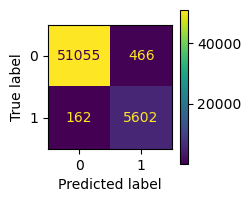

In [8]:
#final_decision_tree_2 = dtTries.best_estimator_

final_decision_tree_2 = DecisionTreeClassifier(criterion = 'entropy', 
                                            max_depth = 8, 
                                            max_features = None, 
                                            max_leaf_nodes = 465, 
                                            min_samples_leaf = 3, 
                                            min_samples_split = 8,
                                            min_weight_fraction_leaf = 0, 
                                            splitter = 'best')

# Holdout test
inputsTrain, inputsTest, outputsTrain, outputsTest = train_test_split(pp_data_inputs, 
                                                                      pp_data_outputs,
                                                                      test_size = 0.25) # 20% dos dados para teste, com 50% das saídas sendo 0

final_decision_tree_2.fit(inputsTrain, outputsTrain)

# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_2.predict(inputsTest)

# Métricas de performance
finalAccuracy = accuracy_score(outputsTest, predicted_apply_brakes)
finalPrecision = precision_score(outputsTest, predicted_apply_brakes)
finalRecall = recall_score(outputsTest, predicted_apply_brakes)
finalF1 = f1_score(outputsTest, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(outputsTest, predicted_apply_brakes)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

automatic_test(1, final_decision_tree_2)
automatic_test(2, final_decision_tree_2)
automatic_test(3, final_decision_tree_2)

In [62]:
# Teste para dataset sem ruído 
dataColumns = ['Distancia Ruidosa', 'Velocidade Ruidosa', 'Capacidade de Frenagem Ruidosa', 'Distancia', 'Velocidade', 
                'Capacidade de Frenagem', 'Decisão', 'Aceleracao', 'AW', 'AG', 'VH', 'VC', 'V50', 'DS', 'Decisao Ruidosa', 
                'Aceleracao Ruidosa', 'AW Ruidosa', 'AG Ruidosa', 'VH Ruidosa', 'VC Ruidosa', 'V50 Ruidosa', 'DS Ruidosa']
    
pp_dataset_test = pd.read_csv("DatasetT&VDebug.csv", header = None, names = dataColumns)

pp_data_inputs_test = pp_dataset_test[['Distancia', 'Velocidade', 'Capacidade de Frenagem']]
pp_data_inputs_test = pp_data_inputs_test.rename(columns={"Distancia":"Distância Ruidosa","Velocidade":"Velocidade Ruidosa", "Capacidade de Frenagem":"Capacidade de Frenagem Ruidosa"})

print(pp_data_inputs_test)

pp_data_outputs_test = pp_dataset_test[['Decisão']]

print(pp_data_outputs_test)


       Distância Ruidosa  Velocidade Ruidosa  Capacidade de Frenagem Ruidosa
0                    0.0                 0.0                          1.3950
1                    0.0                 0.0                          1.1625
2                    0.0                 0.0                          0.9300
3                    0.0                 0.0                          0.7800
4                    0.0                 0.0                          0.6500
...                  ...                 ...                             ...
57280             2000.0                28.0                          1.3950
57281             2000.0                28.0                          1.1625
57282             2000.0                28.0                          0.9300
57283             2000.0                28.0                          0.7800
57284             2000.0                28.0                          0.6500

[57285 rows x 3 columns]
       Decisão
0          1.0
1          1.0
2    

******** Resultados dataset sem ruido ********
Accuracy: 99.15510168455965
Precision: 93.52126607319485
Recall: 98.42123525329633
F1-Score: 95.90870667793745
[[51128   393]
 [   91  5673]]


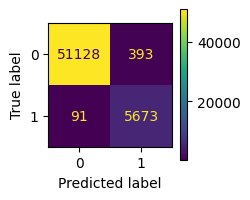

In [63]:
# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_2.predict(pp_data_inputs_test)

# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs_test, predicted_apply_brakes)
finalPrecision = precision_score(pp_data_outputs_test, predicted_apply_brakes)
finalRecall = recall_score(pp_data_outputs_test, predicted_apply_brakes)
finalF1 = f1_score(pp_data_outputs_test, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(pp_data_outputs_test, predicted_apply_brakes)
finalClassificationReport = classification_report(pp_data_outputs_test, predicted_apply_brakes)

# Imprime resultados finais
print(f'******** Resultados dataset sem ruido ********')
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()  

<h1>decision_tree_3</h1>

In [9]:
pp_dataset = pre_processing("DatasetStratified65.csv")
display(pp_dataset) 

pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs) #Entradas

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs) #Saídas

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,190.676084,20.160869,0.650,1.0
1,290.388642,19.938837,0.930,1.0
2,1850.616647,5.037671,0.930,0.0
3,1619.005724,22.157538,0.780,0.0
4,441.238864,19.758767,1.395,0.0
...,...,...,...,...
57280,1340.535167,17.899054,1.395,0.0
57281,1848.422947,8.703425,0.780,0.0
57282,781.489436,18.437710,0.650,0.0
57283,138.397335,23.615608,0.930,1.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,190.676084,20.160869,0.650
1,290.388642,19.938837,0.930
2,1850.616647,5.037671,0.930
3,1619.005724,22.157538,0.780
4,441.238864,19.758767,1.395
...,...,...,...
57280,1340.535167,17.899054,1.395
57281,1848.422947,8.703425,0.780
57282,781.489436,18.437710,0.650
57283,138.397335,23.615608,0.930


,Decisão
0,1.0
1,1.0
2,0.0
3,0.0
4,0.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,1.0


In [135]:
random_state = 1

# Definição dos hiperparâmetros

criterion = ['entropy', 'gini']

splitter = ['best', 'random']

max_depth = [int(x) for x in np.arange(1, 10, step = 2)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 18, step = 3)]

min_samples_leaf = [int(x) for x in np.arange(1, 18, step = 3)]

min_weight_fraction_leaf = [float(x) for x in np.linspace(0,0.5,5)] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(200, 510, step = 10)]
max_leaf_nodes.append(None)

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 
max_features.append('log2')
max_features.append('sqrt')
max_features.append(None)

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500 

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')

Número de combinações possíveis: 691200
{'criterion': ['entropy', 'gini'], 'splitter': ['best', 'random'], 'max_depth': [1, 3, 5, 7, 9], 'min_samples_split': [2, 5, 8, 11, 14, 17], 'min_samples_leaf': [1, 4, 7, 10, 13, 16], 'min_weight_fraction_leaf': [0.0, 0.125, 0.25, 0.375, 0.5], 'max_leaf_nodes': [200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, None], 'max_features': [1, 2, 3, 'log2', 'sqrt', None]}
Tempo estimado de processamento: 178.6 segundos


In [137]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com RandomSearch
dtTries = RandomizedSearchCV(estimator = starting_decision_tree, param_distributions = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 1, n_jobs = -1, n_iter = n_iter)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 2500 candidates, totalling 25000 fits


RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=2500, n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [1, 3, 5, 7, 9],
                                        'max_features': [1, 2, 3, 'log2',
                                                         'sqrt', None],
                                        'max_leaf_nodes': [200, 210, 220, 230,
                                                           240, 250, 260, 270,
                                                           280, 290, 300, 310,
                                                           320, 330, 340, 350,
                                                           360, 370, 380, 390,
                                                           400, 410, 420, 430,
                                                           440, 450, 460, 470,
   

In [139]:
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'splitter': 'best', 'min_weight_fraction_leaf': 0.0, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_leaf_nodes': 490, 'max_features': None, 'max_depth': 9, 'criterion': 'gini'}
10 - Fold Best recall-score:  99.0254280477417


In [142]:
# Segunda iteração

splitter = ['best']

min_weight_fraction_leaf = [0]

min_samples_split = [int(x) for x in np.arange(2, 6, step = 1)]

min_samples_leaf = [int(x) for x in np.arange(1, 5, step = 1)]

max_leaf_nodes = [int(x) for x in np.arange(470, 515, step = 5)]

max_features = [None] 

max_depth = [int(x) for x in np.arange(3, 10, step = 1)]

criterion = ['gini']

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

{'criterion': ['gini'], 'splitter': ['best'], 'max_depth': [3, 4, 5, 6, 7, 8, 9], 'min_samples_split': [2, 3, 4, 5], 'min_samples_leaf': [1, 2, 3, 4], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [470, 475, 480, 485, 490, 495, 500, 505, 510], 'max_features': [None]}


In [144]:
# Optimização dos hiperparâmetros com GridSearch
dtTries = GridSearchCV(estimator = starting_decision_tree, param_grid = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 1, n_jobs = -1)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 1008 candidates, totalling 10080 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini'],
                         'max_depth': [3, 4, 5, 6, 7, 8, 9],
                         'max_features': [None],
                         'max_leaf_nodes': [470, 475, 480, 485, 490, 495, 500,
                                            505, 510],
                         'min_samples_leaf': [1, 2, 3, 4],
                         'min_samples_split': [2, 3, 4, 5],
                         'min_weight_fraction_leaf': [0],
                         'splitter': ['best']},
             scoring='recall', verbose=1)

In [145]:
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'criterion': 'gini', 'max_depth': 8, 'max_features': None, 'max_leaf_nodes': 470, 'min_samples_leaf': 1, 'min_samples_split': 4, 'min_weight_fraction_leaf': 0, 'splitter': 'best'}
10 - Fold Best recall-score:  99.09293851055297


<h2>final_decision_tree_3</h2>

Accuracy: 98.91769224055163
Precision: 98.01859099804305
Recall: 98.93827160493828
F1-Score: 98.4762840992873
[[7326   81]
 [  43 4007]]


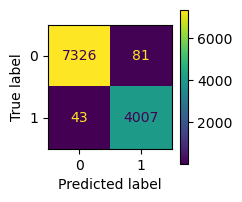

******** Resultados DatasetT1 ********
Accuracy: 98.79200488784149
Precision: 89.89930774071743
Recall: 99.1325468424705
F1-Score: 94.29042904290428
[[50879   642]
 [   50  5714]]


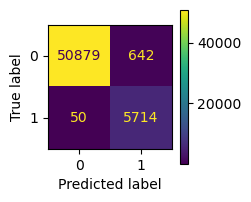

******** Resultados DatasetT2 ********
Accuracy: 98.80597014925372
Precision: 89.96224040276903
Recall: 99.20194309507286
F1-Score: 94.35643564356435
[[50883   638]
 [   46  5718]]


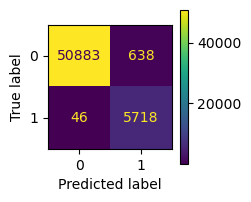

******** Resultados DatasetT3 ********
Accuracy: 98.81818975298944
Precision: 89.98585128124509
Recall: 99.3060374739764
F1-Score: 94.41649484536083
[[50884   637]
 [   40  5724]]


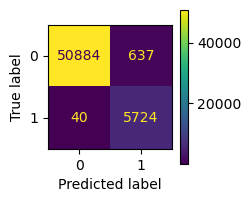

In [10]:
#final_decision_tree_3 = dtTries.best_estimator_

final_decision_tree_3 = DecisionTreeClassifier(criterion = 'gini', 
                                            max_depth = 8, 
                                            max_features = None, 
                                            max_leaf_nodes = 470, 
                                            min_samples_leaf = 1, 
                                            min_samples_split = 4,
                                            min_weight_fraction_leaf = 0, 
                                            splitter = 'best')

# Holdout test
inputsTrain, inputsTest, outputsTrain, outputsTest = train_test_split(pp_data_inputs, 
                                                                      pp_data_outputs,
                                                                      test_size = 0.2) # 20% dos dados para teste, com 50% das saídas sendo 0

final_decision_tree_3.fit(inputsTrain, outputsTrain)

# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_3.predict(inputsTest)

# Métricas de performance
finalAccuracy = accuracy_score(outputsTest, predicted_apply_brakes)
finalPrecision = precision_score(outputsTest, predicted_apply_brakes)
finalRecall = recall_score(outputsTest, predicted_apply_brakes)
finalF1 = f1_score(outputsTest, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(outputsTest, predicted_apply_brakes)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

automatic_test(1, final_decision_tree_3)
automatic_test(2, final_decision_tree_3)
automatic_test(3, final_decision_tree_3)

In [76]:
# Teste para dataset sem ruído 
dataColumns = ['Distancia Ruidosa', 'Velocidade Ruidosa', 'Capacidade de Frenagem Ruidosa', 'Distancia', 'Velocidade', 
                'Capacidade de Frenagem', 'Decisão', 'Aceleracao', 'AW', 'AG', 'VH', 'VC', 'V50', 'DS', 'Decisao Ruidosa', 
                'Aceleracao Ruidosa', 'AW Ruidosa', 'AG Ruidosa', 'VH Ruidosa', 'VC Ruidosa', 'V50 Ruidosa', 'DS Ruidosa']
    
pp_dataset_test = pd.read_csv("DatasetT&VDebug.csv", header = None, names = dataColumns)

pp_data_inputs_test = pp_dataset_test[['Distancia', 'Velocidade', 'Capacidade de Frenagem']]
pp_data_inputs_test = pp_data_inputs_test.rename(columns={"Distancia":"Distância Ruidosa","Velocidade":"Velocidade Ruidosa", "Capacidade de Frenagem":"Capacidade de Frenagem Ruidosa"})

print(pp_data_inputs_test)

pp_data_outputs_test = pp_dataset_test[['Decisão']]

print(pp_data_outputs_test)

       Distância Ruidosa  Velocidade Ruidosa  Capacidade de Frenagem Ruidosa
0                    0.0                 0.0                          1.3950
1                    0.0                 0.0                          1.1625
2                    0.0                 0.0                          0.9300
3                    0.0                 0.0                          0.7800
4                    0.0                 0.0                          0.6500
...                  ...                 ...                             ...
57280             2000.0                28.0                          1.3950
57281             2000.0                28.0                          1.1625
57282             2000.0                28.0                          0.9300
57283             2000.0                28.0                          0.7800
57284             2000.0                28.0                          0.6500

[57285 rows x 3 columns]
       Decisão
0          1.0
1          1.0
2    

******** Resultados dataset sem ruido ********
Accuracy: 99.4815396700707
Precision: 96.25994246065324
Recall: 98.68147120055517
F1-Score: 97.45566692367001
[[51300   221]
 [   76  5688]]


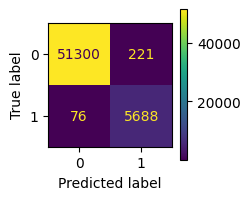

In [77]:
# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_3.predict(pp_data_inputs_test)

# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs_test, predicted_apply_brakes)
finalPrecision = precision_score(pp_data_outputs_test, predicted_apply_brakes)
finalRecall = recall_score(pp_data_outputs_test, predicted_apply_brakes)
finalF1 = f1_score(pp_data_outputs_test, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(pp_data_outputs_test, predicted_apply_brakes)
finalClassificationReport = classification_report(pp_data_outputs_test, predicted_apply_brakes)

# Imprime resultados finais
print(f'******** Resultados dataset sem ruido ********')
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()  

<h1>decision_tree_4</h1>

In [11]:
pp_dataset = pre_processing("DatasetStratified55.csv")

pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs) #Entradas

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs) #Saídas

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,629.046485,10.841248,0.7800
1,1661.711167,8.579126,1.3950
2,1909.676463,26.106402,1.1625
3,1779.527581,20.826739,0.6500
4,428.645448,12.190000,0.9300
...,...,...,...
57280,1671.136424,21.191721,1.1625
57281,148.502272,7.916755,0.9300
57282,960.377975,22.262636,0.9300
57283,157.388917,26.535720,0.7800


,Decisão
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,1.0


In [147]:
random_state = 1

# Definição dos hiperparâmetros

criterion = ['entropy', 'gini']

splitter = ['best', 'random']

max_depth = [int(x) for x in np.arange(1, 9, step = 1)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 18, step = 3)]

min_samples_leaf = [int(x) for x in np.arange(1, 18, step = 3)]

min_weight_fraction_leaf = [float(x) for x in np.linspace(0,0.5,5)] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(200, 510, step = 10)]
max_leaf_nodes.append(None)

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 
max_features.append('log2')
max_features.append('sqrt')
max_features.append(None)

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')

Número de combinações possíveis: 1105920
{'criterion': ['entropy', 'gini'], 'splitter': ['best', 'random'], 'max_depth': [1, 2, 3, 4, 5, 6, 7, 8], 'min_samples_split': [2, 5, 8, 11, 14, 17], 'min_samples_leaf': [1, 4, 7, 10, 13, 16], 'min_weight_fraction_leaf': [0.0, 0.125, 0.25, 0.375, 0.5], 'max_leaf_nodes': [200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, None], 'max_features': [1, 2, 3, 'log2', 'sqrt', None]}
Tempo estimado de processamento: 178.6 segundos


In [148]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com RandomSearch
dtTries = RandomizedSearchCV(estimator = starting_decision_tree, param_distributions = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 1, n_jobs = -1, n_iter = n_iter)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 2500 candidates, totalling 25000 fits


RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=2500, n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [1, 2, 3, 4, 5, 6, 7, 8],
                                        'max_features': [1, 2, 3, 'log2',
                                                         'sqrt', None],
                                        'max_leaf_nodes': [200, 210, 220, 230,
                                                           240, 250, 260, 270,
                                                           280, 290, 300, 310,
                                                           320, 330, 340, 350,
                                                           360, 370, 380, 390,
                                                           400, 410, 420, 430,
                                                           440, 450, 460,

In [149]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'splitter': 'best', 'min_weight_fraction_leaf': 0.0, 'min_samples_split': 11, 'min_samples_leaf': 4, 'max_leaf_nodes': 500, 'max_features': None, 'max_depth': 6, 'criterion': 'gini'}
10 - Fold Best recall-score:  99.21833725206997


In [150]:
# Segunda iteração

splitter = ['best']

min_weight_fraction_leaf = [0] 

min_samples_split = [int(x) for x in np.arange(8, 16, step = 1)]

min_samples_leaf = [int(x) for x in np.arange(2, 7, step = 1)]

max_leaf_nodes = [int(x) for x in np.arange(480, 525, step = 5)]

max_features = [None]

max_depth = [int(x) for x in np.arange(4, 9, step = 1)]

criterion = ['gini']

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

{'criterion': ['gini'], 'splitter': ['best'], 'max_depth': [4, 5, 6, 7, 8], 'min_samples_split': [8, 9, 10, 11, 12, 13, 14, 15], 'min_samples_leaf': [2, 3, 4, 5, 6], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [480, 485, 490, 495, 500, 505, 510, 515, 520], 'max_features': [None]}


In [151]:
# Optimização dos hiperparâmetros com GridSearch
dtTries = GridSearchCV(estimator = starting_decision_tree, param_grid = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 1, n_jobs = -1)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 1800 candidates, totalling 18000 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini'], 'max_depth': [4, 5, 6, 7, 8],
                         'max_features': [None],
                         'max_leaf_nodes': [480, 485, 490, 495, 500, 505, 510,
                                            515, 520],
                         'min_samples_leaf': [2, 3, 4, 5, 6],
                         'min_samples_split': [8, 9, 10, 11, 12, 13, 14, 15],
                         'min_weight_fraction_leaf': [0],
                         'splitter': ['best']},
             scoring='recall', verbose=1)

In [157]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'criterion': 'gini', 'max_depth': 6, 'max_features': None, 'max_leaf_nodes': 480, 'min_samples_leaf': 2, 'min_samples_split': 8, 'min_weight_fraction_leaf': 0, 'splitter': 'best'}
10 - Fold Best recall-score:  99.23720716934893


<h2>final_decision_tree_4</h2>

Accuracy: 98.1670594396439
Precision: 96.84963277928102
Recall: 99.0707789640174
F1-Score: 97.94761532447224
[[6236  163]
 [  47 5011]]


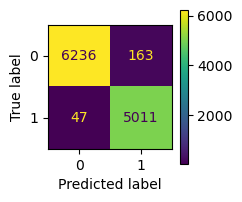

******** Resultados DatasetT1 ********
Accuracy: 97.65383608274418
Precision: 81.48148148148148
Recall: 99.23664122137404
F1-Score: 89.48685857321651
[[50221  1300]
 [   44  5720]]


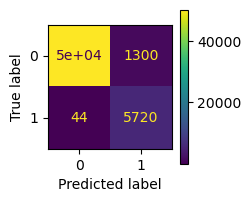

******** Resultados DatasetT2 ********
Accuracy: 97.69224055162783
Precision: 81.73763932552158
Recall: 99.23664122137404
F1-Score: 89.6411220811785
[[50243  1278]
 [   44  5720]]


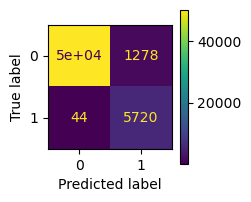

******** Resultados DatasetT3 ********
Accuracy: 97.67478397486254
Precision: 81.65714285714286
Recall: 99.16724496877168
F1-Score: 89.56439987464745
[[50237  1284]
 [   48  5716]]


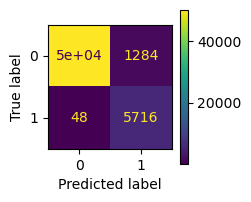

In [12]:
#final_decision_tree_4 = dtTries.best_estimator_

final_decision_tree_4 = DecisionTreeClassifier(criterion = 'gini', 
                                            max_depth = 6, 
                                            max_features = None, 
                                            max_leaf_nodes = 480, 
                                            min_samples_leaf = 2, 
                                            min_samples_split = 8,
                                            min_weight_fraction_leaf = 0, 
                                            splitter = 'best')


# Holdout test
inputsTrain, inputsTest, outputsTrain, outputsTest = train_test_split(pp_data_inputs, 
                                                                      pp_data_outputs,
                                                                      test_size = 0.2) # 20% dos dados para teste, com 50% das saídas sendo 0

final_decision_tree_4.fit(inputsTrain, outputsTrain)

# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_4.predict(inputsTest)

# Métricas de performance
finalAccuracy = accuracy_score(outputsTest, predicted_apply_brakes)
finalPrecision = precision_score(outputsTest, predicted_apply_brakes)
finalRecall = recall_score(outputsTest, predicted_apply_brakes)
finalF1 = f1_score(outputsTest, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(outputsTest, predicted_apply_brakes)

plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 100

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

#plot_tree(final_decision_tree_4)
#plt.show()  

automatic_test(1, final_decision_tree_4)
automatic_test(2, final_decision_tree_4)
automatic_test(3, final_decision_tree_4)

<h1>decision_tree_5</h1>

In [13]:
pp_dataset = pre_processing("DatasetT&V.csv")

pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,0.000000,0.000000,1.3950
1,0.000000,0.000000,1.1625
2,1.579846,0.000000,0.9300
3,0.282185,0.000000,0.7800
4,0.394876,0.000000,0.6500
...,...,...,...
57280,2000.433820,26.977928,1.3950
57281,1999.988138,28.886308,1.1625
57282,1998.246886,28.409583,0.9300
57283,2002.044078,27.358991,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


In [23]:
random_state = 3

# Definição dos hiperparâmetros

criterion = ['entropy', 'gini']

splitter = ['best', 'random']

max_depth = [int(x) for x in np.arange(9, 15, step = 2)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 18, step = 3)]

min_samples_leaf = [int(x) for x in np.arange(1, 18, step = 3)]

min_weight_fraction_leaf = [float(x) for x in np.linspace(0,0.5,5)] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(200, 510, step = 10)]
max_leaf_nodes.append(None)

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 
max_features.append('log2')
max_features.append('sqrt')
max_features.append(None)

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')

Número de combinações possíveis: 414720
{'criterion': ['entropy', 'gini'], 'splitter': ['best', 'random'], 'max_depth': [9, 11, 13], 'min_samples_split': [2, 5, 8, 11, 14, 17], 'min_samples_leaf': [1, 4, 7, 10, 13, 16], 'min_weight_fraction_leaf': [0.0, 0.125, 0.25, 0.375, 0.5], 'max_leaf_nodes': [200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, None], 'max_features': [1, 2, 3, 'log2', 'sqrt', None]}
Tempo estimado de processamento: 178.6 segundos


In [24]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com RandomSearch
dtTries = RandomizedSearchCV(estimator = starting_decision_tree, param_distributions = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1, n_iter = n_iter)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 2500 candidates, totalling 25000 fits


RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=2500, n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [9, 11, 13],
                                        'max_features': [1, 2, 3, 'log2',
                                                         'sqrt', None],
                                        'max_leaf_nodes': [200, 210, 220, 230,
                                                           240, 250, 260, 270,
                                                           280, 290, 300, 310,
                                                           320, 330, 340, 350,
                                                           360, 370, 380, 390,
                                                           400, 410, 420, 430,
                                                           440, 450, 460, 470,
                                                           480, 490, ...],
                                        'min_samples_leaf': [1, 4, 7, 10, 13,
                                                             16],
                                        'min_samples_split': [2, 5, 8, 11, 14,
                                                              17],
                                        'min_weight_fraction_leaf': [0.0, 0.125,
                                                                     0.25,
                                                                     0.375,
                                                                     0.5],
                                        'splitter': ['best', 'random']},
                   scoring='recall', verbose=3)

In [26]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'splitter': 'best', 'min_weight_fraction_leaf': 0.0, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_leaf_nodes': 430, 'max_features': 3, 'max_depth': 11, 'criterion': 'entropy'}
10 - Fold Best recall-score:  96.44122712700083


In [27]:
random_state = 1

# Definição dos hiperparâmetros

criterion = ['entropy']

splitter = ['best']

max_depth = [int(x) for x in np.arange(9, 15, step = 1)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 9, step = 1)]

min_samples_leaf = [int(x) for x in np.arange(1, 4, step = 1)]

min_weight_fraction_leaf = [0] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(390, 480, step = 10)]

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')

Número de combinações possíveis: 3402
{'criterion': ['entropy'], 'splitter': ['best'], 'max_depth': [9, 10, 11, 12, 13, 14], 'min_samples_split': [2, 3, 4, 5, 6, 7, 8], 'min_samples_leaf': [1, 2, 3], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [390, 400, 410, 420, 430, 440, 450, 460, 470], 'max_features': [1, 2, 3]}
Tempo estimado de processamento: 178.6 segundos


In [28]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com GridSearch
dtTries = GridSearchCV(estimator = starting_decision_tree, param_grid = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 3402 candidates, totalling 34020 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['entropy'],
                         'max_depth': [9, 10, 11, 12, 13, 14],
                         'max_features': [1, 2, 3],
                         'max_leaf_nodes': [390, 400, 410, 420, 430, 440, 450,
                                            460, 470],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4, 5, 6, 7, 8],
                         'min_weight_fraction_leaf': [0],
                         'splitter': ['best']},
             scoring='recall', verbose=3)

In [29]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'criterion': 'entropy', 'max_depth': 13, 'max_features': 2, 'max_leaf_nodes': 470, 'min_samples_leaf': 3, 'min_samples_split': 4, 'min_weight_fraction_leaf': 0, 'splitter': 'best'}
10 - Fold Best recall-score:  96.47316879650599


<h2>final_decision_tree_5</h2>

Accuracy: 99.35410665968404
Precision: 96.66966696669667
Recall: 96.66966696669667
F1-Score: 96.66966696669667
[[10309    37]
 [   37  1074]]


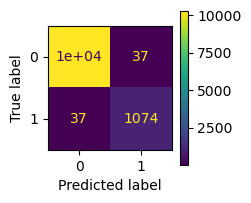

******** Resultados DatasetT1 ********
Accuracy: 99.36632626341975
Precision: 97.10448281876853
Recall: 96.58223455933378
F1-Score: 96.84265460554927
[[51355   166]
 [  197  5567]]


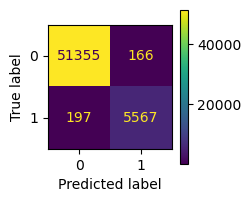

******** Resultados DatasetT2 ********
Accuracy: 99.30348258706468
Precision: 96.64406190227787
Recall: 96.42609299097849
F1-Score: 96.53495440729483
[[51328   193]
 [  206  5558]]


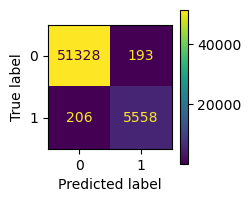

******** Resultados DatasetT3 ********
Accuracy: 99.34886968665445
Precision: 97.11588883062402
Recall: 96.39139486467731
F1-Score: 96.75228558989988
[[51356   165]
 [  208  5556]]


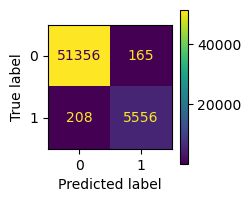

In [14]:
#final_decision_tree_5 = dtTries.best_estimator_

final_decision_tree_5 = DecisionTreeClassifier(criterion = 'entropy', 
                                            max_depth = 13, 
                                            max_features = 2, 
                                            max_leaf_nodes = 470, 
                                            min_samples_leaf = 3, 
                                            min_samples_split = 4,
                                            min_weight_fraction_leaf = 0, 
                                            splitter = 'best')


# Holdout test
inputsTrain, inputsTest, outputsTrain, outputsTest = train_test_split(pp_data_inputs, 
                                                                      pp_data_outputs,
                                                                      test_size = 0.2) # 20% dos dados para teste, com 50% das saídas sendo 0

final_decision_tree_5.fit(inputsTrain, outputsTrain)

# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_5.predict(inputsTest)

# Métricas de performance
finalAccuracy = accuracy_score(outputsTest, predicted_apply_brakes)
finalPrecision = precision_score(outputsTest, predicted_apply_brakes)
finalRecall = recall_score(outputsTest, predicted_apply_brakes)
finalF1 = f1_score(outputsTest, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(outputsTest, predicted_apply_brakes)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 100

automatic_test(1, final_decision_tree_5)
automatic_test(2, final_decision_tree_5)
automatic_test(3, final_decision_tree_5)

<h1>decision_tree_6</h1>

In [15]:
pp_dataset = pre_processing("DatasetT&V2.csv")

pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,1.426390,0.000000,1.3950
1,0.247126,0.000000,1.1625
2,1.318730,0.000000,0.9300
3,0.000000,0.000000,0.7800
4,1.181601,0.000000,0.6500
...,...,...,...
57280,1998.258208,27.787054,1.3950
57281,2001.582818,27.545077,1.1625
57282,2000.103125,29.680000,0.9300
57283,2001.308140,28.895288,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


In [18]:
random_state = None
# Definição dos hiperparâmetros

criterion = ['entropy', 'gini']

splitter = ['best', 'random']

max_depth = [int(x) for x in np.arange(5, 10, step = 1)] # Limite para compilação

min_samples_split = [int(x) for x in np.arange(2, 18, step = 3)]

min_samples_leaf = [int(x) for x in np.arange(1, 18, step = 3)]

max_leaf_nodes = [int(x) for x in np.arange(200, 510, step = 10)]
max_leaf_nodes.append(None)

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 
max_features.append('log2')
max_features.append('sqrt')
max_features.append(None)

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')



Número de combinações possíveis: 138240
{'criterion': ['entropy', 'gini'], 'splitter': ['best', 'random'], 'max_depth': [5, 6, 7, 8, 9], 'min_samples_split': [2, 5, 8, 11, 14, 17], 'min_samples_leaf': [1, 4, 7, 10, 13, 16], 'max_leaf_nodes': [200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, None], 'max_features': [1, 2, 3, 'log2', 'sqrt', None]}
Tempo estimado de processamento: 178.6 segundos


In [19]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com RandomSearch
dtTries = RandomizedSearchCV(estimator = starting_decision_tree, param_distributions = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1, n_iter = n_iter)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 2500 candidates, totalling 25000 fits
[CV 1/10] END criterion=entropy, max_depth=9, max_features=3, max_leaf_nodes=350, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.782 total time=   0.1s
[CV 9/10] END criterion=entropy, max_depth=9, max_features=3, max_leaf_nodes=350, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.845 total time=   0.0s
[CV 10/10] END criterion=entropy, max_depth=9, max_features=3, max_leaf_nodes=350, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.940 total time=   0.0s
[CV 3/10] END criterion=entropy, max_depth=9, max_features=3, max_leaf_nodes=350, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.886 total time=   0.1s
[CV 1/10] END criterion=gini, max_depth=6, max_features=sqrt, max_leaf_nodes=None, min_samples_leaf=13, min_samples_split=11, splitter=random;, score=0.018 total time=   0.0s
[CV 2/10] END criterion=gini, max_depth=6, max_features=sqrt, max_lea

RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=2500, n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [5, 6, 7, 8, 9],
                                        'max_features': [1, 2, 3, 'log2',
                                                         'sqrt', None],
                                        'max_leaf_nodes': [200, 210, 220, 230,
                                                           240, 250, 260, 270,
                                                           280, 290, 300, 310,
                                                           320, 330, 340, 350,
                                                           360, 370, 380, 390,
                                                           400, 410, 420, 430,
                                                           440, 450, 460, 470,
   

In [20]:

# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'splitter': 'best', 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_leaf_nodes': 410, 'max_features': 3, 'max_depth': 9, 'criterion': 'gini'}
10 - Fold Best recall-score:  95.6906481655242


In [21]:
random_state = 1

# Definição dos hiperparâmetros

criterion = ['gini']

splitter = ['best']

max_depth = [int(x) for x in np.arange(7, 12, step = 1)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(6, 12, step = 1)]

min_samples_leaf = [int(x) for x in np.arange(1, 4, step = 1)]

min_weight_fraction_leaf = [0] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(380, 460, step = 10)]

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')

Número de combinações possíveis: 2160
{'criterion': ['gini'], 'splitter': ['best'], 'max_depth': [7, 8, 9, 10, 11], 'min_samples_split': [6, 7, 8, 9, 10, 11], 'min_samples_leaf': [1, 2, 3], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [380, 390, 400, 410, 420, 430, 440, 450], 'max_features': [1, 2, 3]}
Tempo estimado de processamento: 178.6 segundos


In [22]:

# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com GridSearch
dtTries = GridSearchCV(estimator = starting_decision_tree, param_grid = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)

Fitting 10 folds for each of 2160 candidates, totalling 21600 fits
[CV 2/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=380, min_samples_leaf=1, min_samples_split=6, min_weight_fraction_leaf=0, splitter=best;, score=0.920 total time=   0.1s
[CV 1/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=380, min_samples_leaf=1, min_samples_split=6, min_weight_fraction_leaf=0, splitter=best;, score=0.762 total time=   0.1s
[CV 3/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=380, min_samples_leaf=1, min_samples_split=6, min_weight_fraction_leaf=0, splitter=best;, score=0.883 total time=   0.1s
[CV 5/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=380, min_samples_leaf=1, min_samples_split=6, min_weight_fraction_leaf=0, splitter=best;, score=0.867 total time=   0.1s
[CV 7/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=380, min_samples_leaf=1, min_samples_split=6, min_weight_fraction_leaf=0, split

GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini'], 'max_depth': [7, 8, 9, 10, 11],
                         'max_features': [1, 2, 3],
                         'max_leaf_nodes': [380, 390, 400, 410, 420, 430, 440,
                                            450],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [6, 7, 8, 9, 10, 11],
                         'min_weight_fraction_leaf': [0],
                         'splitter': ['best']},
             scoring='recall', verbose=3)

In [23]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'criterion': 'gini', 'max_depth': 9, 'max_features': 3, 'max_leaf_nodes': 410, 'min_samples_leaf': 3, 'min_samples_split': 6, 'min_weight_fraction_leaf': 0, 'splitter': 'best'}
10 - Fold Best recall-score:  96.20637774985866


<h2>final_decision_tree_6</h2>

Accuracy: 99.17954089203107
Precision: 96.27118644067797
Recall: 95.78414839797638
F1-Score: 96.02704987320372
[[10227    44]
 [   50  1136]]


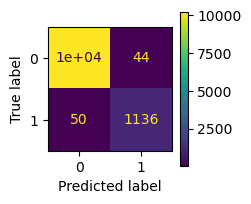

******** Resultados DatasetT1 ********
Accuracy: 99.32443047918304
Precision: 96.96069868995633
Recall: 96.30464954892436
F1-Score: 96.63156062320482
[[51347   174]
 [  213  5551]]


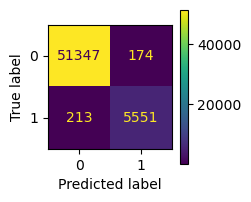

******** Resultados DatasetT2 ********
Accuracy: 99.31395653312386
Precision: 96.85918687838073
Recall: 96.30464954892436
F1-Score: 96.58112222705525
[[51341   180]
 [  213  5551]]


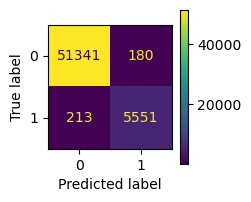

******** Resultados DatasetT3 ********
Accuracy: 99.28951732565244
Precision: 96.7533600977483
Recall: 96.16585704371964
F1-Score: 96.45871399982597
[[51335   186]
 [  221  5543]]


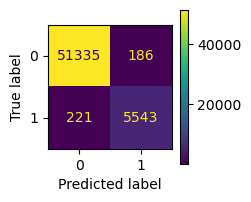

In [16]:
#final_decision_tree_6 = dtTries.best_estimator_

final_decision_tree_6 = DecisionTreeClassifier(criterion = 'gini', 
                                            max_depth = 9, 
                                            max_features = 3, 
                                            max_leaf_nodes = 410, 
                                            min_samples_leaf = 3, 
                                            min_samples_split = 6,
                                            min_weight_fraction_leaf = 0, 
                                            splitter = 'best')


# Holdout test
inputsTrain, inputsTest, outputsTrain, outputsTest = train_test_split(pp_data_inputs, 
                                                                      pp_data_outputs,
                                                                      test_size = 0.2) # 20% dos dados para teste, com 50% das saídas sendo 0

final_decision_tree_6.fit(inputsTrain, outputsTrain)

# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_6.predict(inputsTest)

# Métricas de performance
finalAccuracy = accuracy_score(outputsTest, predicted_apply_brakes)
finalPrecision = precision_score(outputsTest, predicted_apply_brakes)
finalRecall = recall_score(outputsTest, predicted_apply_brakes)
finalF1 = f1_score(outputsTest, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(outputsTest, predicted_apply_brakes)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 100

automatic_test(1, final_decision_tree_6)
automatic_test(2, final_decision_tree_6)
automatic_test(3, final_decision_tree_6)

<h1>decision_tree_7</h1>

In [17]:
pp_dataset = pre_processing("DatasetStratified80v2.csv")

pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,1988.706008,27.661945,1.1625
1,1951.376805,28.481030,1.3950
2,902.057984,14.818392,0.6500
3,471.638365,15.694182,1.3950
4,1960.458622,5.904616,0.9300
...,...,...,...
57280,477.714702,16.595143,0.6500
57281,191.283960,15.690130,0.7800
57282,179.876135,11.504720,1.1625
57283,790.979597,0.514615,0.9300


,Decisão
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
57280,0.0
57281,1.0
57282,0.0
57283,0.0


In [28]:
random_state = None

# Definição dos hiperparâmetros

criterion = ['entropy', 'gini']

splitter = ['best', 'random']

max_depth = [int(x) for x in np.arange(5, 11, step = 1)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 18, step = 3)]

min_samples_leaf = [int(x) for x in np.arange(1, 18, step = 3)]

min_weight_fraction_leaf = [0] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(200, 510, step = 10)]
max_leaf_nodes.append(None)

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 
max_features.append('log2')
max_features.append('sqrt')
max_features.append(None)

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')


Número de combinações possíveis: 165888
{'criterion': ['entropy', 'gini'], 'splitter': ['best', 'random'], 'max_depth': [5, 6, 7, 8, 9, 10], 'min_samples_split': [2, 5, 8, 11, 14, 17], 'min_samples_leaf': [1, 4, 7, 10, 13, 16], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, None], 'max_features': [1, 2, 3, 'log2', 'sqrt', None]}
Tempo estimado de processamento: 178.6 segundos


In [29]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com RandomSearch
dtTries = RandomizedSearchCV(estimator = starting_decision_tree, param_distributions = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1, n_iter = n_iter)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)


Fitting 10 folds for each of 2500 candidates, totalling 25000 fits
[CV 1/10] END criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=250, min_samples_leaf=4, min_samples_split=11, min_weight_fraction_leaf=0, splitter=random;, score=0.979 total time=   0.0s
[CV 2/10] END criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=250, min_samples_leaf=4, min_samples_split=11, min_weight_fraction_leaf=0, splitter=random;, score=0.921 total time=   0.0s
[CV 6/10] END criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=250, min_samples_leaf=4, min_samples_split=11, min_weight_fraction_leaf=0, splitter=random;, score=0.951 total time=   0.0s
[CV 5/10] END criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=250, min_samples_leaf=4, min_samples_split=11, min_weight_fraction_leaf=0, splitter=random;, score=0.949 total time=   0.0s
[CV 4/10] END criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=250, min_samples_leaf=4, min_samples_

RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=2500, n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [5, 6, 7, 8, 9, 10],
                                        'max_features': [1, 2, 3, 'log2',
                                                         'sqrt', None],
                                        'max_leaf_nodes': [200, 210, 220, 230,
                                                           240, 250, 260, 270,
                                                           280, 290, 300, 310,
                                                           320, 330, 340, 350,
                                                           360, 370, 380, 390,
                                                           400, 410, 420, 430,
                                                           440, 450, 460, 470,

In [30]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'splitter': 'best', 'min_weight_fraction_leaf': 0, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_leaf_nodes': 400, 'max_features': 3, 'max_depth': 9, 'criterion': 'gini'}
10 - Fold Best recall-score:  97.72879684694698


In [36]:
random_state = 1

# Definição dos hiperparâmetros

criterion = ['gini']

splitter = ['best']

max_depth = [int(x) for x in np.arange(7, 11, step = 1)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 5, step = 1)]
min_samples_split.append(float(1))

min_samples_leaf = [int(x) for x in np.arange(1, 4, step = 1)]

min_weight_fraction_leaf = [0] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(370, 440, step = 10)]

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')


Número de combinações possíveis: 1008
{'criterion': ['gini'], 'splitter': ['best'], 'max_depth': [7, 8, 9, 10], 'min_samples_split': [2, 3, 4, 1.0], 'min_samples_leaf': [1, 2, 3], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [370, 380, 390, 400, 410, 420, 430], 'max_features': [1, 2, 3]}
Tempo estimado de processamento: 178.6 segundos


In [37]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com GridSearch
dtTries = GridSearchCV(estimator = starting_decision_tree, param_grid = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)


Fitting 10 folds for each of 1008 candidates, totalling 10080 fits
[CV 2/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0, splitter=best;, score=0.951 total time=   0.1s
[CV 4/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0, splitter=best;, score=0.933 total time=   0.1s
[CV 3/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0, splitter=best;, score=0.921 total time=   0.1s
[CV 1/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0, splitter=best;, score=0.949 total time=   0.1s
[CV 6/10] END criterion=gini, max_depth=7, max_features=1, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0, split

GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini'], 'max_depth': [7, 8, 9, 10],
                         'max_features': [1, 2, 3],
                         'max_leaf_nodes': [370, 380, 390, 400, 410, 420, 430],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4, 1.0],
                         'min_weight_fraction_leaf': [0],
                         'splitter': ['best']},
             scoring='recall', verbose=3)

In [38]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)

{'criterion': 'gini', 'max_depth': 9, 'max_features': 3, 'max_leaf_nodes': 370, 'min_samples_leaf': 3, 'min_samples_split': 4, 'min_weight_fraction_leaf': 0, 'splitter': 'best'}
10 - Fold Best recall-score:  97.91104922634763


<h2>final_decision_tree_7</h2>

Accuracy: 98.99624683599546
Precision: 97.25557461406518
Recall: 97.80077619663649
F1-Score: 97.52741345947108
[[9074   64]
 [  51 2268]]


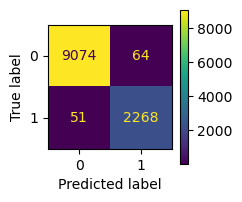

******** Resultados DatasetT1 ********
Accuracy: 99.30173692938816
Precision: 94.87951807228916
Recall: 98.36918806384455
F1-Score: 96.59284497444635
[[51215   306]
 [   94  5670]]


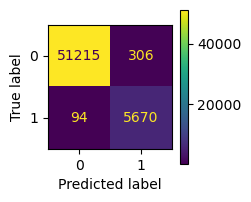

******** Resultados DatasetT2 ********
Accuracy: 99.26158680282796
Precision: 94.59008181666388
Recall: 98.2824427480916
F1-Score: 96.40091891431976
[[51197   324]
 [   99  5665]]


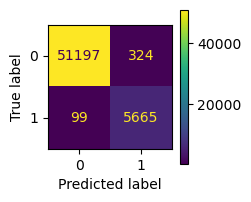

******** Resultados DatasetT3 ********
Accuracy: 99.26158680282796
Precision: 94.53059863264966
Recall: 98.35183900069396
F1-Score: 96.4033670606241
[[51193   328]
 [   95  5669]]


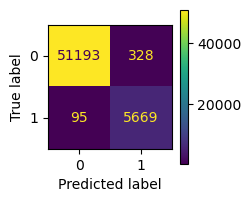

In [18]:
#final_decision_tree_7 = dtTries.best_estimator_

final_decision_tree_7 = DecisionTreeClassifier(criterion = 'gini', 
                                            max_depth = 9, 
                                            max_features = 3, 
                                            max_leaf_nodes = 370, 
                                            min_samples_leaf = 3, 
                                            min_samples_split = 4,
                                            min_weight_fraction_leaf = 0, 
                                            splitter = 'best')


# Holdout test
inputsTrain, inputsTest, outputsTrain, outputsTest = train_test_split(pp_data_inputs, 
                                                                      pp_data_outputs,
                                                                      test_size = 0.2) # 20% dos dados para teste, com 50% das saídas sendo 0

final_decision_tree_7.fit(inputsTrain, outputsTrain)

# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_7.predict(inputsTest)

# Métricas de performance
finalAccuracy = accuracy_score(outputsTest, predicted_apply_brakes)
finalPrecision = precision_score(outputsTest, predicted_apply_brakes)
finalRecall = recall_score(outputsTest, predicted_apply_brakes)
finalF1 = f1_score(outputsTest, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(outputsTest, predicted_apply_brakes)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 100

automatic_test(1, final_decision_tree_7)
automatic_test(2, final_decision_tree_7)
automatic_test(3, final_decision_tree_7)

<h1>decision_tree_8</h1>

In [19]:
pp_dataset = pre_processing("DatasetStratified50.csv")

pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,20.541409,4.403611,1.3950
1,0.000000,1.503059,1.1625
2,8.315942,11.130000,1.3950
3,229.223089,26.364614,1.3950
4,301.600644,27.019522,1.1625
...,...,...,...
57280,128.902174,22.820830,1.3950
57281,129.577958,26.238299,0.9300
57282,51.278493,11.479303,0.6500
57283,728.433355,10.928530,0.9300


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,1.0
57281,1.0
57282,1.0
57283,0.0


In [43]:
random_state = None

# Definição dos hiperparâmetros

criterion = ['entropy', 'gini']

splitter = ['best', 'random']

max_depth = [int(x) for x in np.arange(5, 11, step = 1)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 18, step = 3)]

min_samples_leaf = [int(x) for x in np.arange(1, 18, step = 3)]

min_weight_fraction_leaf = [0] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(200, 510, step = 10)]
max_leaf_nodes.append(None)

max_features = [int(x) for x in np.arange(1, 4, step = 1)] 
max_features.append('log2')
max_features.append('sqrt')
max_features.append(None)

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')


Número de combinações possíveis: 165888
{'criterion': ['entropy', 'gini'], 'splitter': ['best', 'random'], 'max_depth': [5, 6, 7, 8, 9, 10], 'min_samples_split': [2, 5, 8, 11, 14, 17], 'min_samples_leaf': [1, 4, 7, 10, 13, 16], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, None], 'max_features': [1, 2, 3, 'log2', 'sqrt', None]}
Tempo estimado de processamento: 178.6 segundos


In [44]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com RandomSearch
dtTries = RandomizedSearchCV(estimator = starting_decision_tree, param_distributions = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1, n_iter = n_iter)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)


Fitting 10 folds for each of 2500 candidates, totalling 25000 fits
[CV 5/10] END criterion=entropy, max_depth=7, max_features=None, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0, splitter=best;, score=0.997 total time=   0.2s
[CV 6/10] END criterion=entropy, max_depth=7, max_features=None, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0, splitter=best;, score=0.992 total time=   0.2s
[CV 1/10] END criterion=entropy, max_depth=7, max_features=None, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0, splitter=best;, score=0.996 total time=   0.2s
[CV 2/10] END criterion=entropy, max_depth=7, max_features=None, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0, splitter=best;, score=0.994 total time=   0.2s
[CV 3/10] END criterion=entropy, max_depth=7, max_features=None, max_leaf_nodes=370, min_samples_leaf=1, min_samples_split=5, min

RandomizedSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=2500, n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [5, 6, 7, 8, 9, 10],
                                        'max_features': [1, 2, 3, 'log2',
                                                         'sqrt', None],
                                        'max_leaf_nodes': [200, 210, 220, 230,
                                                           240, 250, 260, 270,
                                                           280, 290, 300, 310,
                                                           320, 330, 340, 350,
                                                           360, 370, 380, 390,
                                                           400, 410, 420, 430,
                                                           440, 450, 460, 470,

In [45]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)


{'splitter': 'best', 'min_weight_fraction_leaf': 0, 'min_samples_split': 2, 'min_samples_leaf': 7, 'max_leaf_nodes': 280, 'max_features': None, 'max_depth': 8, 'criterion': 'entropy'}
10 - Fold Best recall-score:  99.58785508689522


In [47]:
random_state = 1

# Definição dos hiperparâmetros

criterion = ['entropy']

splitter = ['best']

max_depth = [int(x) for x in np.arange(3, 9, step = 1)] # max_depth já foi limitado

min_samples_split = [int(x) for x in np.arange(2, 5, step = 1)]

min_samples_leaf = [int(x) for x in np.arange(5, 10, step = 1)]

min_weight_fraction_leaf = [0] # Ajustado o intervalo, o peso máximo aceito é 0.5, entretanto todas as RSearch dão 0

max_leaf_nodes = [int(x) for x in np.arange(250, 320, step = 10)]

max_features = [None] 

combinations = len(criterion)*len(splitter)*len(max_depth)*len(min_samples_leaf)*len(min_samples_split)*len(min_weight_fraction_leaf)*len(max_leaf_nodes)*len(max_features)

print('Número de combinações possíveis:', combinations)

hyperparameters_settings = {'criterion'                : criterion,
                            'splitter'                 : splitter,
                            'max_depth'                : max_depth,
                            'min_samples_split'        : min_samples_split,
                            'min_samples_leaf'         : min_samples_leaf,
                            'min_weight_fraction_leaf' : min_weight_fraction_leaf,
                            'max_leaf_nodes'           : max_leaf_nodes,
                            'max_features'             : max_features
                           }

print(hyperparameters_settings)

# Metrica de performance
scoring = 'recall'

# Número de partições
k_fold = 10 

# Número de iterações
n_iter = 2500

print('Tempo estimado de processamento:', round((n_iter*10)/140,1), 'segundos')


Número de combinações possíveis: 630
{'criterion': ['entropy'], 'splitter': ['best'], 'max_depth': [3, 4, 5, 6, 7, 8], 'min_samples_split': [2, 3, 4], 'min_samples_leaf': [5, 6, 7, 8, 9], 'min_weight_fraction_leaf': [0], 'max_leaf_nodes': [250, 260, 270, 280, 290, 300, 310], 'max_features': [None]}
Tempo estimado de processamento: 178.6 segundos


In [48]:
# Criação da árvore de decisão
starting_decision_tree = DecisionTreeClassifier()

# Optimização dos hiperparâmetros com GridSearch
dtTries = GridSearchCV(estimator = starting_decision_tree, param_grid = hyperparameters_settings, scoring = scoring,
                            cv = KFold(n_splits = k_fold, shuffle = True), verbose = 3, n_jobs = -1)

# Teste com os hiperparâmetros encontrados
dtTries.fit(pp_data_inputs, pp_data_outputs)


Fitting 10 folds for each of 630 candidates, totalling 6300 fits
[CV 6/10] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=250, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0, splitter=best;, score=0.998 total time=   0.1s
[CV 4/10] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=250, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0, splitter=best;, score=0.998 total time=   0.1s
[CV 2/10] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=250, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0, splitter=best;, score=0.998 total time=   0.2s
[CV 7/10] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=250, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0, splitter=best;, score=0.996 total time=   0.1s
[CV 8/10] END criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=250, min_samples_leaf=5, min_samples_split=2, min_w

GridSearchCV(cv=KFold(n_splits=10, random_state=None, shuffle=True),
             estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['entropy'],
                         'max_depth': [3, 4, 5, 6, 7, 8],
                         'max_features': [None],
                         'max_leaf_nodes': [250, 260, 270, 280, 290, 300, 310],
                         'min_samples_leaf': [5, 6, 7, 8, 9],
                         'min_samples_split': [2, 3, 4],
                         'min_weight_fraction_leaf': [0],
                         'splitter': ['best']},
             scoring='recall', verbose=3)

In [49]:
# Imprime valores ótimos dos hiperparâmetros
print(dtTries.best_params_)
print(k_fold,'- Fold Best recall-score: ', dtTries.best_score_*100)


{'criterion': 'entropy', 'max_depth': 3, 'max_features': None, 'max_leaf_nodes': 250, 'min_samples_leaf': 5, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0, 'splitter': 'best'}
10 - Fold Best recall-score:  99.66140014817665


<h2>final_decision_tree_8</h2>

Accuracy: 95.07724535218644
Precision: 91.11146959186965
Recall: 99.770358593888
F1-Score: 95.24451939291737
[[5245  551]
 [  13 5648]]


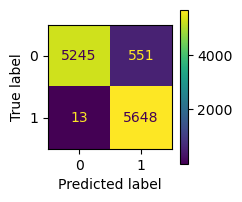

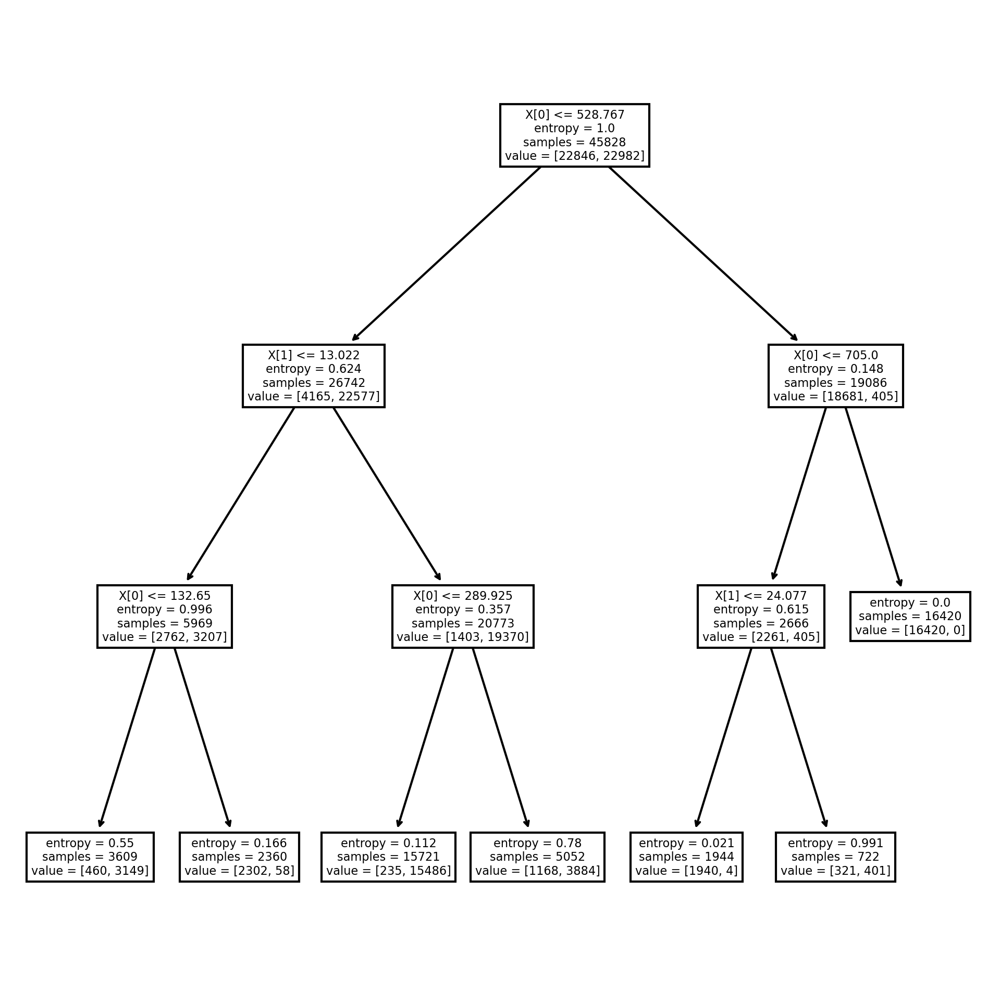

******** Resultados DatasetT1 ********
Accuracy: 91.3467748974426
Precision: 53.77420260031802
Recall: 99.73976405274115
F1-Score: 69.87541780613795
[[46579  4942]
 [   15  5749]]


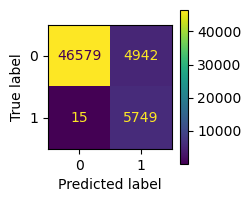

******** Resultados DatasetT2 ********
Accuracy: 91.35375752814873
Precision: 53.79432955927763
Recall: 99.73976405274115
F1-Score: 69.8924077563674
[[46583  4938]
 [   15  5749]]


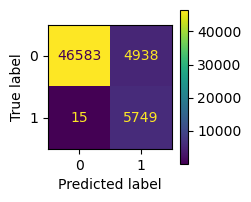

******** Resultados DatasetT3 ********
Accuracy: 91.34153792441302
Precision: 53.76052385406922
Recall: 99.70506592643997
F1-Score: 69.85535432113771
[[46578  4943]
 [   17  5747]]


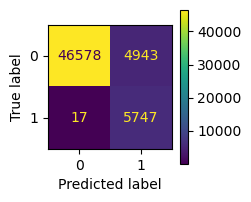

In [20]:
#final_decision_tree_8 = dtTries.best_estimator_

final_decision_tree_8 = DecisionTreeClassifier(criterion = 'entropy', 
                                            max_depth = 3, 
                                            max_features = None, 
                                            max_leaf_nodes = 250, 
                                            min_samples_leaf = 5, 
                                            min_samples_split = 2,
                                            min_weight_fraction_leaf = 0, 
                                            splitter = 'best')


# Holdout test
inputsTrain, inputsTest, outputsTrain, outputsTest = train_test_split(pp_data_inputs, 
                                                                      pp_data_outputs,
                                                                      test_size = 0.2) # 20% dos dados para teste, com 50% das saídas sendo 0

final_decision_tree_8.fit(inputsTrain, outputsTrain)

# Valores preditos pela árvore treinada
predicted_apply_brakes = final_decision_tree_8.predict(inputsTest)

# Métricas de performance
finalAccuracy = accuracy_score(outputsTest, predicted_apply_brakes)
finalPrecision = precision_score(outputsTest, predicted_apply_brakes)
finalRecall = recall_score(outputsTest, predicted_apply_brakes)
finalF1 = f1_score(outputsTest, predicted_apply_brakes)
finalConfusionMatrix = confusion_matrix(outputsTest, predicted_apply_brakes)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)

plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 100

ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.dpi'] = 300

plot_tree(final_decision_tree_8)
plt.show()  

plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 100

automatic_test(1, final_decision_tree_8)
automatic_test(2, final_decision_tree_8)
automatic_test(3, final_decision_tree_8)

<h1>voting</h1>

In [21]:
# Realiza a leitura do arquivo CSV
# O arquivo se encontra numa pasta dentro do diretório deste programa:
# ./Árvore de Decisão/Dataset/Dataset.csv
pp_dataset = pre_processing("DatasetT3.csv")
print(pp_dataset)

#Define as entradas e as saídas do dataset
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
print(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
print(pp_data_outputs)

       Distância Ruidosa  Velocidade Ruidosa  Capacidade de Frenagem Ruidosa  \
0               0.504450            0.000000                          1.3950   
1               0.000000            0.000000                          1.1625   
2               0.000000            0.000000                          0.9300   
3               1.158221            0.000000                          0.7800   
4               0.156073            0.000000                          0.6500   
...                  ...                 ...                             ...   
57280        1998.864111           26.913394                          1.3950   
57281        1998.304338           27.914276                          1.1625   
57282        1999.635227           27.073422                          0.9300   
57283        1999.776292           27.574239                          0.7800   
57284        1999.379985           28.009829                          0.6500   

       Decisão  
0          1.0  
1    

<h2> using max_depth = 16</h2>

In [22]:
decision_trees = [final_decision_tree_1, final_decision_tree_3, final_decision_tree_4]

pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

final_prediction = voting("DatasetT3.csv", decision_trees)

Accuracy: 98.95435105175875
Precision: 91.12916069437809
Recall: 99.27133934767522
F1-Score: 95.0261562733538
[[50964   557]
 [   42  5722]]


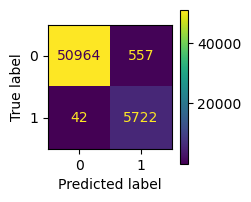

In [23]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_prediction)
finalPrecision = precision_score(pp_data_outputs, final_prediction)
finalRecall = recall_score(pp_data_outputs, final_prediction)
finalF1 = f1_score(pp_data_outputs, final_prediction)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_prediction)
finalClassificationReport = classification_report(pp_data_outputs, final_prediction)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

<h2> using max_depth = 13</h2>

In [24]:
decision_trees = [final_decision_tree_5, final_decision_tree_3, final_decision_tree_4]

pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

final_prediction = voting("DatasetT3.csv", decision_trees)

Accuracy: 98.9752989438771
Precision: 91.30365406095422
Recall: 99.27133934767522
F1-Score: 95.12093757792371
[[50976   545]
 [   42  5722]]


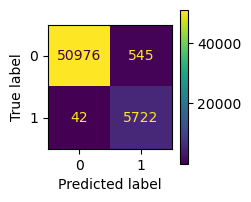

In [25]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_prediction)
finalPrecision = precision_score(pp_data_outputs, final_prediction)
finalRecall = recall_score(pp_data_outputs, final_prediction)
finalF1 = f1_score(pp_data_outputs, final_prediction)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_prediction)
finalClassificationReport = classification_report(pp_data_outputs, final_prediction)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

<h2>using max_depth <= 10</h2>

In [26]:
decision_trees = [final_decision_tree_2, final_decision_tree_3, final_decision_tree_4]

pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

final_prediction = voting("DatasetT3.csv", decision_trees)

Accuracy: 98.75360041895784
Precision: 89.26905132192846
Recall: 99.58362248438584
F1-Score: 94.1446613088404
[[50831   690]
 [   24  5740]]


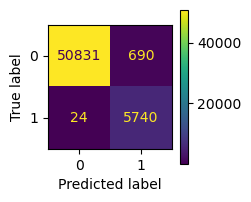

In [27]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_prediction)
finalPrecision = precision_score(pp_data_outputs, final_prediction)
finalRecall = recall_score(pp_data_outputs, final_prediction)
finalF1 = f1_score(pp_data_outputs, final_prediction)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_prediction)
finalClassificationReport = classification_report(pp_data_outputs, final_prediction)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

In [28]:
decision_trees = [final_decision_tree_6, final_decision_tree_7, final_decision_tree_8]

pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

final_prediction = voting("DatasetT3.csv", decision_trees)

Accuracy: 99.24413022606267
Precision: 93.80443714050945
Recall: 99.02845246356696
F1-Score: 96.34568318001519
[[51144   377]
 [   56  5708]]


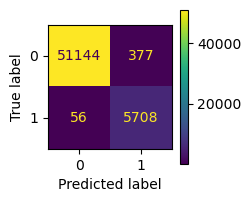

In [29]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_prediction)
finalPrecision = precision_score(pp_data_outputs, final_prediction)
finalRecall = recall_score(pp_data_outputs, final_prediction)
finalF1 = f1_score(pp_data_outputs, final_prediction)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_prediction)
finalClassificationReport = classification_report(pp_data_outputs, final_prediction)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

<h2>all together, dt_id = [2,3,4,6,7,8]</h2>

In [30]:
decision_trees = [final_decision_tree_2, final_decision_tree_3, final_decision_tree_4, final_decision_tree_6, final_decision_tree_7, final_decision_tree_8]

pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

final_prediction = voting("DatasetT3.csv", decision_trees)

Accuracy: 99.23540193768002
Precision: 93.62712975098296
Recall: 99.1498959056211
F1-Score: 96.30940343781597
[[51132   389]
 [   49  5715]]


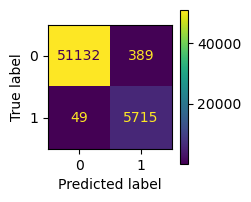

In [31]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_prediction)
finalPrecision = precision_score(pp_data_outputs, final_prediction)
finalRecall = recall_score(pp_data_outputs, final_prediction)
finalF1 = f1_score(pp_data_outputs, final_prediction)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_prediction)
finalClassificationReport = classification_report(pp_data_outputs, final_prediction)

# Imprime resultados finais
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

<h1>conifer</h1>

In [32]:
import conifer
import datetime
import logging
import sys
from conifer.converters.sklearn import convert

In [33]:
#Função responsável por criar uma floresta aleatória utilizando uma lista de árvores de decisão
def convert_tree_to_random_forest(dt_arr, rf):
    depths = [tree.max_depth for tree in dt_arr]
    features = [tree.n_features_in_ for tree in dt_arr]
    classes = [tree.n_classes_ for tree in dt_arr]
    rf.max_depth = int(max(depths))
    rf.n_estimators = len(dt_arr)
    rf.n_features_in_ = int(max(features))
    rf.n_classes_ = int(max(classes))
    for i in range(len(dt_arr)):
        rf.estimators_[i] = dt_arr[i]
    return rf

<h2>FPGA_1</h2>

In [34]:
pp_dataset = pre_processing("DatasetT&V.csv")
display(pp_dataset)

#Define as entradas e as saídas do dataset
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

dtrees = [final_decision_tree_2, final_decision_tree_3, final_decision_tree_4] #Vetor de árvores de decisão

#Classificador dummy para pode utilizar a função conversora (apenas o número de estimadores deve ser compatível com o número de árvores na lista)
starting_random_forest = RandomForestClassifier(n_estimators=len(dtrees), max_depth=4, random_state=0).fit(pp_data_inputs, pp_data_outputs)

#Cria árvore de decisão utilizando os estimadores da lista
ensemble_decision_tree = convert_tree_to_random_forest(dtrees, starting_random_forest)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,0.000000,0.000000,1.3950,1.0
1,0.000000,0.000000,1.1625,1.0
2,1.579846,0.000000,0.9300,1.0
3,0.282185,0.000000,0.7800,1.0
4,0.394876,0.000000,0.6500,1.0
...,...,...,...,...
57280,2000.433820,26.977928,1.3950,0.0
57281,1999.988138,28.886308,1.1625,0.0
57282,1998.246886,28.409583,0.9300,0.0
57283,2002.044078,27.358991,0.7800,0.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,0.000000,0.000000,1.3950
1,0.000000,0.000000,1.1625
2,1.579846,0.000000,0.9300
3,0.282185,0.000000,0.7800
4,0.394876,0.000000,0.6500
...,...,...,...
57280,2000.433820,26.977928,1.3950
57281,1999.988138,28.886308,1.1625
57282,1998.246886,28.409583,0.9300
57283,2002.044078,27.358991,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


/tmp/ipykernel_21021/2369691454.py:14: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  starting_random_forest = RandomForestClassifier(n_estimators=len(dtrees), max_depth=4, random_state=0).fit(pp_data_inputs, pp_data_outputs)


In [35]:
pp_dataset = pre_processing("DatasetT3.csv")
display(pp_dataset)

#Define as entradas e as saídas do dataset
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

decision_trees = dtrees

#Comparação entre votação da função criada e a floresta aleatória criada manualmente
#De forma geral a função "voting" apresenta melhor recall e menor precisão, as diferenças são pequenas em comparação com a floresta aleatória criada
final_prediction = voting("DatasetT3.csv", decision_trees)

final_ensemble_prediction = ensemble_decision_tree.predict(pp_data_inputs)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,0.504450,0.000000,1.3950,1.0
1,0.000000,0.000000,1.1625,1.0
2,0.000000,0.000000,0.9300,1.0
3,1.158221,0.000000,0.7800,1.0
4,0.156073,0.000000,0.6500,1.0
...,...,...,...,...
57280,1998.864111,26.913394,1.3950,0.0
57281,1998.304338,27.914276,1.1625,0.0
57282,1999.635227,27.073422,0.9300,0.0
57283,1999.776292,27.574239,0.7800,0.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,0.504450,0.000000,1.3950
1,0.000000,0.000000,1.1625
2,0.000000,0.000000,0.9300
3,1.158221,0.000000,0.7800
4,0.156073,0.000000,0.6500
...,...,...,...
57280,1998.864111,26.913394,1.3950
57281,1998.304338,27.914276,1.1625
57282,1999.635227,27.073422,0.9300
57283,1999.776292,27.574239,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


Resultado utilizando a função 'voting()'
Accuracy: 98.75360041895784
Precision: 89.26905132192846
Recall: 99.58362248438584
F1-Score: 94.1446613088404
[[50831   690]
 [   24  5740]]


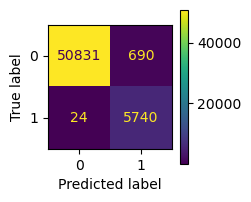

In [36]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_prediction)
finalPrecision = precision_score(pp_data_outputs, final_prediction)
finalRecall = recall_score(pp_data_outputs, final_prediction)
finalF1 = f1_score(pp_data_outputs, final_prediction)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_prediction)
finalClassificationReport = classification_report(pp_data_outputs, final_prediction)

# Imprime resultados finais
print("Resultado utilizando a função 'voting()'")
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

Resultado utilizando a floresta aleatória
Accuracy: 98.8094614646068
Precision: 89.7777082028804
Recall: 99.49687716863289
F1-Score: 94.38775510204081
[[50868   653]
 [   29  5735]]


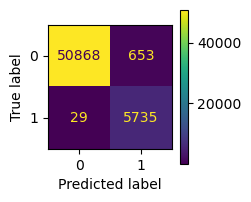

In [37]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_ensemble_prediction)
finalPrecision = precision_score(pp_data_outputs, final_ensemble_prediction)
finalRecall = recall_score(pp_data_outputs, final_ensemble_prediction)
finalF1 = f1_score(pp_data_outputs, final_ensemble_prediction)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_ensemble_prediction)
finalClassificationReport = classification_report(pp_data_outputs, final_ensemble_prediction)

# Imprime resultados finais
print("Resultado utilizando a floresta aleatória")
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

In [38]:
logging.basicConfig(stream=sys.stdout, level=logging.DEBUG)
# Conifer Settings 
cfg = {'Backend' : 'vhdl',
              'ProjectName' : 'my-prj',
              'OutputDir'   : 'my-conifer-prj',
              'Precision'   : 'ap_fixed<19,12>', #exemplo: <18,12> -> 18 bits total, 12 para representar a parte inteira e 18 - 12 = 6 para representação decimal
              'XilinxPart' : 'xc7s100',
              'ClockPeriod' : '5'}

# Set the output directory to something unique
cfg['OutputDir'] = 'prjFPGA1_{}'.format("ensembleTeste4<19,12>depth9")

In [39]:
# Create and compile the model
model_1 = conifer.converters.convert_from_sklearn(ensemble_decision_tree, cfg)
#Compila modelo 
model_1.compile()

DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 8, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prjFPGA1_ensembleTeste4<19,12>depth9
INFO:conifer.backends.vhdl.writer:Writing project to prjFPGA1_ensembleTeste4<19,12>depth9
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


In [40]:
pp_dataset = pre_processing("DatasetT3.csv")
display(pp_dataset)

#Define as entradas e as saídas do dataset
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

pp_data_inputs = pp_data_inputs.to_numpy(dtype=np.float32)

y_hdl = model_1.decision_function(pp_data_inputs) #Calcula a probabilidade da saída ser da classe A dado as entradas x, y, z (HDL)
y_skl = ensemble_decision_tree.predict_proba(pp_data_inputs) #Calcula a probabilidade da saída ser da classe A dado as entradas x, y, z (Sklearn)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,0.504450,0.000000,1.3950,1.0
1,0.000000,0.000000,1.1625,1.0
2,0.000000,0.000000,0.9300,1.0
3,1.158221,0.000000,0.7800,1.0
4,0.156073,0.000000,0.6500,1.0
...,...,...,...,...
57280,1998.864111,26.913394,1.3950,0.0
57281,1998.304338,27.914276,1.1625,0.0
57282,1999.635227,27.073422,0.9300,0.0
57283,1999.776292,27.574239,0.7800,0.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,0.504450,0.000000,1.3950
1,0.000000,0.000000,1.1625
2,0.000000,0.000000,0.9300
3,1.158221,0.000000,0.7800
4,0.156073,0.000000,0.6500
...,...,...,...
57280,1998.864111,26.913394,1.3950
57281,1998.304338,27.914276,1.1625
57282,1999.635227,27.073422,0.9300
57283,1999.776292,27.574239,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Accuracy HDL: 98.81469843763638
Precision HDL: 89.84485190409028
Recall HDL: 99.46217904233171
[[50873   648]
 [   31  5733]]
DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7fed84cd1340>


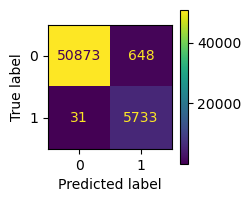

Accuracy SKL: 98.8094614646068
Precision SKL: 89.7777082028804
Recall SKL: 99.49687716863289
[[50868   653]
 [   29  5735]]
DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7fed86177550>


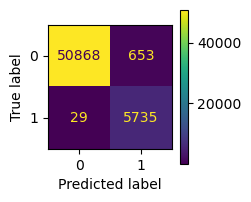

In [41]:
y_hdl_real = [1 if x <= 0.5 else 0 for x in y_hdl] #Retorna a classe (0 ou 1) dado sua probabilidade de acontecer
y_skl_real = ensemble_decision_tree.predict(pp_data_inputs)

finalAccuracy = accuracy_score(pp_data_outputs, y_hdl_real)
finalPrecision = precision_score(pp_data_outputs, y_hdl_real)
finalRecall = recall_score(pp_data_outputs, y_hdl_real)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, y_hdl_real)

print('Accuracy HDL:', finalAccuracy*100)
print('Precision HDL:', finalPrecision*100)
print('Recall HDL:', finalRecall*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

finalAccuracy = accuracy_score(pp_data_outputs, y_skl_real)
finalPrecision = precision_score(pp_data_outputs, y_skl_real)
finalRecall = recall_score(pp_data_outputs, y_skl_real)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, y_skl_real)

print('Accuracy SKL:', finalAccuracy*100)
print('Precision SKL:', finalPrecision*100)
print('Recall SKL:', finalRecall*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

In [40]:
# Synthesize the model
model_1.build()

INFO:conifer.backends.vhdl.writer:build starting 15:18:08
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"


ERROR: [Common 17-176] Overwrite of existing file isn't enabled.  Please specify -force to overwrite file  [my-prj.edf]


INFO:conifer.backends.vhdl.writer:build finished 15:36:53 - took 0:18:44.885948
ERROR:conifer.backends.vhdl.writer:build failed, check build.log


False

<h2>FPGA_2</h2>

In [42]:
pp_dataset = pre_processing("DatasetT&V2.csv")
display(pp_dataset)

#Define as entradas e as saídas do dataset
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

dtrees_2 = [final_decision_tree_6, final_decision_tree_7, final_decision_tree_8] #Vetor de árvores de decisão

#Classificador dummy para pode utilizar a função conversora (apenas o número de estimadores deve ser compatível com o número de árvores na lista)
starting_random_forest = RandomForestClassifier(n_estimators=len(dtrees_2), max_depth=4, random_state=0).fit(pp_data_inputs, pp_data_outputs)

#Cria árvore de decisão utilizando os estimadores da lista
ensemble_decision_tree_2 = convert_tree_to_random_forest(dtrees_2, starting_random_forest)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,1.426390,0.000000,1.3950,1.0
1,0.247126,0.000000,1.1625,1.0
2,1.318730,0.000000,0.9300,1.0
3,0.000000,0.000000,0.7800,1.0
4,1.181601,0.000000,0.6500,1.0
...,...,...,...,...
57280,1998.258208,27.787054,1.3950,0.0
57281,2001.582818,27.545077,1.1625,0.0
57282,2000.103125,29.680000,0.9300,0.0
57283,2001.308140,28.895288,0.7800,0.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,1.426390,0.000000,1.3950
1,0.247126,0.000000,1.1625
2,1.318730,0.000000,0.9300
3,0.000000,0.000000,0.7800
4,1.181601,0.000000,0.6500
...,...,...,...
57280,1998.258208,27.787054,1.3950
57281,2001.582818,27.545077,1.1625
57282,2000.103125,29.680000,0.9300
57283,2001.308140,28.895288,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


/tmp/ipykernel_21021/3795334205.py:14: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  starting_random_forest = RandomForestClassifier(n_estimators=len(dtrees_2), max_depth=4, random_state=0).fit(pp_data_inputs, pp_data_outputs)


In [43]:
pp_dataset = pre_processing("DatasetT3.csv")
display(pp_dataset)

#Define as entradas e as saídas do dataset
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

decision_trees_2 = dtrees_2

#Comparação entre votação da função criada e a floresta aleatória criada manualmente
#De forma geral a função "voting" apresenta melhor recall e menor precisão, as diferenças são pequenas em comparação com a floresta aleatória criada
final_prediction_2 = voting("DatasetT3.csv", decision_trees_2)

final_ensemble_prediction_2 = ensemble_decision_tree_2.predict(pp_data_inputs)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,0.504450,0.000000,1.3950,1.0
1,0.000000,0.000000,1.1625,1.0
2,0.000000,0.000000,0.9300,1.0
3,1.158221,0.000000,0.7800,1.0
4,0.156073,0.000000,0.6500,1.0
...,...,...,...,...
57280,1998.864111,26.913394,1.3950,0.0
57281,1998.304338,27.914276,1.1625,0.0
57282,1999.635227,27.073422,0.9300,0.0
57283,1999.776292,27.574239,0.7800,0.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,0.504450,0.000000,1.3950
1,0.000000,0.000000,1.1625
2,0.000000,0.000000,0.9300
3,1.158221,0.000000,0.7800
4,0.156073,0.000000,0.6500
...,...,...,...
57280,1998.864111,26.913394,1.3950
57281,1998.304338,27.914276,1.1625
57282,1999.635227,27.073422,0.9300
57283,1999.776292,27.574239,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


Resultado utilizando a função 'voting()'
Accuracy: 99.24413022606267
Precision: 93.80443714050945
Recall: 99.02845246356696
F1-Score: 96.34568318001519
[[51144   377]
 [   56  5708]]
DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7fed860186d0>


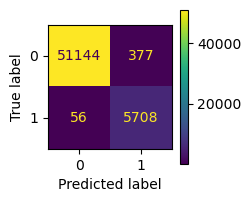

In [44]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_prediction_2)
finalPrecision = precision_score(pp_data_outputs, final_prediction_2)
finalRecall = recall_score(pp_data_outputs, final_prediction_2)
finalF1 = f1_score(pp_data_outputs, final_prediction_2)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_prediction_2)
finalClassificationReport = classification_report(pp_data_outputs, final_prediction_2)

# Imprime resultados finais
print("Resultado utilizando a função 'voting()'")
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

Resultado utilizando a floresta aleatória
Accuracy: 99.2633324605045
Precision: 93.98880105401844
Recall: 99.01110340041637
F1-Score: 96.4346062859074
[[51156   365]
 [   57  5707]]
DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7fed86c39ee0>


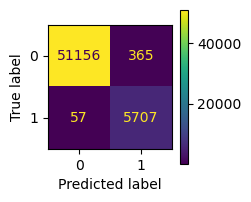

In [45]:
# Métricas de performance
finalAccuracy = accuracy_score(pp_data_outputs, final_ensemble_prediction_2)
finalPrecision = precision_score(pp_data_outputs, final_ensemble_prediction_2)
finalRecall = recall_score(pp_data_outputs, final_ensemble_prediction_2)
finalF1 = f1_score(pp_data_outputs, final_ensemble_prediction_2)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, final_ensemble_prediction_2)
finalClassificationReport = classification_report(pp_data_outputs, final_ensemble_prediction_2)

# Imprime resultados finais
print("Resultado utilizando a floresta aleatória")
print('Accuracy:', finalAccuracy*100)
print('Precision:', finalPrecision*100)
print('Recall:', finalRecall*100)
print('F1-Score:', finalF1*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

In [46]:
logging.basicConfig(stream=sys.stdout, level=logging.DEBUG)
# Conifer Settings 
cfg = {'Backend' : 'vhdl',
              'ProjectName' : 'my-prj',
              'OutputDir'   : 'my-conifer-prj',
              'Precision'   : 'ap_fixed<19,12>', #exemplo: <18,12> -> 18 bits total, 12 para representar a parte inteira e 18 - 12 = 6 para representação decimal
              'XilinxPart' : 'xc7s100',
              'ClockPeriod' : '5'}

# Set the output directory to something unique
cfg['OutputDir'] = 'prjFPGA2_{}'.format("ensembleTeste4<19,12>depth9")

In [47]:
# Create and compile the model
model_2 = conifer.converters.convert_from_sklearn(ensemble_decision_tree_2, cfg)
#Compila modelo 
model_2.compile()

DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prjFPGA2_ensembleTeste4<19,12>depth9
INFO:conifer.backends.vhdl.writer:Writing project to prjFPGA2_ensembleTeste4<19,12>depth9
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


In [48]:
pp_dataset = pre_processing("DatasetT3.csv")
display(pp_dataset)

#Define as entradas e as saídas do dataset
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
display(pp_data_inputs)

pp_data_outputs = pp_dataset[['Decisão']]
display(pp_data_outputs)

pp_data_inputs = pp_data_inputs.to_numpy(dtype=np.float32)

y_hdl_2 = model_2.decision_function(pp_data_inputs) #Calcula a probabilidade da saída ser da classe A dado as entradas x, y, z (HDL)
y_skl_2 = ensemble_decision_tree_2.predict_proba(pp_data_inputs) #Calcula a probabilidade da saída ser da classe A dado as entradas x, y, z (Sklearn)

,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Decisão
0,0.504450,0.000000,1.3950,1.0
1,0.000000,0.000000,1.1625,1.0
2,0.000000,0.000000,0.9300,1.0
3,1.158221,0.000000,0.7800,1.0
4,0.156073,0.000000,0.6500,1.0
...,...,...,...,...
57280,1998.864111,26.913394,1.3950,0.0
57281,1998.304338,27.914276,1.1625,0.0
57282,1999.635227,27.073422,0.9300,0.0
57283,1999.776292,27.574239,0.7800,0.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa
0,0.504450,0.000000,1.3950
1,0.000000,0.000000,1.1625
2,0.000000,0.000000,0.9300
3,1.158221,0.000000,0.7800
4,0.156073,0.000000,0.6500
...,...,...,...
57280,1998.864111,26.913394,1.3950
57281,1998.304338,27.914276,1.1625
57282,1999.635227,27.073422,0.9300
57283,1999.776292,27.574239,0.7800


,Decisão
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
57280,0.0
57281,0.0
57282,0.0
57283,0.0


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Accuracy HDL: 99.26856943353408
Precision HDL: 94.06430338004947
Recall HDL: 98.9764052741152
[[51161   360]
 [   59  5705]]
DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7fed85ffb4f0>


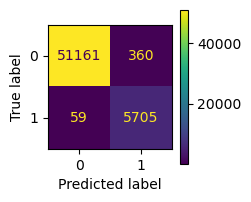

Accuracy SKL: 99.2633324605045
Precision SKL: 93.98880105401844
Recall SKL: 99.01110340041637
[[51156   365]
 [   57  5707]]
DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x7fed86d428e0>


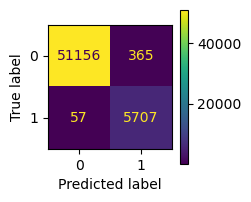

In [49]:
y_hdl_real_2 = [1 if x <= 0.5 else 0 for x in y_hdl_2] #Retorna a classe (0 ou 1) dado sua probabilidade de acontecer
y_skl_real_2 = ensemble_decision_tree_2.predict(pp_data_inputs)

finalAccuracy = accuracy_score(pp_data_outputs, y_hdl_real_2)
finalPrecision = precision_score(pp_data_outputs, y_hdl_real_2)
finalRecall = recall_score(pp_data_outputs, y_hdl_real_2)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, y_hdl_real_2)

print('Accuracy HDL:', finalAccuracy*100)
print('Precision HDL:', finalPrecision*100)
print('Recall HDL:', finalRecall*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

finalAccuracy = accuracy_score(pp_data_outputs, y_skl_real_2)
finalPrecision = precision_score(pp_data_outputs, y_skl_real_2)
finalRecall = recall_score(pp_data_outputs, y_skl_real_2)
finalConfusionMatrix = confusion_matrix(pp_data_outputs, y_skl_real_2)

print('Accuracy SKL:', finalAccuracy*100)
print('Precision SKL:', finalPrecision*100)
print('Recall SKL:', finalRecall*100)
print(finalConfusionMatrix)
ConfusionMatrixDisplay(finalConfusionMatrix).plot()
plt.show()

In [49]:
# Synthesize the model
model_2.build()

INFO:conifer.backends.vhdl.writer:build starting 15:39:13
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 15:59:10 - took 0:19:57.778309


True

<h2>Conifer voting</h2>

<h3>Conifer</h3>

<h4>simple mean</h4>

In [50]:
pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

predict_prob_1_hdl = y_hdl
predict_prob_2_hdl = y_hdl_2

mean_prob_hdl = np.array([sum(x) for x in zip(predict_prob_1_hdl, predict_prob_2_hdl)])*0.5
mean_pred_hdl = [1 if x <= 0.5 else 0 for x in mean_prob_hdl]

finalRecall_hdl_1 = recall_score(pp_data_outputs, y_hdl_real)
finalRecall_hdl_2 = recall_score(pp_data_outputs, y_hdl_real_2)
finalRecall_mean_hdl = recall_score(pp_data_outputs, mean_pred_hdl)

finalPrecision_hdl_1 = precision_score(pp_data_outputs, y_hdl_real)
finalPrecision_hdl_2 = precision_score(pp_data_outputs, y_hdl_real_2)
finalPrecision_mean_hdl = precision_score(pp_data_outputs, mean_pred_hdl)

finalAccuracy_hdl_1 = accuracy_score(pp_data_outputs, y_hdl_real)
finalAccuracy_hdl_2 = accuracy_score(pp_data_outputs, y_hdl_real_2)
finalAccuracy_mean_hdl = accuracy_score(pp_data_outputs, mean_pred_hdl)

print('Accuracy HDL ensemble 1:', finalAccuracy_hdl_1*100)
print('Accuracy HDL ensemble 2:', finalAccuracy_hdl_2*100)
print('Accuracy mean:', finalAccuracy_mean_hdl*100)
print()

print('Precision HDL ensemble 1:', finalPrecision_hdl_1*100)
print('Precision HDL ensemble 2:', finalPrecision_hdl_2*100)
print('Precision mean:', finalPrecision_mean_hdl*100)
print()
 
print('Recall HDL ensemble 1:', finalRecall_hdl_1*100)
print('Recall HDL ensemble 2:', finalRecall_hdl_2*100)
print('Recall mean:', finalRecall_mean_hdl*100)

Accuracy HDL ensemble 1: 98.81469843763638
Accuracy HDL ensemble 2: 99.26856943353408
Accuracy mean: 99.11844287335254

Precision HDL ensemble 1: 89.84485190409028
Precision HDL ensemble 2: 94.06430338004947
Precision mean: 92.37711522965351

Recall HDL ensemble 1: 99.46217904233171
Recall HDL ensemble 2: 98.9764052741152
Recall mean: 99.44482997918112


<h4>pondered average</h4>

In [54]:
#Descobre qual conjunto de estimadores tem a melhor precisão e recall
pp_dataset = pre_processing("DatasetT2.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_inputs = pp_data_inputs.to_numpy()
pp_data_outputs = pp_dataset[['Decisão']]

predict_1_prob = model_1.decision_function(pp_data_inputs)
predict_1 = [1 if x <= 0.5 else 0 for x in predict_1_prob] #Retorna a classe (0 ou 1) dado sua probabilidade de acontecer

predict_2_prob = model_2.decision_function(pp_data_inputs)
predict_2 = [1 if x <= 0.5 else 0 for x in predict_2_prob] #Retorna a classe (0 ou 1) dado sua probabilidade de acontecer

recall_T_hdl_1 = recall_score(pp_data_outputs, predict_1)
recall_T_hdl_2 = recall_score(pp_data_outputs, predict_2)

precision_T_hdl_1 = precision_score(pp_data_outputs, predict_1)
precision_T_hdl_2 = precision_score(pp_data_outputs, predict_2)

if (recall_T_hdl_1 > recall_T_hdl_2):
    recall_model = model_1
else:
    recall_model = model_2

if (precision_T_hdl_1 > precision_T_hdl_2):
    precision_model = model_1
else:
    precision_model = model_2

# Realiza a média ponderada
pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_inputs = pp_data_inputs.to_numpy()
pp_data_outputs = pp_dataset[['Decisão']]

precision_predict_proba = precision_model.decision_function(pp_data_inputs)
recall_predict_proba = recall_model.decision_function(pp_data_inputs)

pondered_prob = np.zeros(len(pp_data_inputs))

distance = [row[0] for row in pp_data_inputs]
speed = [row[1] for row in pp_data_inputs]
brake_capacity = [row[2] for row in pp_data_inputs]

for i in range(len(distance)):
    if (distance[i] > 705):
        pondered_prob[i] = np.average([precision_predict_proba[i], recall_predict_proba[i]], weights =(10, 1))
    else:
        pondered_prob[i] = np.average([precision_predict_proba[i], recall_predict_proba[i]], weights =(1, 1))

pondered_pred = [1 if x <= 0.5 else 0 for x in pondered_prob]

predict_1_prob = model_1.decision_function(pp_data_inputs)
predict_1 = [1 if x <= 0.5 else 0 for x in predict_1_prob]

predict_2_prob = model_2.decision_function(pp_data_inputs)
predict_2 = [1 if x <= 0.5 else 0 for x in predict_2_prob] #

finalRecall_skl_1 = recall_score(pp_data_outputs, predict_1)
finalRecall_skl_2 = recall_score(pp_data_outputs, predict_2)
finalRecall_mean = recall_score(pp_data_outputs, pondered_pred)

finalPrecision_skl_1 = precision_score(pp_data_outputs, predict_1)
finalPrecision_skl_2 = precision_score(pp_data_outputs, predict_2)
finalPrecision_mean = precision_score(pp_data_outputs, pondered_pred)

finalAccuracy_skl_1 = accuracy_score(pp_data_outputs, predict_1)
finalAccuracy_skl_2 = accuracy_score(pp_data_outputs, predict_2)
finalAccuracy_mean = accuracy_score(pp_data_outputs, pondered_pred)

print()
print('Accuracy SKL ensemble 1:', finalAccuracy_skl_1*100)
print('Accuracy SKL ensemble 2:', finalAccuracy_skl_2*100)
print('Accuracy mean:', finalAccuracy_mean*100)
print()

print('Precision SKL ensemble 1:', finalPrecision_skl_1*100)
print('Precision SKL ensemble 2:', finalPrecision_skl_2*100)
print('Precision mean:', finalPrecision_mean*100)
print()
 
print('Recall SKL ensemble 1:', finalRecall_skl_1*100)
print('Recall SKL ensemble 2:', finalRecall_skl_2*100)
print('Recall mean:', finalRecall_mean*100)

INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float64), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float64), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float64), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Conver

<h4>confidence</h4>

In [57]:
#Descobre qual conjunto de estimadores tem a melhor precisão e recall
pp_dataset = pre_processing("DatasetT2.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_inputs = pp_data_inputs.to_numpy()
pp_data_outputs = pp_dataset[['Decisão']]

predict_1_prob = model_1.decision_function(pp_data_inputs)
predict_1 = [1 if x <= 0.5 else 0 for x in predict_1_prob] #Retorna a classe (0 ou 1) dado sua probabilidade de acontecer

predict_2_prob = model_2.decision_function(pp_data_inputs)
predict_2 = [1 if x <= 0.5 else 0 for x in predict_2_prob] #Retorna a classe (0 ou 1) dado sua probabilidade de acontecer

recall_T_hdl_1 = recall_score(pp_data_outputs, predict_1)
recall_T_hdl_2 = recall_score(pp_data_outputs, predict_2)

precision_T_hdl_1 = precision_score(pp_data_outputs, predict_1)
precision_T_hdl_2 = precision_score(pp_data_outputs, predict_2)

if (recall_T_hdl_1 > recall_T_hdl_2):
    recall_model = model_1
else:
    recall_model = model_2

if (precision_T_hdl_1 > precision_T_hdl_2):
    precision_model = model_1
else:
    precision_model = model_2

# Realiza a média ponderada
pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_inputs = pp_data_inputs.to_numpy()
pp_data_outputs = pp_dataset[['Decisão']]

precision_predict_proba = precision_model.decision_function(pp_data_inputs)
predict_precision = [1 if x <= 0.5 else 0 for x in precision_predict_proba] 

recall_predict_proba = recall_model.decision_function(pp_data_inputs)
predict_recall = [1 if x <= 0.5 else 0 for x in recall_predict_proba] 

pondered_prob = np.zeros(len(pp_data_inputs))

for i in range(len(pp_data_inputs)):
    if(recall_predict_proba[i] < 0.5 and precision_predict_proba[i] < 0.5): #FPGA recall diz 1 e FPGA precision diz 1
        pondered_prob[i] = recall_predict_proba[i]
    if(recall_predict_proba[i] > 0.5 and precision_predict_proba[i] < 0.5): #FPGA recall diz 0 e FPGA precision diz 1
        pondered_prob[i] = precision_predict_proba[i]
    if(recall_predict_proba[i] < 0.5 and precision_predict_proba[i] > 0.5): #FPGA recall diz 1 e FPGA precision diz 0
        pondered_prob[i] = recall_predict_proba[i]
    if(recall_predict_proba[i] > 0.5 and precision_predict_proba[i] > 0.5): #FPGA recall diz 0 e FPGA precision diz 0
        pondered_prob[i] = precision_predict_proba[i]

pondered_pred = [1 if x <= 0.5 else 0 for x in pondered_prob]

predict_1_prob = model_1.decision_function(pp_data_inputs)
predict_1 = [1 if x <= 0.5 else 0 for x in predict_1_prob]

predict_2_prob = model_2.decision_function(pp_data_inputs)
predict_2 = [1 if x <= 0.5 else 0 for x in predict_2_prob] 

finalRecall_skl_1 = recall_score(pp_data_outputs, predict_1)
finalRecall_skl_2 = recall_score(pp_data_outputs, predict_2)
finalRecall_mean = recall_score(pp_data_outputs, pondered_pred)

finalPrecision_skl_1 = precision_score(pp_data_outputs, predict_1)
finalPrecision_skl_2 = precision_score(pp_data_outputs, predict_2)
finalPrecision_mean = precision_score(pp_data_outputs, pondered_pred)

finalAccuracy_skl_1 = accuracy_score(pp_data_outputs, predict_1)
finalAccuracy_skl_2 = accuracy_score(pp_data_outputs, predict_2)
finalAccuracy_mean = accuracy_score(pp_data_outputs, pondered_pred)

print()
print('Accuracy SKL ensemble 1:', finalAccuracy_skl_1*100)
print('Accuracy SKL ensemble 2:', finalAccuracy_skl_2*100)
print('Accuracy mean:', finalAccuracy_mean*100)
print()

print('Precision SKL ensemble 1:', finalPrecision_skl_1*100)
print('Precision SKL ensemble 2:', finalPrecision_skl_2*100)
print('Precision mean:', finalPrecision_mean*100)
print()
 
print('Recall SKL ensemble 1:', finalRecall_skl_1*100)
print('Recall SKL ensemble 2:', finalRecall_skl_2*100)
print('Recall mean:', finalRecall_mean*100)

INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float64), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float64), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float64), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Conver

<h3>SKL</h3>

<h4>simple mean</h4>

In [51]:
pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

predict_1 = ensemble_decision_tree.predict_proba(pp_data_inputs)
predict_1 = [row[0] for row in predict_1]

predict_2 = ensemble_decision_tree_2.predict_proba(pp_data_inputs)
predict_2 = [row[0] for row in predict_2]

mean_prob = np.array([np.mean(x) for x in zip(predict_1, predict_2)])

mean_pred = [1 if x <= 0.5 else 0 for x in mean_prob]
normal_pred_1 = ensemble_decision_tree.predict(pp_data_inputs)
normal_pred_2 = ensemble_decision_tree_2.predict(pp_data_inputs)

finalRecall_skl_1 = recall_score(pp_data_outputs, normal_pred_1)
finalRecall_skl_2 = recall_score(pp_data_outputs, normal_pred_2)
finalRecall_mean = recall_score(pp_data_outputs, mean_pred)

finalPrecision_skl_1 = precision_score(pp_data_outputs, normal_pred_1)
finalPrecision_skl_2 = precision_score(pp_data_outputs, normal_pred_2)
finalPrecision_mean = precision_score(pp_data_outputs, mean_pred)

finalAccuracy_skl_1 = accuracy_score(pp_data_outputs, normal_pred_1)
finalAccuracy_skl_2 = accuracy_score(pp_data_outputs, normal_pred_2)
finalAccuracy_mean = accuracy_score(pp_data_outputs, mean_pred)

print('Accuracy SKL ensemble 1:', finalAccuracy_skl_1*100)
print('Accuracy SKL ensemble 2:', finalAccuracy_skl_2*100)
print('Accuracy mean:', finalAccuracy_mean*100)
print()

print('Precision SKL ensemble 1:', finalPrecision_skl_1*100)
print('Precision SKL ensemble 2:', finalPrecision_skl_2*100)
print('Precision mean:', finalPrecision_mean*100)
print()
 
print('Recall SKL ensemble 1:', finalRecall_skl_1*100)
print('Recall SKL ensemble 2:', finalRecall_skl_2*100)
print('Recall mean:', finalRecall_mean*100)

Accuracy SKL Emsemble 1: 98.82342672601902
Accuracy SKL Emsemble 2: 99.2109627302086
Accuracy mean: 99.1044776119403

Precision SKL Emsemble 1: 89.86528822055138
Precision SKL Emsemble 2: 93.82838283828383
Precision mean: 92.35360542022907

Recall SKL Emsemble 1: 99.53157529493407
Recall SKL Emsemble 2: 98.64677307425399
Recall mean: 99.32338653712699


<h4>pondered average</h4>

In [66]:
#Descobre qual conjunto de estimadores tem a melhor precisão e recall

pp_dataset = pre_processing("DatasetT2.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

predict_1 = ensemble_decision_tree.predict(pp_data_inputs)
predict_2 = ensemble_decision_tree_2.predict(pp_data_inputs)

recall_T_skl_1 = recall_score(pp_data_outputs, predict_1)
recall_T_skl_2 = recall_score(pp_data_outputs, predict_2)

precision_T_skl_1 = precision_score(pp_data_outputs, predict_1)
precision_T_skl_2 = precision_score(pp_data_outputs, predict_2)

if (recall_T_skl_1 > recall_T_skl_2):
    recall_rf = ensemble_decision_tree
else:
    recall_rf = ensemble_decision_tree_2

if (precision_T_skl_1 > precision_T_skl_2):
    precision_rf = ensemble_decision_tree
else:
    precision_rf = ensemble_decision_tree_2

# Realiza a média ponderada

pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

precision_predict_proba = precision_rf.predict_proba(pp_data_inputs)
precision_predict_proba = [row[0] for row in precision_predict_proba]

recall_predict_proba = recall_rf.predict_proba(pp_data_inputs)
recall_predict_proba = [row[0] for row in recall_predict_proba]

pondered_prob = np.zeros(len(pp_data_inputs))
pp_data_inputs = pp_data_inputs.to_numpy()

distance = [row[0] for row in pp_data_inputs]
speed = [row[1] for row in pp_data_inputs]
brake_capacity = [row[2] for row in pp_data_inputs]

for i in range(len(distance)):
    if (distance[i] > 705):
        pondered_prob[i] = np.average([precision_predict_proba[i], recall_predict_proba[i]], weights =(10, 1))
    else:
        pondered_prob[i] = np.average([precision_predict_proba[i], recall_predict_proba[i]], weights =(1, 1))

pondered_pred = [1 if x <= 0.5 else 0 for x in pondered_prob]
normal_pred_1 = precision_rf.predict(pp_data_inputs)
normal_pred_2 = recall_rf.predict(pp_data_inputs)

finalRecall_skl_1 = recall_score(pp_data_outputs, normal_pred_1)
finalRecall_skl_2 = recall_score(pp_data_outputs, normal_pred_2)
finalRecall_mean = recall_score(pp_data_outputs, pondered_pred)

finalPrecision_skl_1 = precision_score(pp_data_outputs, normal_pred_1)
finalPrecision_skl_2 = precision_score(pp_data_outputs, normal_pred_2)
finalPrecision_mean = precision_score(pp_data_outputs, pondered_pred)

finalAccuracy_skl_1 = accuracy_score(pp_data_outputs, normal_pred_1)
finalAccuracy_skl_2 = accuracy_score(pp_data_outputs, normal_pred_2)
finalAccuracy_mean = accuracy_score(pp_data_outputs, pondered_pred)

print('Accuracy SKL ensemble 1:', finalAccuracy_skl_1*100)
print('Accuracy SKL ensemble 2:', finalAccuracy_skl_2*100)
print('Accuracy mean:', finalAccuracy_mean*100)
print()

print('Precision SKL ensemble 1:', finalPrecision_skl_1*100)
print('Precision SKL ensemble 2:', finalPrecision_skl_2*100)
print('Precision mean:', finalPrecision_mean*100)
print()
 
print('Recall SKL ensemble 1:', finalRecall_skl_1*100)
print('Recall SKL ensemble 2:', finalRecall_skl_2*100)
print('Recall mean:', finalRecall_mean*100)

/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Accuracy SKL Emsemble 1: 99.2109627302086
Accuracy SKL Emsemble 2: 98.82342672601902
Accuracy mean: 99.1044776119403

Precision SKL Emsemble 1: 93.82838283828383
Precision SKL Emsemble 2: 89.86528822055138
Precision mean: 92.35360542022907

Recall SKL Emsemble 1: 98.64677307425399
Recall SKL Emsemble 2: 99.53157529493407
Recall mean: 99.32338653712699


<h4>confidence</h4>

In [65]:
#Descobre qual conjunto de estimadores tem a melhor precisão e recall

pp_dataset = pre_processing("DatasetT2.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

predict_1 = ensemble_decision_tree.predict(pp_data_inputs)
predict_2 = ensemble_decision_tree_2.predict(pp_data_inputs)

recall_T_skl_1 = recall_score(pp_data_outputs, predict_1)
recall_T_skl_2 = recall_score(pp_data_outputs, predict_2)

precision_T_skl_1 = precision_score(pp_data_outputs, predict_1)
precision_T_skl_2 = precision_score(pp_data_outputs, predict_2)

if (recall_T_skl_1 > recall_T_skl_2):
    recall_rf = ensemble_decision_tree
else:
    recall_rf = ensemble_decision_tree_2

if (precision_T_skl_1 > precision_T_skl_2):
    precision_rf = ensemble_decision_tree
else:
    precision_rf = ensemble_decision_tree_2


pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

predict_precision = precision_rf.predict_proba(pp_data_inputs)
predict_precision = [row[0] for row in predict_precision]

predict_recall = recall_rf.predict_proba(pp_data_inputs)
predict_recall = [row[0] for row in predict_recall]

pondered_prob = np.zeros(len(pp_data_inputs))
pp_data_inputs = pp_data_inputs.to_numpy()
# 1 se prob <= 0.5

for i in range(len(pp_data_inputs)):
    if(predict_recall[i] < 0.5 and predict_precision[i] < 0.5): #FPGA recall diz 1 e FPGA precision diz 1
        pondered_prob[i] = predict_recall[i]
    if(predict_recall[i] > 0.5 and predict_precision[i] < 0.5): #FPGA recall diz 0 e FPGA precision diz 1
        pondered_prob[i] = predict_precision[i]
    if(predict_recall[i] < 0.5 and predict_precision[i] > 0.5): #FPGA recall diz 1 e FPGA precision diz 0
        pondered_prob[i] = predict_recall[i]
    if(predict_recall[i] > 0.5 and predict_precision[i] > 0.5): #FPGA recall diz 0 e FPGA precision diz 0
        pondered_prob[i] = predict_precision[i]

pondered_pred = [1 if x <= 0.5 else 0 for x in pondered_prob]
normal_pred_1 = ensemble_decision_tree.predict(pp_data_inputs)
normal_pred_2 = ensemble_decision_tree_2.predict(pp_data_inputs)

finalRecall_skl_1 = recall_score(pp_data_outputs, normal_pred_1)
finalRecall_skl_2 = recall_score(pp_data_outputs, normal_pred_2)
finalRecall_mean = recall_score(pp_data_outputs, pondered_pred)

finalPrecision_skl_1 = precision_score(pp_data_outputs, normal_pred_1)
finalPrecision_skl_2 = precision_score(pp_data_outputs, normal_pred_2)
finalPrecision_mean = precision_score(pp_data_outputs, pondered_pred)

finalAccuracy_skl_1 = accuracy_score(pp_data_outputs, normal_pred_1)
finalAccuracy_skl_2 = accuracy_score(pp_data_outputs, normal_pred_2)
finalAccuracy_mean = accuracy_score(pp_data_outputs, pondered_pred)

print('Accuracy SKL ensemble 1:', finalAccuracy_skl_1*100)
print('Accuracy SKL ensemble 2:', finalAccuracy_skl_2*100)
print('Accuracy mean:', finalAccuracy_mean*100)
print()

print('Precision SKL ensemble 1:', finalPrecision_skl_1*100)
print('Precision SKL ensemble 2:', finalPrecision_skl_2*100)
print('Precision mean:', finalPrecision_mean*100)
print()
 
print('Recall SKL ensemble 1:', finalRecall_skl_1*100)
print('Recall SKL ensemble 2:', finalRecall_skl_2*100)
print('Recall mean:', finalRecall_mean*100)

/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Accuracy SKL Emsemble 1: 98.82342672601902
Accuracy SKL Emsemble 2: 99.2109627302086
Accuracy mean: 98.70821331936807

Precision SKL Emsemble 1: 89.86528822055138
Precision SKL Emsemble 2: 93.82838283828383
Precision mean: 88.76543209876543

Recall SKL Emsemble 1: 99.53157529493407
Recall SKL Emsemble 2: 98.64677307425399
Recall mean: 99.79181124219292


<h1>depth-LUT analysis</h1>

In [55]:
depths = [int(x) for x in range(2,10)]
rf_classifiers = []

pp_dataset = pre_processing("DatasetT&V.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

logging.basicConfig(stream=sys.stdout, level=logging.DEBUG)
# Conifer Settings 
cfg = {'Backend' : 'vhdl',
        'ProjectName' : 'my-prj',
        'OutputDir'   : 'my-conifer-prj',
        'Precision'   : 'ap_fixed<19,12>', #exemplo: <18,12> -> 18 bits total, 12 para representar a parte inteira e 18 - 12 = 6 para representação decimal
        'XilinxPart' : 'xc7s100',
        'ClockPeriod' : '5'}

for depth in depths:
    rf = RandomForestClassifier(n_estimators=3, max_depth=depth).fit(pp_data_inputs, np.ravel(pp_data_outputs))
    rf_classifiers.append(rf)

pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

for i in range(len(rf_classifiers)):
    predicted = rf_classifiers[i].predict(pp_data_inputs)
    finalRecall = recall_score(pp_data_outputs, predicted)
    print(f"depth = {rf_classifiers[i].max_depth} | recall = {finalRecall*100}%")

    cfg['OutputDir'] = 'prj_{}'.format(f"LUTs - depth = {rf_classifiers[i].max_depth}")
    model = conifer.converters.convert_from_sklearn(rf_classifiers[i], cfg)
    model.compile()
    model.build()

depth = 2 | recall = 0.0%
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 2, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_LUTs - depth = 2
INFO:conifer.backends.vhdl.writer:Writing project to prj_LUTs - depth = 2
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:build starting 18:13:02
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 18:14:08 - took 0:01:05.207772
depth = 3 | recall = 61.39833448993755%
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 3, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_LUTs - depth = 3
INFO:conifer.backends.vhdl.writer:Writing project to prj_LUTs - depth = 3
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:build starting 18:14:28
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 18:15:34 - took 0:01:05.790736
depth = 4 | recall = 67.36641221374046%
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 4, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_LUTs - depth = 4
INFO:conifer.backends.vhdl.writer:Writing project to prj_LUTs - depth = 4
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:build starting 18:15:54
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 18:17:02 - took 0:01:07.978988
depth = 5 | recall = 87.95975017349063%
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 5, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_LUTs - depth = 5
INFO:conifer.backends.vhdl.writer:Writing project to prj_LUTs - depth = 5
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:build starting 18:17:24
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 18:18:35 - took 0:01:11.478368
depth = 6 | recall = 84.47258848022207%
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 6, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_LUTs - depth = 6
INFO:conifer.backends.vhdl.writer:Writing project to prj_LUTs - depth = 6
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:build starting 18:19:00
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 18:20:18 - took 0:01:18.632181
depth = 7 | recall = 91.46426092990978%
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 7, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_LUTs - depth = 7
INFO:conifer.backends.vhdl.writer:Writing project to prj_LUTs - depth = 7
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:build starting 18:20:52
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 18:23:26 - took 0:02:33.807208
depth = 8 | recall = 94.62179042331714%
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 8, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_LUTs - depth = 8
INFO:conifer.backends.vhdl.writer:Writing project to prj_LUTs - depth = 8
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:build starting 18:24:36
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 18:28:47 - took 0:04:10.707065
depth = 9 | recall = 95.59333795975017%
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_LUTs - depth = 9
INFO:conifer.backends.vhdl.writer:Writing project to prj_LUTs - depth = 9
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:build starting 18:29:26
DEBUG:conifer.backends.vhdl.writer:Running build with command "vivado -mode batch -source synth.tcl > build.log"
INFO:conifer.backends.vhdl.writer:build finished 18:49:15 - took 0:19:48.669823


<h1>error analysis</h1>

<h2>values and predictions error</h2>

In [61]:
def values_and_predictions_error(model, dataset = 'DatasetT3.csv'):
    from sklearn.metrics import mean_absolute_error
    from sklearn.metrics import mean_squared_error

    pp_dataset = pre_processing(dataset)
    pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
    pp_data_outputs = pp_dataset[['Decisão']]
    pp_data_inputs = pp_data_inputs.to_numpy(dtype=np.float32)

    dataset = dataset.replace(".csv","")
    
    #Retorna apenas a primeira coluna de probabilidades (segunda coluna é a prob complementar)
    predict_hdl = model.decision_function(pp_data_inputs)
    predict_skl = ensemble_decision_tree.predict_proba(pp_data_inputs)
    predict_skl = [row[0] for row in predict_skl]

    #Calcula métricas
    erro = abs(predict_hdl - predict_skl)
    mean = mean_absolute_error(predict_skl, predict_hdl)
    mse = mean_squared_error(predict_skl, predict_hdl, squared=True)
    rmse = mean_squared_error(predict_skl, predict_hdl, squared=False)
    std = np.std(erro)
    q = 75
    percentile = np.percentile(erro, q)

    predict_hdl_final = [1 if x <= 0.5 else 0 for x in predict_hdl]
    predict_skl_final = [1 if x <= 0.5 else 0 for x in predict_skl]

    #Métricas de performance
    recall_HDL = recall_score(pp_data_outputs, predict_hdl_final)
    recall_SKL = recall_score(pp_data_outputs, predict_skl_final)

    precision_HDL = precision_score(pp_data_outputs, predict_hdl_final)
    precision_SKL = precision_score(pp_data_outputs, predict_skl_final)

    accuracy_HDL = accuracy_score(pp_data_outputs, predict_hdl_final)
    accuracy_SKL = accuracy_score(pp_data_outputs, predict_skl_final)

    error_recall = abs(recall_SKL-recall_HDL)*100

    #Grava métricas em um arquivo .txt
    original_stdout = sys.stdout
    with open(f"Errors_{model.config['OutputDir']}_{dataset}.txt", 'w') as f:
        sys.stdout = f
        print(f"{model.config['OutputDir']}_{dataset}.txt")
        print(f"mean absolute error = {mean*100}%")
        print(f"standard deviation = {std*100}%")
        print(f"mean squared error = {mse*100}%")
        print(f"root mean squared error = {rmse*100}%")
        print(f"error percentile {q}% = {percentile*100}%")
        print("********************************************")
        print(f"Recall SKL = {recall_SKL*100}%")
        print(f"Recall HDL = {recall_HDL*100}%")
        print(f"Precision SKL = {precision_SKL*100}%")
        print(f"Precision HDL = {precision_HDL*100}%")
        print(f"Accuracy SKL = {accuracy_SKL*100}%")
        print(f"Accuracy HDL = {accuracy_HDL*100}%")
        sys.stdout = original_stdout 

    print(f"{model.config['OutputDir']}_{dataset}.txt")
    print(f"mean absolute error = {mean*100}%")
    print(f"standard deviation = {std*100}%")
    print(f"mean squared error = {mse*100}%")
    print(f"root mean squared error = {rmse*100}%")
    print(f"error percentile {q}% = {percentile*100}%")
    print("********************************************")
    print(f"Recall SKL = {recall_SKL*100}%")
    print(f"Recall HDL = {recall_HDL*100}%")
    print(f"Precision SKL = {precision_SKL*100}%")
    print(f"Precision HDL = {precision_HDL*100}%")
    print(f"Accuracy SKL = {accuracy_SKL*100}%")
    print(f"Accuracy HDL = {accuracy_HDL*100}%")

    counterVal = 0
    counterPred = 0
    row = np.zeros(7)

    columns = ["Distância Ruidosa", "Velocidade Ruidosa", "Capacidade de Frenagem Ruidosa", "Prob SKL (%)", "Prob HDL (%)", "Erro absoluto (%)", "Index"]
    errorvalues = []
    errorprediction = []

    for i in range(len(erro)):
        #Cria tabela com os casos onde o erro é maior que a média + desvio padrão
        if(erro[i] > mean + std):
            row[range(3)] = pp_data_inputs[i].tolist()
            row[range(3,7)] = [predict_skl[i]*100, predict_hdl[i]*100, erro[i]*100, int(i)]
            errorvalues.append(np.array(row))
            counterVal = counterVal + 1

        #Cria tabela com os casos onde o erro leva a uma predição incorreta  
        if((predict_skl[i] <= 0.5 and predict_hdl[i] >= 0.5) or ((predict_skl[i] >= 0.5 and predict_hdl[i] <= 0.5))):
            row[range(3)] = pp_data_inputs[i].tolist()
            row[range(3,7)]  = [predict_skl[i]*100, predict_hdl[i]*100, erro[i]*100, int(i)]
            errorprediction.append(np.array(row))
            counterPred = counterPred + 1

    errorvalues = pd.DataFrame(errorvalues, columns = columns)
    errorprediction = pd.DataFrame(errorprediction, columns = columns)

    display(errorvalues)
    display(errorprediction)

    #Escreve planilha com os dataframes criados
    with pd.ExcelWriter(f"ErrorAnalysis_{model.config['OutputDir']}_{dataset}.xlsx") as writer: 
        errorvalues.to_excel(writer, sheet_name = "Value Error", index = False)
        errorprediction.to_excel(writer, sheet_name = "Prediction Error", index = False)

    if(error_recall < 2):
        return True, error_recall, recall_SKL*100, recall_HDL*100
    else:
        return False, error_recall, recall_SKL*100, recall_HDL*100

In [65]:
values_and_predictions_error(model_1, 'DatasetT3.csv')

INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prjFPGA1_ensembleTeste4<19,12>depth9_DatasetT3.txt
mean absolute error = 0.7154291929161989%
standard deviation = 0.6269623599978852%
mean squared error = 0.009049207309308412%
root mean squared error = 0.9512732157118907%
error percentile 75% = 0.78125%
********************************************
Recall SKL = 99.49687716863289%
Recall HDL = 99.46217904233171%
Precision SKL = 89.7777082028804%
Precision HDL = 89.84485190409028%
Accuracy SKL = 98.8094614646068%
Accuracy HDL = 98.81469843763638%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,19.978178,3.082850,0.9300,77.575758,90.62500,13.049242,602.0
1,20.423105,3.487634,0.7800,2.008307,21.09375,19.085443,608.0
2,39.702137,4.940093,1.1625,41.949891,57.03125,15.081359,1191.0
3,39.170170,5.436287,0.6500,24.222618,42.18750,17.964882,1199.0
4,40.157356,15.302445,0.9300,1.188074,23.43750,22.249426,1297.0
...,...,...,...,...,...,...,...
58,589.229370,23.500000,0.7800,80.352141,98.43750,18.085359,17068.0
59,589.313782,26.088320,0.6500,34.959350,4.68750,30.271850,17084.0
60,608.385803,26.123634,0.6500,5.792683,39.06250,33.269817,17664.0
61,620.747070,23.982269,0.7800,100.000000,83.59375,16.406250,17908.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,39.702137,4.940093,1.1625,41.949891,57.03125,15.081359,1191.0
1,157.988144,14.842315,1.1625,20.700270,51.56250,30.862230,4711.0
2,188.228882,14.633516,0.9300,28.627459,58.59375,29.966291,5562.0
3,240.819336,17.766327,1.3950,39.709133,55.46875,15.759617,7015.0
4,261.631775,16.480955,0.6500,33.127305,54.68750,21.560195,7579.0
5,262.000488,17.292891,1.1625,34.919996,67.18750,32.267504,7581.0
6,440.160767,24.872623,0.9300,49.498908,50.00000,0.501092,12792.0
7,440.787292,24.865856,0.9300,49.498908,50.00000,0.501092,12802.0
8,450.502747,24.772215,0.9300,49.498908,50.00000,0.501092,13077.0
9,456.923706,25.183372,0.9300,49.498908,50.00000,0.501092,13352.0


(True, 0.0346981263011803, 99.49687716863289, 99.46217904233171)

In [59]:
values_and_predictions_error(model_2, 'DatasetT3.csv')

INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prjFPGA2_emsembleTeste4<19,12>depth9_DatasetT3.txt
mean absolute error = 2.9297142827478346%
standard deviation = 7.135885933756246%
mean squared error = 0.5950409383811691%
root mean squared error = 7.713889669817485%
error percentile 75% = 0.78125%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,9.379373,0.000000,1.3950,47.992060,71.09375,23.101690,285.0
1,11.124857,0.000000,1.1625,47.992060,71.09375,23.101690,286.0
2,9.167826,0.000000,0.9300,47.992060,71.09375,23.101690,287.0
3,9.545554,0.000000,0.7800,47.992060,71.09375,23.101690,288.0
4,8.726584,0.000000,0.6500,47.992060,71.09375,23.101690,289.0
...,...,...,...,...,...,...,...
4962,697.409851,29.012173,0.6500,5.555556,61.71875,56.163194,20229.0
4963,698.896484,28.421879,1.3950,100.000000,82.03125,17.968750,20230.0
4964,698.682556,28.162058,1.1625,100.000000,82.03125,17.968750,20231.0
4965,698.800293,28.846546,0.9300,100.000000,82.03125,17.968750,20232.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,9.379373,0.000000,1.3950,47.992060,71.09375,23.101690,285.0
1,11.124857,0.000000,1.1625,47.992060,71.09375,23.101690,286.0
2,9.167826,0.000000,0.9300,47.992060,71.09375,23.101690,287.0
3,9.545554,0.000000,0.7800,47.992060,71.09375,23.101690,288.0
4,8.726584,0.000000,0.6500,47.992060,71.09375,23.101690,289.0
...,...,...,...,...,...,...,...
521,692.954041,28.378847,0.6500,5.555556,61.71875,56.163194,19944.0
522,689.593079,27.842400,0.6500,18.888889,61.71875,42.829861,19949.0
523,697.891418,26.996431,0.6500,18.888889,82.03125,63.142361,20224.0
524,697.409851,29.012173,0.6500,5.555556,61.71875,56.163194,20229.0


<h2>ap_fixed_optimization</h2>

In [67]:
pp_dataset = pre_processing("DatasetT&V.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

In [68]:
starting_random_forest = RandomForestClassifier(n_estimators=3, max_depth=4, random_state=0).fit(inputsTrain, outputsTrain) #dummy classifier
dtrees = [final_decision_tree_6, final_decision_tree_7, final_decision_tree_8]
ensemble_decision_tree = convert_tree_to_random_forest(dtrees, starting_random_forest)

/tmp/ipykernel_21021/3683858215.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  starting_random_forest = RandomForestClassifier(n_estimators=3, max_depth=4, random_state=0).fit(inputsTrain, outputsTrain) #dummy classifier


In [69]:
pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

In [70]:
decision_trees = [final_decision_tree_6, final_decision_tree_7, final_decision_tree_8]
final_prediction = voting("DatasetT3.csv", decision_trees)
final_ensemble_prediction = ensemble_decision_tree.predict(pp_data_inputs)

In [71]:
logging.basicConfig(stream=sys.stdout, level=logging.DEBUG)
# Conifer Settings
cfg = {'Backend' : 'vhdl',
              'ProjectName' : 'my-prj',
              'OutputDir'   : 'my-conifer-prj',
              'Precision'   : 'ap_fixed<18,14>',
              'XilinxPart' : 'xc7s100',
              'ClockPeriod' : '5'}

# Set the output directory to something unique
cfg['OutputDir'] = 'prj_{}'.format(int(datetime.datetime.now().timestamp()))

In [78]:
#Os valores abaixo representam -> ap_fixed<left,right>

left = [18, 19, 20, 21, 22, 23, 24]
right = [8, 9, 10, 11, 12]

optimal_values = []
all_values = []

#Compila, simula e calcula o erro para cada combinação de ap_fixed<left,right>, se o erro (recall esperado e obtido) for inferior a 2%, escreve no vetor
for i in left:
    for j in right:
        cfg['Precision'] = f'ap_fixed<{i},{j}>' 
        cfg['OutputDir'] = 'prj_{}'.format(f'ap_fixed<{i},{j}>')

        model = conifer.converters.convert_from_sklearn(ensemble_decision_tree, cfg)
        model.compile()

        result = values_and_predictions_error(model, "DatasetT3.csv")

        all_values.append(f'ap_fixed<{i},{j}> | error recall = {result[1]}% | recall SKL = {result[2]}% | recall HDL = {result[3]}%')
        
        if (result[0] == True):
            optimal_values.append(f'ap_fixed<{i},{j}> | error recall = {result[1]}% | recall SKL = {result[2]}% | recall HDL = {result[3]}%')

DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<18,8>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<18,8>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 1024 from ap_fixed<18,8>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<18,8>_DatasetT3.txt
mean absolute error = 47.393027673132195%
standard deviation = 36.73749502671568%
mean squared error = 35.95742612864233%
root mean squared error = 59.9645112784573%
error percentile 75% = 67.48046875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 51.752255378209576%
Precision SKL = 93.98880105401844%
Precision HDL = 9.674699185937145%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 46.528759710220825%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,20.527676,13.954340,1.1625,0.498272,99.902344,99.404072,706.0
1,18.118259,14.603090,1.3950,0.498272,99.902344,99.404072,710.0
2,21.873072,14.401419,1.1625,0.498272,99.902344,99.404072,711.0
3,20.040712,14.483995,0.9300,0.498272,99.902344,99.404072,712.0
4,19.394468,14.702933,0.7800,0.498272,99.902344,99.404072,713.0
...,...,...,...,...,...,...,...
11300,1998.864136,26.913395,1.3950,100.000000,0.488281,99.511719,57280.0
11301,1998.304321,27.914276,1.1625,100.000000,0.488281,99.511719,57281.0
11302,1999.635254,27.073421,0.9300,100.000000,0.488281,99.511719,57282.0
11303,1999.776245,27.574240,0.7800,100.000000,0.488281,99.511719,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.000000,12.889806,1.3950,4.248638,65.820312,61.571675,125.0
1,0.000000,12.868430,0.7800,4.248638,65.820312,61.571675,133.0
2,0.000000,13.890403,1.3950,0.498272,67.089844,66.591572,135.0
3,0.000000,13.925664,1.1625,0.498272,67.089844,66.591572,136.0
4,0.000000,14.369927,1.3950,0.498272,67.089844,66.591572,140.0
...,...,...,...,...,...,...,...
30586,1998.864136,26.913395,1.3950,100.000000,0.488281,99.511719,57280.0
30587,1998.304321,27.914276,1.1625,100.000000,0.488281,99.511719,57281.0
30588,1999.635254,27.073421,0.9300,100.000000,0.488281,99.511719,57282.0
30589,1999.776245,27.574240,0.7800,100.000000,0.488281,99.511719,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<18,9>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<18,9>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 512 from ap_fixed<18,9>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<18,9>_DatasetT3.txt
mean absolute error = 30.34016736844131%
standard deviation = 34.07217089558951%
mean squared error = 20.814385854832878%
root mean squared error = 45.62278581458269%
error percentile 75% = 58.984375%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 25.971547536433032%
Precision SKL = 93.98880105401844%
Precision HDL = 11.636222308589197%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 72.7066422274592%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,71.093750,66.845112,0.0
1,0.000000,0.000000,1.1625,4.248638,71.093750,66.845112,1.0
2,0.000000,0.000000,0.9300,4.248638,71.093750,66.845112,2.0
3,1.158221,0.000000,0.7800,4.248638,71.093750,66.845112,3.0
4,0.156073,0.000000,0.6500,4.248638,71.093750,66.845112,4.0
...,...,...,...,...,...,...,...
10378,2001.511719,27.237007,0.7800,100.000000,7.617188,92.382812,57278.0
10379,2000.917236,27.177858,0.6500,100.000000,7.617188,92.382812,57279.0
10380,1999.635254,27.073421,0.9300,100.000000,25.390625,74.609375,57282.0
10381,1999.776245,27.574240,0.7800,100.000000,7.617188,92.382812,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,71.093750,66.845112,0.0
1,0.000000,0.000000,1.1625,4.248638,71.093750,66.845112,1.0
2,0.000000,0.000000,0.9300,4.248638,71.093750,66.845112,2.0
3,1.158221,0.000000,0.7800,4.248638,71.093750,66.845112,3.0
4,0.156073,0.000000,0.6500,4.248638,71.093750,66.845112,4.0
...,...,...,...,...,...,...,...
15552,2001.511719,27.237007,0.7800,100.000000,7.617188,92.382812,57278.0
15553,2000.917236,27.177858,0.6500,100.000000,7.617188,92.382812,57279.0
15554,1999.635254,27.073421,0.9300,100.000000,25.390625,74.609375,57282.0
15555,1999.776245,27.574240,0.7800,100.000000,7.617188,92.382812,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<18,10>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<18,10>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 256 from ap_fixed<18,10>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<18,10>_DatasetT3.txt
mean absolute error = 44.67935348528438%
standard deviation = 28.977334427625273%
mean squared error = 28.359305383934302%
root mean squared error = 53.25345564743598%
error percentile 75% = 66.796875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 93.6675919500347%
Precision SKL = 93.98880105401844%
Precision HDL = 14.008822003113647%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 41.50999389019813%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,500.256653,23.937037,0.650,9.460905,99.609375,90.148470,14484.0
1,498.635651,24.340147,0.650,9.460905,99.609375,90.148470,14489.0
2,502.282867,25.104826,0.650,9.460905,99.609375,90.148470,14504.0
3,499.788727,26.623377,0.650,7.706519,99.609375,91.902856,14509.0
4,501.588928,26.029335,0.650,9.460905,99.609375,90.148470,14514.0
...,...,...,...,...,...,...,...
1629,1728.154907,26.402328,1.395,100.000000,14.843750,85.156250,49570.0
1630,1728.116577,27.377090,0.930,100.000000,14.843750,85.156250,49577.0
1631,1727.357300,28.993231,1.395,100.000000,14.843750,85.156250,49580.0
1632,1728.741699,27.783838,0.650,100.000000,14.843750,85.156250,49584.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,19.480593,2.512172,1.1625,37.581971,66.406250,28.824279,596.0
1,19.269882,3.058079,1.1625,24.248638,53.125000,28.876362,601.0
2,20.559961,2.906168,0.7800,46.470860,75.390625,28.919765,603.0
3,19.852840,3.452681,1.3950,32.581971,61.328125,28.746154,605.0
4,20.981455,3.645279,1.1625,24.248638,53.125000,28.876362,606.0
...,...,...,...,...,...,...,...
33627,1998.864136,26.913395,1.3950,100.000000,33.203125,66.796875,57280.0
33628,1998.304321,27.914276,1.1625,100.000000,33.203125,66.796875,57281.0
33629,1999.635254,27.073421,0.9300,100.000000,33.203125,66.796875,57282.0
33630,1999.776245,27.574240,0.7800,100.000000,33.203125,66.796875,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<18,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<18,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 128 from ap_fixed<18,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<18,11>_DatasetT3.txt
mean absolute error = 48.006873477550336%
standard deviation = 48.540104101605166%
mean squared error = 46.608016072841934%
root mean squared error = 68.27006377091055%
error percentile 75% = 99.21875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 98.9764052741152%
Precision SKL = 93.98880105401844%
Precision HDL = 16.781879688189438%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 50.51235052806145%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1029.056885,13.214683,1.1625,100.0,0.78125,99.21875,29481.0
1,1032.563354,13.270537,0.9300,100.0,0.78125,99.21875,29487.0
2,1026.760010,13.318843,0.7800,100.0,0.78125,99.21875,29488.0
3,1028.944580,13.278408,0.6500,100.0,0.78125,99.21875,29489.0
4,1031.121216,13.701914,1.3950,100.0,0.78125,99.21875,29490.0
...,...,...,...,...,...,...,...
14916,1998.864136,26.913395,1.3950,100.0,0.78125,99.21875,57280.0
14917,1998.304321,27.914276,1.1625,100.0,0.78125,99.21875,57281.0
14918,1999.635254,27.073421,0.9300,100.0,0.78125,99.21875,57282.0
14919,1999.776245,27.574240,0.7800,100.0,0.78125,99.21875,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,71.499443,7.831632,0.7800,26.470860,59.37500,32.904140,2078.0
1,149.999985,15.228488,1.3950,33.831605,64.84375,31.012145,4420.0
2,198.339294,15.980000,1.3950,47.164939,67.96875,20.803811,5870.0
3,210.541229,15.979940,1.1625,47.164939,67.96875,20.803811,6146.0
4,240.189865,15.350102,0.7800,39.757531,60.15625,20.398719,6993.0
...,...,...,...,...,...,...,...
27950,1998.864136,26.913395,1.3950,100.000000,0.78125,99.218750,57280.0
27951,1998.304321,27.914276,1.1625,100.000000,0.78125,99.218750,57281.0
27952,1999.635254,27.073421,0.9300,100.000000,0.78125,99.218750,57282.0
27953,1999.776245,27.574240,0.7800,100.000000,0.78125,99.218750,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<18,12>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<18,12>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 64 from ap_fixed<18,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<18,12>_DatasetT3.txt
mean absolute error = 1.346294847189693%
standard deviation = 0.8327958456243534%
mean squared error = 0.02506058736058701%
root mean squared error = 1.583053611239588%
error percentile 75% = 1.5625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 98.92435808466344%
Precision SKL = 93.98880105401844%
Precision HDL = 94.03034300791556%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 99.25984114515144%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,9.692481,5.696349,0.9300,15.359749,4.6875,10.672249,342.0
1,30.723379,5.148021,0.9300,4.248638,25.0000,20.751362,907.0
2,40.956650,4.459501,0.6500,37.581971,70.3125,32.730529,1189.0
3,50.587715,5.593670,0.7800,59.804193,70.3125,10.508307,1483.0
4,49.045723,6.827919,0.9300,4.248638,21.8750,17.626362,1497.0
...,...,...,...,...,...,...,...
91,581.727844,24.090567,0.7800,81.486611,98.4375,16.950889,16768.0
92,610.663391,24.093367,1.1625,81.486611,98.4375,16.950889,17621.0
93,638.537109,24.081818,0.7800,81.486611,98.4375,16.950889,18483.0
94,640.979492,25.541410,0.6500,70.375500,79.6875,9.312000,18499.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,40.956650,4.459501,0.6500,37.581971,70.3125,32.730529,1189.0
1,58.984215,7.435367,1.1625,37.581971,70.3125,32.730529,1786.0
2,71.499443,7.831632,0.7800,26.470860,59.3750,32.904140,2078.0
3,109.386559,9.341316,0.7800,37.581971,70.3125,32.730529,3233.0
4,127.812927,12.889614,1.1625,49.328003,50.0000,0.671997,3831.0
5,131.599258,12.893358,1.1625,49.328003,50.0000,0.671997,3836.0
6,149.999985,15.228488,1.3950,33.831605,64.0625,30.230895,4420.0
7,158.898148,15.236854,1.3950,33.831605,64.0625,30.230895,4720.0
8,198.339294,15.980000,1.3950,47.164939,65.6250,18.460061,5870.0
9,210.541229,15.979940,1.1625,47.164939,65.6250,18.460061,6146.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<19,8>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<19,8>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 2048 from ap_fixed<19,8>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<19,8>_DatasetT3.txt
mean absolute error = 47.38769567528038%
standard deviation = 36.75253797019157%
mean squared error = 35.9634274866336%
root mean squared error = 59.969515161149666%
error percentile 75% = 67.48046875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 51.752255378209576%
Precision SKL = 93.98880105401844%
Precision HDL = 9.674071671801524%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 46.525268394867766%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,20.527676,13.954340,1.1625,0.498272,100.048828,99.550556,706.0
1,18.118259,14.603090,1.3950,0.498272,100.048828,99.550556,710.0
2,21.873072,14.401419,1.1625,0.498272,100.048828,99.550556,711.0
3,20.040712,14.483995,0.9300,0.498272,100.048828,99.550556,712.0
4,19.394468,14.702933,0.7800,0.498272,100.048828,99.550556,713.0
...,...,...,...,...,...,...,...
11300,1998.864136,26.913395,1.3950,100.000000,0.488281,99.511719,57280.0
11301,1998.304321,27.914276,1.1625,100.000000,0.488281,99.511719,57281.0
11302,1999.635254,27.073421,0.9300,100.000000,0.488281,99.511719,57282.0
11303,1999.776245,27.574240,0.7800,100.000000,0.488281,99.511719,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.000000,12.889806,1.3950,4.248638,65.869141,61.620503,125.0
1,0.000000,12.868430,0.7800,4.248638,65.869141,61.620503,133.0
2,0.000000,13.890403,1.3950,0.498272,67.187500,66.689228,135.0
3,0.000000,13.925664,1.1625,0.498272,67.187500,66.689228,136.0
4,0.000000,14.369927,1.3950,0.498272,67.187500,66.689228,140.0
...,...,...,...,...,...,...,...
30587,1998.864136,26.913395,1.3950,100.000000,0.488281,99.511719,57280.0
30588,1998.304321,27.914276,1.1625,100.000000,0.488281,99.511719,57281.0
30589,1999.635254,27.073421,0.9300,100.000000,0.488281,99.511719,57282.0
30590,1999.776245,27.574240,0.7800,100.000000,0.488281,99.511719,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<19,9>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<19,9>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 1024 from ap_fixed<19,9>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<19,9>_DatasetT3.txt
mean absolute error = 30.3702037247724%
standard deviation = 34.05693644635898%
mean squared error = 20.822241943955135%
root mean squared error = 45.63139483289453%
error percentile 75% = 58.984375%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 25.988896599583622%
Precision SKL = 93.98880105401844%
Precision HDL = 11.643090315560393%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 72.70838788513572%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.898438,66.649800,0.0
1,0.000000,0.000000,1.1625,4.248638,70.898438,66.649800,1.0
2,0.000000,0.000000,0.9300,4.248638,70.898438,66.649800,2.0
3,1.158221,0.000000,0.7800,4.248638,70.898438,66.649800,3.0
4,0.156073,0.000000,0.6500,4.248638,70.898438,66.649800,4.0
...,...,...,...,...,...,...,...
10375,2001.511719,27.237007,0.7800,100.000000,7.714844,92.285156,57278.0
10376,2000.917236,27.177858,0.6500,100.000000,7.714844,92.285156,57279.0
10377,1999.635254,27.073421,0.9300,100.000000,25.488281,74.511719,57282.0
10378,1999.776245,27.574240,0.7800,100.000000,7.714844,92.285156,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.898438,66.649800,0.0
1,0.000000,0.000000,1.1625,4.248638,70.898438,66.649800,1.0
2,0.000000,0.000000,0.9300,4.248638,70.898438,66.649800,2.0
3,1.158221,0.000000,0.7800,4.248638,70.898438,66.649800,3.0
4,0.156073,0.000000,0.6500,4.248638,70.898438,66.649800,4.0
...,...,...,...,...,...,...,...
15562,2001.511719,27.237007,0.7800,100.000000,7.714844,92.285156,57278.0
15563,2000.917236,27.177858,0.6500,100.000000,7.714844,92.285156,57279.0
15564,1999.635254,27.073421,0.9300,100.000000,25.488281,74.511719,57282.0
15565,1999.776245,27.574240,0.7800,100.000000,7.714844,92.285156,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<19,10>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<19,10>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 512 from ap_fixed<19,10>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<19,10>_DatasetT3.txt
mean absolute error = 44.68087213443208%
standard deviation = 28.855039312700985%
mean squared error = 28.28993628430988%
root mean squared error = 53.188284691565194%
error percentile 75% = 66.6015625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 93.61554476058292%
Precision SKL = 93.98880105401844%
Precision HDL = 14.006125733271038%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 41.52395915161037%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,500.256653,23.937037,0.650,9.460905,100.195312,90.734408,14484.0
1,498.635651,24.340147,0.650,9.460905,100.195312,90.734408,14489.0
2,502.282867,25.104826,0.650,9.460905,100.195312,90.734408,14504.0
3,499.788727,26.623377,0.650,7.706519,100.195312,92.488794,14509.0
4,501.588928,26.029335,0.650,9.460905,100.195312,90.734408,14514.0
...,...,...,...,...,...,...,...
1629,1728.154907,26.402328,1.395,100.000000,14.843750,85.156250,49570.0
1630,1728.116577,27.377090,0.930,100.000000,14.843750,85.156250,49577.0
1631,1727.357300,28.993231,1.395,100.000000,14.843750,85.156250,49580.0
1632,1728.741699,27.783838,0.650,100.000000,14.843750,85.156250,49584.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,19.480593,2.512172,1.1625,37.581971,66.796875,29.214904,596.0
1,19.269882,3.058079,1.1625,24.248638,53.320312,29.071675,601.0
2,20.559961,2.906168,0.7800,46.470860,75.585938,29.115078,603.0
3,19.852840,3.452681,1.3950,32.581971,61.718750,29.136779,605.0
4,20.981455,3.645279,1.1625,24.248638,53.320312,29.071675,606.0
...,...,...,...,...,...,...,...
33618,1998.864136,26.913395,1.3950,100.000000,33.398438,66.601562,57280.0
33619,1998.304321,27.914276,1.1625,100.000000,33.398438,66.601562,57281.0
33620,1999.635254,27.073421,0.9300,100.000000,33.398438,66.601562,57282.0
33621,1999.776245,27.574240,0.7800,100.000000,33.398438,66.601562,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<19,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<19,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 256 from ap_fixed<19,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<19,11>_DatasetT3.txt
mean absolute error = 47.829680395207376%
standard deviation = 48.74536829954266%
mean squared error = 46.63789257365744%
root mean squared error = 68.29194137938784%
error percentile 75% = 99.609375%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 98.99375433726578%
Precision SKL = 93.98880105401844%
Precision HDL = 16.78432756794917%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 50.514096185737976%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1029.056885,13.214683,1.1625,100.0,0.390625,99.609375,29481.0
1,1032.563354,13.270537,0.9300,100.0,0.390625,99.609375,29487.0
2,1026.760010,13.318843,0.7800,100.0,0.390625,99.609375,29488.0
3,1028.944580,13.278408,0.6500,100.0,0.390625,99.609375,29489.0
4,1031.121216,13.701914,1.3950,100.0,0.390625,99.609375,29490.0
...,...,...,...,...,...,...,...
14922,1998.864136,26.913395,1.3950,100.0,0.390625,99.609375,57280.0
14923,1998.304321,27.914276,1.1625,100.0,0.390625,99.609375,57281.0
14924,1999.635254,27.073421,0.9300,100.0,0.390625,99.609375,57282.0
14925,1999.776245,27.574240,0.7800,100.0,0.390625,99.609375,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,71.499443,7.831632,0.7800,26.470860,59.765625,33.294765,2078.0
1,149.999985,15.228488,1.3950,33.831605,64.062500,30.230895,4420.0
2,198.339294,15.980000,1.3950,47.164939,66.796875,19.631936,5870.0
3,210.541229,15.979940,1.1625,47.164939,66.796875,19.631936,6146.0
4,280.772552,21.548584,1.1625,48.983120,66.796875,17.813755,8186.0
...,...,...,...,...,...,...,...
27944,1998.864136,26.913395,1.3950,100.000000,0.390625,99.609375,57280.0
27945,1998.304321,27.914276,1.1625,100.000000,0.390625,99.609375,57281.0
27946,1999.635254,27.073421,0.9300,100.000000,0.390625,99.609375,57282.0
27947,1999.776245,27.574240,0.7800,100.000000,0.390625,99.609375,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<19,12>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<19,12>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 128 from ap_fixed<19,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<19,12>_DatasetT3.txt
mean absolute error = 0.72690817249666%
standard deviation = 0.5517230976502281%
mean squared error = 0.00832793867723197%
root mean squared error = 0.91257540385614%
error percentile 75% = 0.78125%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 98.9764052741152%
Precision SKL = 93.98880105401844%
Precision HDL = 94.06430338004947%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 99.26856943353408%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,9.692481,5.696349,0.9300,15.359749,3.90625,11.453499,342.0
1,30.723379,5.148021,0.9300,4.248638,24.21875,19.970112,907.0
2,50.587715,5.593670,0.7800,59.804193,71.09375,11.289557,1483.0
3,49.045723,6.827919,0.9300,4.248638,20.31250,16.063862,1497.0
4,71.499443,7.831632,0.7800,26.470860,59.37500,32.904140,2078.0
5,69.305771,10.647874,1.3950,4.248638,20.31250,16.063862,2100.0
6,110.560051,12.962556,0.6500,4.248638,14.84375,10.595112,3264.0
7,118.667709,11.957717,0.9300,6.209422,3.90625,2.303172,3542.0
8,118.252548,13.024156,1.3950,33.831605,37.50000,3.668395,3550.0
9,120.618874,13.679631,1.1625,0.498272,22.65625,22.157978,3561.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,71.499443,7.831632,0.7800,26.470860,59.37500,32.904140,2078.0
1,149.999985,15.228488,1.3950,33.831605,64.84375,31.012145,4420.0
2,198.339294,15.980000,1.3950,47.164939,67.96875,20.803811,5870.0
3,210.541229,15.979940,1.1625,47.164939,67.96875,20.803811,6146.0
4,240.189865,15.350102,0.7800,39.757531,60.15625,20.398719,6993.0
5,280.772552,21.548584,1.1625,48.983120,67.96875,18.985630,8186.0
6,289.618073,19.467211,0.9300,37.535309,55.46875,17.933441,8457.0
7,292.854645,22.426598,1.1625,50.396577,50.00000,0.396577,8486.0
8,318.581635,22.151079,1.1625,50.396577,50.00000,0.396577,9351.0
9,340.791107,23.665596,1.1625,28.817630,51.56250,22.744870,9926.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<20,8>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<20,8>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 4096 from ap_fixed<20,8>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<20,8>_DatasetT3.txt
mean absolute error = 47.38110246394308%
standard deviation = 36.758997047854244%
mean squared error = 35.9619273466283%
root mean squared error = 59.96826439595221%
error percentile 75% = 67.48046875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 51.752255378209576%
Precision SKL = 93.98880105401844%
Precision HDL = 9.673757945258789%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 46.523522737191236%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,20.527676,13.954340,1.1625,0.498272,99.975586,99.477314,706.0
1,18.118259,14.603090,1.3950,0.498272,99.975586,99.477314,710.0
2,21.873072,14.401419,1.1625,0.498272,99.975586,99.477314,711.0
3,20.040712,14.483995,0.9300,0.498272,99.975586,99.477314,712.0
4,19.394468,14.702933,0.7800,0.498272,99.975586,99.477314,713.0
...,...,...,...,...,...,...,...
11300,1998.864136,26.913395,1.3950,100.000000,0.488281,99.511719,57280.0
11301,1998.304321,27.914276,1.1625,100.000000,0.488281,99.511719,57281.0
11302,1999.635254,27.073421,0.9300,100.000000,0.488281,99.511719,57282.0
11303,1999.776245,27.574240,0.7800,100.000000,0.488281,99.511719,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.000000,12.889806,1.3950,4.248638,65.844727,61.596089,125.0
1,0.000000,12.868430,0.7800,4.248638,65.844727,61.596089,133.0
2,0.000000,13.890403,1.3950,0.498272,67.138672,66.640400,135.0
3,0.000000,13.925664,1.1625,0.498272,67.138672,66.640400,136.0
4,0.000000,14.369927,1.3950,0.498272,67.138672,66.640400,140.0
...,...,...,...,...,...,...,...
30586,1998.864136,26.913395,1.3950,100.000000,0.488281,99.511719,57280.0
30587,1998.304321,27.914276,1.1625,100.000000,0.488281,99.511719,57281.0
30588,1999.635254,27.073421,0.9300,100.000000,0.488281,99.511719,57282.0
30589,1999.776245,27.574240,0.7800,100.000000,0.488281,99.511719,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<20,9>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<20,9>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 2048 from ap_fixed<20,9>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<20,9>_DatasetT3.txt
mean absolute error = 30.34696318835426%
standard deviation = 34.07988701172354%
mean squared error = 20.823768734871713%
root mean squared error = 45.63306776326978%
error percentile 75% = 58.935546875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 25.988896599583622%
Precision SKL = 93.98880105401844%
Precision HDL = 11.643090315560393%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 72.70838788513572%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.947266,66.698628,0.0
1,0.000000,0.000000,1.1625,4.248638,70.947266,66.698628,1.0
2,0.000000,0.000000,0.9300,4.248638,70.947266,66.698628,2.0
3,1.158221,0.000000,0.7800,4.248638,70.947266,66.698628,3.0
4,0.156073,0.000000,0.6500,4.248638,70.947266,66.698628,4.0
...,...,...,...,...,...,...,...
10375,2001.511719,27.237007,0.7800,100.000000,7.714844,92.285156,57278.0
10376,2000.917236,27.177858,0.6500,100.000000,7.714844,92.285156,57279.0
10377,1999.635254,27.073421,0.9300,100.000000,25.488281,74.511719,57282.0
10378,1999.776245,27.574240,0.7800,100.000000,7.714844,92.285156,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.947266,66.698628,0.0
1,0.000000,0.000000,1.1625,4.248638,70.947266,66.698628,1.0
2,0.000000,0.000000,0.9300,4.248638,70.947266,66.698628,2.0
3,1.158221,0.000000,0.7800,4.248638,70.947266,66.698628,3.0
4,0.156073,0.000000,0.6500,4.248638,70.947266,66.698628,4.0
...,...,...,...,...,...,...,...
15551,2001.511719,27.237007,0.7800,100.000000,7.714844,92.285156,57278.0
15552,2000.917236,27.177858,0.6500,100.000000,7.714844,92.285156,57279.0
15553,1999.635254,27.073421,0.9300,100.000000,25.488281,74.511719,57282.0
15554,1999.776245,27.574240,0.7800,100.000000,7.714844,92.285156,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<20,10>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<20,10>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 1024 from ap_fixed<20,10>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<20,10>_DatasetT3.txt
mean absolute error = 44.63663914641165%
standard deviation = 28.946856073720717%
mean squared error = 28.30350030839671%
root mean squared error = 53.20103411438232%
error percentile 75% = 66.69921875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 93.61554476058292%
Precision SKL = 93.98880105401844%
Precision HDL = 14.006125733271038%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 41.52395915161037%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,500.256653,23.937037,0.650,9.460905,99.902344,90.441439,14484.0
1,498.635651,24.340147,0.650,9.460905,99.902344,90.441439,14489.0
2,502.282867,25.104826,0.650,9.460905,99.902344,90.441439,14504.0
3,499.788727,26.623377,0.650,7.706519,99.902344,92.195825,14509.0
4,501.588928,26.029335,0.650,9.460905,99.902344,90.441439,14514.0
...,...,...,...,...,...,...,...
1629,1728.154907,26.402328,1.395,100.000000,14.843750,85.156250,49570.0
1630,1728.116577,27.377090,0.930,100.000000,14.843750,85.156250,49577.0
1631,1727.357300,28.993231,1.395,100.000000,14.843750,85.156250,49580.0
1632,1728.741699,27.783838,0.650,100.000000,14.843750,85.156250,49584.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,19.480593,2.512172,1.1625,37.581971,66.601562,29.019592,596.0
1,19.269882,3.058079,1.1625,24.248638,53.320312,29.071675,601.0
2,20.559961,2.906168,0.7800,46.470860,75.585938,29.115078,603.0
3,19.852840,3.452681,1.3950,32.581971,61.621094,29.039123,605.0
4,20.981455,3.645279,1.1625,24.248638,53.320312,29.071675,606.0
...,...,...,...,...,...,...,...
33618,1998.864136,26.913395,1.3950,100.000000,33.300781,66.699219,57280.0
33619,1998.304321,27.914276,1.1625,100.000000,33.300781,66.699219,57281.0
33620,1999.635254,27.073421,0.9300,100.000000,33.300781,66.699219,57282.0
33621,1999.776245,27.574240,0.7800,100.000000,33.300781,66.699219,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<20,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<20,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 512 from ap_fixed<20,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<20,11>_DatasetT3.txt
mean absolute error = 47.68582182639914%
standard deviation = 48.78232217208457%
mean squared error = 46.53652559760138%
root mean squared error = 68.21768509528991%
error percentile 75% = 99.4140625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 98.99375433726578%
Precision SKL = 93.98880105401844%
Precision HDL = 16.78432756794917%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 50.514096185737976%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1029.056885,13.214683,1.1625,100.0,0.585938,99.414062,29481.0
1,1032.563354,13.270537,0.9300,100.0,0.585938,99.414062,29487.0
2,1026.760010,13.318843,0.7800,100.0,0.585938,99.414062,29488.0
3,1028.944580,13.278408,0.6500,100.0,0.585938,99.414062,29489.0
4,1031.121216,13.701914,1.3950,100.0,0.585938,99.414062,29490.0
...,...,...,...,...,...,...,...
14929,1998.864136,26.913395,1.3950,100.0,0.585938,99.414062,57280.0
14930,1998.304321,27.914276,1.1625,100.0,0.585938,99.414062,57281.0
14931,1999.635254,27.073421,0.9300,100.0,0.585938,99.414062,57282.0
14932,1999.776245,27.574240,0.7800,100.0,0.585938,99.414062,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,71.499443,7.831632,0.7800,26.470860,59.960938,33.490078,2078.0
1,149.999985,15.228488,1.3950,33.831605,64.453125,30.621520,4420.0
2,198.339294,15.980000,1.3950,47.164939,67.382812,20.217874,5870.0
3,210.541229,15.979940,1.1625,47.164939,67.382812,20.217874,6146.0
4,280.772552,21.548584,1.1625,48.983120,67.382812,18.399692,8186.0
...,...,...,...,...,...,...,...
27931,1998.864136,26.913395,1.3950,100.000000,0.585938,99.414062,57280.0
27932,1998.304321,27.914276,1.1625,100.000000,0.585938,99.414062,57281.0
27933,1999.635254,27.073421,0.9300,100.000000,0.585938,99.414062,57282.0
27934,1999.776245,27.574240,0.7800,100.000000,0.585938,99.414062,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<20,12>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<20,12>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 256 from ap_fixed<20,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<20,12>_DatasetT3.txt
mean absolute error = 0.34600502207304884%
standard deviation = 0.4607911617143201%
mean squared error = 0.003320479700138036%
root mean squared error = 0.5762360367191587%
error percentile 75% = 0.390625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 98.99375433726578%
Precision SKL = 93.98880105401844%
Precision HDL = 94.06528189910979%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 99.27031509121062%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,9.692481,5.696349,0.9300,15.359749,4.296875,11.062874,342.0
1,30.723379,5.148021,0.9300,4.248638,24.218750,19.970112,907.0
2,71.499443,7.831632,0.7800,26.470860,59.765625,33.294765,2078.0
3,69.305771,10.647874,1.3950,4.248638,21.093750,16.845112,2100.0
4,110.560051,12.962556,0.6500,4.248638,15.234375,10.985737,3264.0
5,118.667709,11.957717,0.9300,6.209422,4.296875,1.912547,3542.0
6,118.252548,13.024156,1.3950,33.831605,37.500000,3.668395,3550.0
7,149.999985,15.228488,1.3950,33.831605,64.062500,30.230895,4420.0
8,186.958527,13.026689,1.3950,67.164939,98.828125,31.663186,5550.0
9,198.339294,15.980000,1.3950,47.164939,66.796875,19.631936,5870.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,71.499443,7.831632,0.7800,26.470860,59.765625,33.294765,2078.0
1,149.999985,15.228488,1.3950,33.831605,64.062500,30.230895,4420.0
2,198.339294,15.980000,1.3950,47.164939,66.796875,19.631936,5870.0
3,210.541229,15.979940,1.1625,47.164939,66.796875,19.631936,6146.0
4,280.772552,21.548584,1.1625,48.983120,66.796875,17.813755,8186.0
5,340.791107,23.665596,1.1625,28.817630,51.171875,22.354245,9926.0
6,351.983276,18.388428,0.6500,49.928741,50.000000,0.071259,10169.0
7,350.410858,19.214956,0.6500,49.928741,50.000000,0.071259,10174.0
8,359.569580,18.483955,0.6500,49.928741,50.000000,0.071259,10444.0
9,358.119415,19.301212,0.6500,49.928741,50.000000,0.071259,10454.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<21,8>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<21,8>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 8192 from ap_fixed<21,8>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<21,8>_DatasetT3.txt
mean absolute error = 47.37645190564416%
standard deviation = 36.75918143016125%
mean squared error = 35.957656145833255%
root mean squared error = 59.96470307258534%
error percentile 75% = 67.48046875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 51.752255378209576%
Precision SKL = 93.98880105401844%
Precision HDL = 9.673757945258789%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 46.523522737191236%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,20.527676,13.954340,1.1625,0.498272,100.012207,99.513935,706.0
1,18.118259,14.603090,1.3950,0.498272,100.012207,99.513935,710.0
2,21.873072,14.401419,1.1625,0.498272,100.012207,99.513935,711.0
3,20.040712,14.483995,0.9300,0.498272,100.012207,99.513935,712.0
4,19.394468,14.702933,0.7800,0.498272,100.012207,99.513935,713.0
...,...,...,...,...,...,...,...
11300,1998.864136,26.913395,1.3950,100.000000,0.500488,99.499512,57280.0
11301,1998.304321,27.914276,1.1625,100.000000,0.500488,99.499512,57281.0
11302,1999.635254,27.073421,0.9300,100.000000,0.500488,99.499512,57282.0
11303,1999.776245,27.574240,0.7800,100.000000,0.500488,99.499512,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.000000,12.889806,1.3950,4.248638,65.856934,61.608296,125.0
1,0.000000,12.868430,0.7800,4.248638,65.856934,61.608296,133.0
2,0.000000,13.890403,1.3950,0.498272,67.175293,66.677021,135.0
3,0.000000,13.925664,1.1625,0.498272,67.175293,66.677021,136.0
4,0.000000,14.369927,1.3950,0.498272,67.175293,66.677021,140.0
...,...,...,...,...,...,...,...
30586,1998.864136,26.913395,1.3950,100.000000,0.500488,99.499512,57280.0
30587,1998.304321,27.914276,1.1625,100.000000,0.500488,99.499512,57281.0
30588,1999.635254,27.073421,0.9300,100.000000,0.500488,99.499512,57282.0
30589,1999.776245,27.574240,0.7800,100.000000,0.500488,99.499512,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<21,9>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<21,9>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 4096 from ap_fixed<21,9>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<21,9>_DatasetT3.txt
mean absolute error = 30.356854445481833%
standard deviation = 34.07798293291385%
mean squared error = 20.828475326001374%
root mean squared error = 45.63822446809404%
error percentile 75% = 58.9599609375%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 25.988896599583622%
Precision SKL = 93.98880105401844%
Precision HDL = 11.642185435610477%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 72.7066422274592%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.898438,66.649800,0.0
1,0.000000,0.000000,1.1625,4.248638,70.898438,66.649800,1.0
2,0.000000,0.000000,0.9300,4.248638,70.898438,66.649800,2.0
3,1.158221,0.000000,0.7800,4.248638,70.898438,66.649800,3.0
4,0.156073,0.000000,0.6500,4.248638,70.898438,66.649800,4.0
...,...,...,...,...,...,...,...
10376,2001.511719,27.237007,0.7800,100.000000,7.714844,92.285156,57278.0
10377,2000.917236,27.177858,0.6500,100.000000,7.714844,92.285156,57279.0
10378,1999.635254,27.073421,0.9300,100.000000,25.488281,74.511719,57282.0
10379,1999.776245,27.574240,0.7800,100.000000,7.714844,92.285156,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.898438,66.649800,0.0
1,0.000000,0.000000,1.1625,4.248638,70.898438,66.649800,1.0
2,0.000000,0.000000,0.9300,4.248638,70.898438,66.649800,2.0
3,1.158221,0.000000,0.7800,4.248638,70.898438,66.649800,3.0
4,0.156073,0.000000,0.6500,4.248638,70.898438,66.649800,4.0
...,...,...,...,...,...,...,...
15552,2001.511719,27.237007,0.7800,100.000000,7.714844,92.285156,57278.0
15553,2000.917236,27.177858,0.6500,100.000000,7.714844,92.285156,57279.0
15554,1999.635254,27.073421,0.9300,100.000000,25.488281,74.511719,57282.0
15555,1999.776245,27.574240,0.7800,100.000000,7.714844,92.285156,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<21,10>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<21,10>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 2048 from ap_fixed<21,10>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<21,10>_DatasetT3.txt
mean absolute error = 44.64328215362259%
standard deviation = 28.92461321704227%
mean squared error = 28.29655891203454%
root mean squared error = 53.1945099723971%
error percentile 75% = 66.650390625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 93.61554476058292%
Precision SKL = 93.98880105401844%
Precision HDL = 14.006125733271038%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 41.52395915161037%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,500.256653,23.937037,0.650,9.460905,100.048828,90.587923,14484.0
1,498.635651,24.340147,0.650,9.460905,100.048828,90.587923,14489.0
2,502.282867,25.104826,0.650,9.460905,100.048828,90.587923,14504.0
3,499.788727,26.623377,0.650,7.706519,100.048828,92.342309,14509.0
4,501.588928,26.029335,0.650,9.460905,100.048828,90.587923,14514.0
...,...,...,...,...,...,...,...
1629,1728.154907,26.402328,1.395,100.000000,14.843750,85.156250,49570.0
1630,1728.116577,27.377090,0.930,100.000000,14.843750,85.156250,49577.0
1631,1727.357300,28.993231,1.395,100.000000,14.843750,85.156250,49580.0
1632,1728.741699,27.783838,0.650,100.000000,14.843750,85.156250,49584.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,19.480593,2.512172,1.1625,37.581971,66.699219,29.117248,596.0
1,19.269882,3.058079,1.1625,24.248638,53.369141,29.120503,601.0
2,20.559961,2.906168,0.7800,46.470860,75.585938,29.115078,603.0
3,19.852840,3.452681,1.3950,32.581971,61.718750,29.136779,605.0
4,20.981455,3.645279,1.1625,24.248638,53.369141,29.120503,606.0
...,...,...,...,...,...,...,...
33618,1998.864136,26.913395,1.3950,100.000000,33.349609,66.650391,57280.0
33619,1998.304321,27.914276,1.1625,100.000000,33.349609,66.650391,57281.0
33620,1999.635254,27.073421,0.9300,100.000000,33.349609,66.650391,57282.0
33621,1999.776245,27.574240,0.7800,100.000000,33.349609,66.650391,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<21,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<21,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 1024 from ap_fixed<21,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<21,11>_DatasetT3.txt
mean absolute error = 47.68149428680115%
standard deviation = 48.83764669981538%
mean squared error = 46.58640632598238%
root mean squared error = 68.25423527223961%
error percentile 75% = 99.51171875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 99.01110340041637%
Precision SKL = 93.98880105401844%
Precision HDL = 16.78677530370327%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 50.51584184341451%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1029.056885,13.214683,1.1625,100.0,0.488281,99.511719,29481.0
1,1032.563354,13.270537,0.9300,100.0,0.488281,99.511719,29487.0
2,1026.760010,13.318843,0.7800,100.0,0.488281,99.511719,29488.0
3,1028.944580,13.278408,0.6500,100.0,0.488281,99.511719,29489.0
4,1031.121216,13.701914,1.3950,100.0,0.488281,99.511719,29490.0
...,...,...,...,...,...,...,...
14929,1998.864136,26.913395,1.3950,100.0,0.488281,99.511719,57280.0
14930,1998.304321,27.914276,1.1625,100.0,0.488281,99.511719,57281.0
14931,1999.635254,27.073421,0.9300,100.0,0.488281,99.511719,57282.0
14932,1999.776245,27.574240,0.7800,100.0,0.488281,99.511719,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,149.999985,15.228488,1.3950,33.831605,64.355469,30.523863,4420.0
1,198.339294,15.980000,1.3950,47.164939,67.089844,19.924905,5870.0
2,210.541229,15.979940,1.1625,47.164939,67.089844,19.924905,6146.0
3,280.772552,21.548584,1.1625,48.983120,67.089844,18.106723,8186.0
4,340.791107,23.665596,1.1625,28.817630,50.976562,22.158933,9926.0
...,...,...,...,...,...,...,...
27941,1998.864136,26.913395,1.3950,100.000000,0.488281,99.511719,57280.0
27942,1998.304321,27.914276,1.1625,100.000000,0.488281,99.511719,57281.0
27943,1999.635254,27.073421,0.9300,100.000000,0.488281,99.511719,57282.0
27944,1999.776245,27.574240,0.7800,100.000000,0.488281,99.511719,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<21,12>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<21,12>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 512 from ap_fixed<21,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<21,12>_DatasetT3.txt
mean absolute error = 0.15705938858819674%
standard deviation = 0.31675443026020444%
mean squared error = 0.0012500102063316494%
root mean squared error = 0.3535548339835915%
error percentile 75% = 0.1953125%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 98.99375433726578%
Precision SKL = 93.98880105401844%
Precision HDL = 94.06528189910979%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 99.27031509121062%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,9.692481,5.696349,0.9300,15.359749,4.296875,11.062874,342.0
1,71.499443,7.831632,0.7800,26.470860,59.960938,33.490078,2078.0
2,69.305771,10.647874,1.3950,4.248638,20.898438,16.649800,2100.0
3,118.667709,11.957717,0.9300,6.209422,4.296875,1.912547,3542.0
4,149.999985,15.228488,1.3950,33.831605,64.453125,30.621520,4420.0
5,198.339294,15.980000,1.3950,47.164939,67.382812,20.217874,5870.0
6,210.541229,15.979940,1.1625,47.164939,67.382812,20.217874,6146.0
7,219.832474,11.690051,0.6500,99.180791,88.085938,11.094853,6389.0
8,280.772552,21.548584,1.1625,48.983120,67.382812,18.399692,8186.0
9,311.073334,19.632368,0.7800,19.827731,23.437500,3.609769,9033.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,71.499443,7.831632,0.7800,26.470860,59.960938,33.490078,2078.0
1,149.999985,15.228488,1.3950,33.831605,64.453125,30.621520,4420.0
2,198.339294,15.980000,1.3950,47.164939,67.382812,20.217874,5870.0
3,210.541229,15.979940,1.1625,47.164939,67.382812,20.217874,6146.0
4,280.772552,21.548584,1.1625,48.983120,67.382812,18.399692,8186.0
5,340.791107,23.665596,1.1625,28.817630,50.976562,22.158933,9926.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<22,8>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<22,8>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 16384 from ap_fixed<22,8>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<22,8>_DatasetT3.txt
mean absolute error = 47.376483684028535%
standard deviation = 36.76189296955522%
mean squared error = 35.95967980968056%
root mean squared error = 59.966390428039404%
error percentile 75% = 67.486572265625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 51.752255378209576%
Precision SKL = 93.98880105401844%
Precision HDL = 9.673757945258789%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 46.523522737191236%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,20.527676,13.954340,1.1625,0.498272,99.993896,99.495625,706.0
1,18.118259,14.603090,1.3950,0.498272,99.993896,99.495625,710.0
2,21.873072,14.401419,1.1625,0.498272,99.993896,99.495625,711.0
3,20.040712,14.483995,0.9300,0.498272,99.993896,99.495625,712.0
4,19.394468,14.702933,0.7800,0.498272,99.993896,99.495625,713.0
...,...,...,...,...,...,...,...
11300,1998.864136,26.913395,1.3950,100.000000,0.500488,99.499512,57280.0
11301,1998.304321,27.914276,1.1625,100.000000,0.500488,99.499512,57281.0
11302,1999.635254,27.073421,0.9300,100.000000,0.500488,99.499512,57282.0
11303,1999.776245,27.574240,0.7800,100.000000,0.500488,99.499512,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.000000,12.889806,1.3950,4.248638,65.844727,61.596089,125.0
1,0.000000,12.868430,0.7800,4.248638,65.844727,61.596089,133.0
2,0.000000,13.890403,1.3950,0.498272,67.163086,66.664814,135.0
3,0.000000,13.925664,1.1625,0.498272,67.163086,66.664814,136.0
4,0.000000,14.369927,1.3950,0.498272,67.163086,66.664814,140.0
...,...,...,...,...,...,...,...
30586,1998.864136,26.913395,1.3950,100.000000,0.500488,99.499512,57280.0
30587,1998.304321,27.914276,1.1625,100.000000,0.500488,99.499512,57281.0
30588,1999.635254,27.073421,0.9300,100.000000,0.500488,99.499512,57282.0
30589,1999.776245,27.574240,0.7800,100.000000,0.500488,99.499512,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<22,9>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<22,9>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 8192 from ap_fixed<22,9>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<22,9>_DatasetT3.txt
mean absolute error = 30.34976330629821%
standard deviation = 34.08307764236094%
mean squared error = 20.8276431432353%
root mean squared error = 45.63731274213601%
error percentile 75% = 58.9599609375%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 25.988896599583622%
Precision SKL = 93.98880105401844%
Precision HDL = 11.642185435610477%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 72.7066422274592%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.922852,66.674214,0.0
1,0.000000,0.000000,1.1625,4.248638,70.922852,66.674214,1.0
2,0.000000,0.000000,0.9300,4.248638,70.922852,66.674214,2.0
3,1.158221,0.000000,0.7800,4.248638,70.922852,66.674214,3.0
4,0.156073,0.000000,0.6500,4.248638,70.922852,66.674214,4.0
...,...,...,...,...,...,...,...
10376,2001.511719,27.237007,0.7800,100.000000,7.702637,92.297363,57278.0
10377,2000.917236,27.177858,0.6500,100.000000,7.702637,92.297363,57279.0
10378,1999.635254,27.073421,0.9300,100.000000,25.476074,74.523926,57282.0
10379,1999.776245,27.574240,0.7800,100.000000,7.702637,92.297363,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.922852,66.674214,0.0
1,0.000000,0.000000,1.1625,4.248638,70.922852,66.674214,1.0
2,0.000000,0.000000,0.9300,4.248638,70.922852,66.674214,2.0
3,1.158221,0.000000,0.7800,4.248638,70.922852,66.674214,3.0
4,0.156073,0.000000,0.6500,4.248638,70.922852,66.674214,4.0
...,...,...,...,...,...,...,...
15552,2001.511719,27.237007,0.7800,100.000000,7.702637,92.297363,57278.0
15553,2000.917236,27.177858,0.6500,100.000000,7.702637,92.297363,57279.0
15554,1999.635254,27.073421,0.9300,100.000000,25.476074,74.523926,57282.0
15555,1999.776245,27.574240,0.7800,100.000000,7.702637,92.297363,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<22,10>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<22,10>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 4096 from ap_fixed<22,10>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<22,10>_DatasetT3.txt
mean absolute error = 44.632237924711795%
standard deviation = 28.94819175296129%
mean squared error = 28.30034467934298%
root mean squared error = 53.19806827258202%
error percentile 75% = 66.6748046875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 93.61554476058292%
Precision SKL = 93.98880105401844%
Precision HDL = 14.006125733271038%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 41.52395915161037%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,500.256653,23.937037,0.650,9.460905,99.975586,90.514681,14484.0
1,498.635651,24.340147,0.650,9.460905,99.975586,90.514681,14489.0
2,502.282867,25.104826,0.650,9.460905,99.975586,90.514681,14504.0
3,499.788727,26.623377,0.650,7.706519,99.975586,92.269067,14509.0
4,501.588928,26.029335,0.650,9.460905,99.975586,90.514681,14514.0
...,...,...,...,...,...,...,...
1629,1728.154907,26.402328,1.395,100.000000,14.819336,85.180664,49570.0
1630,1728.116577,27.377090,0.930,100.000000,14.819336,85.180664,49577.0
1631,1727.357300,28.993231,1.395,100.000000,14.819336,85.180664,49580.0
1632,1728.741699,27.783838,0.650,100.000000,14.819336,85.180664,49584.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,19.480593,2.512172,1.1625,37.581971,66.650391,29.068420,596.0
1,19.269882,3.058079,1.1625,24.248638,53.320312,29.071675,601.0
2,20.559961,2.906168,0.7800,46.470860,75.537109,29.066249,603.0
3,19.852840,3.452681,1.3950,32.581971,61.645508,29.063537,605.0
4,20.981455,3.645279,1.1625,24.248638,53.320312,29.071675,606.0
...,...,...,...,...,...,...,...
33618,1998.864136,26.913395,1.3950,100.000000,33.325195,66.674805,57280.0
33619,1998.304321,27.914276,1.1625,100.000000,33.325195,66.674805,57281.0
33620,1999.635254,27.073421,0.9300,100.000000,33.325195,66.674805,57282.0
33621,1999.776245,27.574240,0.7800,100.000000,33.325195,66.674805,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<22,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<22,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 2048 from ap_fixed<22,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<22,11>_DatasetT3.txt
mean absolute error = 47.67857911927231%
standard deviation = 48.861789415962434%
mean squared error = 46.60721371762568%
root mean squared error = 68.26947613511157%
error percentile 75% = 99.51171875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 99.01110340041637%
Precision SKL = 93.98880105401844%
Precision HDL = 16.78529411764706%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 50.51060487038491%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1029.056885,13.214683,1.1625,100.0,0.488281,99.511719,29481.0
1,1032.563354,13.270537,0.9300,100.0,0.488281,99.511719,29487.0
2,1026.760010,13.318843,0.7800,100.0,0.488281,99.511719,29488.0
3,1028.944580,13.278408,0.6500,100.0,0.488281,99.511719,29489.0
4,1031.121216,13.701914,1.3950,100.0,0.488281,99.511719,29490.0
...,...,...,...,...,...,...,...
14929,1998.864136,26.913395,1.3950,100.0,0.488281,99.511719,57280.0
14930,1998.304321,27.914276,1.1625,100.0,0.488281,99.511719,57281.0
14931,1999.635254,27.073421,0.9300,100.0,0.488281,99.511719,57282.0
14932,1999.776245,27.574240,0.7800,100.0,0.488281,99.511719,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,210.541229,15.979940,1.1625,47.164939,67.187500,20.022561,6146.0
1,340.791107,23.665596,1.1625,28.817630,51.074219,22.256589,9926.0
2,1030.389038,0.000000,1.3950,100.000000,4.248047,95.751953,29355.0
3,1029.639160,0.000000,1.1625,100.000000,4.248047,95.751953,29356.0
4,1031.432983,0.000000,0.9300,100.000000,4.248047,95.751953,29357.0
...,...,...,...,...,...,...,...
27927,1998.864136,26.913395,1.3950,100.000000,0.488281,99.511719,57280.0
27928,1998.304321,27.914276,1.1625,100.000000,0.488281,99.511719,57281.0
27929,1999.635254,27.073421,0.9300,100.000000,0.488281,99.511719,57282.0
27930,1999.776245,27.574240,0.7800,100.000000,0.488281,99.511719,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<22,12>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<22,12>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 1024 from ap_fixed<22,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<22,12>_DatasetT3.txt
mean absolute error = 0.07985405048273753%
standard deviation = 0.2517969497251106%
mean squared error = 0.0006977837326936949%
root mean squared error = 0.2641559639102806%
error percentile 75% = 0.09765625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 99.01110340041637%
Precision SKL = 93.98880105401844%
Precision HDL = 94.06626009559915%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 99.27206074888714%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,69.305771,10.647874,1.3950,4.248638,20.996094,16.747456,2100.0
1,149.999985,15.228488,1.3950,33.831605,64.355469,30.523863,4420.0
2,198.339294,15.980000,1.3950,47.164939,67.089844,19.924905,5870.0
3,210.541229,15.979940,1.1625,47.164939,67.089844,19.924905,6146.0
4,219.832474,11.690051,0.6500,99.180791,88.085938,11.094853,6389.0
5,280.772552,21.548584,1.1625,48.983120,67.089844,18.106723,8186.0
6,340.791107,23.665596,1.1625,28.817630,50.976562,22.158933,9926.0
7,369.004333,19.808447,0.7800,54.928741,63.281250,8.352509,10738.0
8,420.053864,22.624020,0.9300,63.262074,74.316406,11.054332,12202.0
9,430.348572,18.262491,1.3950,63.262074,74.316406,11.054332,12440.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,149.999985,15.228488,1.3950,33.831605,64.355469,30.523863,4420.0
1,198.339294,15.980000,1.3950,47.164939,67.089844,19.924905,5870.0
2,210.541229,15.979940,1.1625,47.164939,67.089844,19.924905,6146.0
3,280.772552,21.548584,1.1625,48.983120,67.089844,18.106723,8186.0
4,340.791107,23.665596,1.1625,28.817630,50.976562,22.158933,9926.0
5,351.983276,18.388428,0.6500,49.928741,50.000000,0.071259,10169.0
6,350.410858,19.214956,0.6500,49.928741,50.000000,0.071259,10174.0
7,359.569580,18.483955,0.6500,49.928741,50.000000,0.071259,10444.0
8,358.119415,19.301212,0.6500,49.928741,50.000000,0.071259,10454.0
9,361.853607,19.743113,0.6500,49.928741,50.000000,0.071259,10459.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<23,8>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<23,8>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 32768 from ap_fixed<23,8>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<23,8>_DatasetT3.txt
mean absolute error = 47.376324575755646%
standard deviation = 36.76329628748204%
mean squared error = 35.960560842285396%
root mean squared error = 59.96712502887343%
error percentile 75% = 67.486572265625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 51.752255378209576%
Precision SKL = 93.98880105401844%
Precision HDL = 9.673757945258789%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 46.523522737191236%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,20.527676,13.954340,1.1625,0.498272,100.003052,99.504780,706.0
1,18.118259,14.603090,1.3950,0.498272,100.003052,99.504780,710.0
2,21.873072,14.401419,1.1625,0.498272,100.003052,99.504780,711.0
3,20.040712,14.483995,0.9300,0.498272,100.003052,99.504780,712.0
4,19.394468,14.702933,0.7800,0.498272,100.003052,99.504780,713.0
...,...,...,...,...,...,...,...
11300,1998.864136,26.913395,1.3950,100.000000,0.497437,99.502563,57280.0
11301,1998.304321,27.914276,1.1625,100.000000,0.497437,99.502563,57281.0
11302,1999.635254,27.073421,0.9300,100.000000,0.497437,99.502563,57282.0
11303,1999.776245,27.574240,0.7800,100.000000,0.497437,99.502563,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.000000,12.889806,1.3950,4.248638,65.847778,61.599141,125.0
1,0.000000,12.868430,0.7800,4.248638,65.847778,61.599141,133.0
2,0.000000,13.890403,1.3950,0.498272,67.166138,66.667866,135.0
3,0.000000,13.925664,1.1625,0.498272,67.166138,66.667866,136.0
4,0.000000,14.369927,1.3950,0.498272,67.166138,66.667866,140.0
...,...,...,...,...,...,...,...
30586,1998.864136,26.913395,1.3950,100.000000,0.497437,99.502563,57280.0
30587,1998.304321,27.914276,1.1625,100.000000,0.497437,99.502563,57281.0
30588,1999.635254,27.073421,0.9300,100.000000,0.497437,99.502563,57282.0
30589,1999.776245,27.574240,0.7800,100.000000,0.497437,99.502563,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<23,9>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<23,9>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 16384 from ap_fixed<23,9>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<23,9>_DatasetT3.txt
mean absolute error = 30.35169229507283%
standard deviation = 34.0804888804888%
mean squared error = 20.827049475079036%
root mean squared error = 45.63666231778901%
error percentile 75% = 58.9599609375%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 25.988896599583622%
Precision SKL = 93.98880105401844%
Precision HDL = 11.642185435610477%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 72.7066422274592%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.910645,66.662007,0.0
1,0.000000,0.000000,1.1625,4.248638,70.910645,66.662007,1.0
2,0.000000,0.000000,0.9300,4.248638,70.910645,66.662007,2.0
3,1.158221,0.000000,0.7800,4.248638,70.910645,66.662007,3.0
4,0.156073,0.000000,0.6500,4.248638,70.910645,66.662007,4.0
...,...,...,...,...,...,...,...
10376,2001.511719,27.237007,0.7800,100.000000,7.708740,92.291260,57278.0
10377,2000.917236,27.177858,0.6500,100.000000,7.708740,92.291260,57279.0
10378,1999.635254,27.073421,0.9300,100.000000,25.488281,74.511719,57282.0
10379,1999.776245,27.574240,0.7800,100.000000,7.708740,92.291260,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.910645,66.662007,0.0
1,0.000000,0.000000,1.1625,4.248638,70.910645,66.662007,1.0
2,0.000000,0.000000,0.9300,4.248638,70.910645,66.662007,2.0
3,1.158221,0.000000,0.7800,4.248638,70.910645,66.662007,3.0
4,0.156073,0.000000,0.6500,4.248638,70.910645,66.662007,4.0
...,...,...,...,...,...,...,...
15552,2001.511719,27.237007,0.7800,100.000000,7.708740,92.291260,57278.0
15553,2000.917236,27.177858,0.6500,100.000000,7.708740,92.291260,57279.0
15554,1999.635254,27.073421,0.9300,100.000000,25.488281,74.511719,57282.0
15555,1999.776245,27.574240,0.7800,100.000000,7.708740,92.291260,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<23,10>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<23,10>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 8192 from ap_fixed<23,10>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<23,10>_DatasetT3.txt
mean absolute error = 44.63384336720873%
standard deviation = 28.94211412506292%
mean squared error = 28.2982594375669%
root mean squared error = 53.19610835161431%
error percentile 75% = 66.66259765625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 93.61554476058292%
Precision SKL = 93.98880105401844%
Precision HDL = 14.006125733271038%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 41.52395915161037%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,500.256653,23.937037,0.650,9.460905,100.012207,90.551302,14484.0
1,498.635651,24.340147,0.650,9.460905,100.012207,90.551302,14489.0
2,502.282867,25.104826,0.650,9.460905,100.012207,90.551302,14504.0
3,499.788727,26.623377,0.650,7.706519,100.012207,92.305688,14509.0
4,501.588928,26.029335,0.650,9.460905,100.012207,90.551302,14514.0
...,...,...,...,...,...,...,...
1629,1728.154907,26.402328,1.395,100.000000,14.819336,85.180664,49570.0
1630,1728.116577,27.377090,0.930,100.000000,14.819336,85.180664,49577.0
1631,1727.357300,28.993231,1.395,100.000000,14.819336,85.180664,49580.0
1632,1728.741699,27.783838,0.650,100.000000,14.819336,85.180664,49584.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,19.480593,2.512172,1.1625,37.581971,66.674805,29.092834,596.0
1,19.269882,3.058079,1.1625,24.248638,53.332520,29.083882,601.0
2,20.559961,2.906168,0.7800,46.470860,75.549316,29.078457,603.0
3,19.852840,3.452681,1.3950,32.581971,61.669922,29.087951,605.0
4,20.981455,3.645279,1.1625,24.248638,53.332520,29.083882,606.0
...,...,...,...,...,...,...,...
33618,1998.864136,26.913395,1.3950,100.000000,33.337402,66.662598,57280.0
33619,1998.304321,27.914276,1.1625,100.000000,33.337402,66.662598,57281.0
33620,1999.635254,27.073421,0.9300,100.000000,33.337402,66.662598,57282.0
33621,1999.776245,27.574240,0.7800,100.000000,33.337402,66.662598,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<23,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<23,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 4096 from ap_fixed<23,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<23,11>_DatasetT3.txt
mean absolute error = 47.66855154518156%
standard deviation = 48.87214037674725%
mean squared error = 46.6077691142012%
root mean squared error = 68.26988290176071%
error percentile 75% = 99.51171875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 99.01110340041637%
Precision SKL = 93.98880105401844%
Precision HDL = 16.78430680548203%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 50.50711355503186%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1029.056885,13.214683,1.1625,100.0,0.488281,99.511719,29481.0
1,1032.563354,13.270537,0.9300,100.0,0.488281,99.511719,29487.0
2,1026.760010,13.318843,0.7800,100.0,0.488281,99.511719,29488.0
3,1028.944580,13.278408,0.6500,100.0,0.488281,99.511719,29489.0
4,1031.121216,13.701914,1.3950,100.0,0.488281,99.511719,29490.0
...,...,...,...,...,...,...,...
14929,1998.864136,26.913395,1.3950,100.0,0.488281,99.511719,57280.0
14930,1998.304321,27.914276,1.1625,100.0,0.488281,99.511719,57281.0
14931,1999.635254,27.073421,0.9300,100.0,0.488281,99.511719,57282.0
14932,1999.776245,27.574240,0.7800,100.0,0.488281,99.511719,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1030.389038,0.000000,1.3950,100.0,4.248047,95.751953,29355.0
1,1029.639160,0.000000,1.1625,100.0,4.248047,95.751953,29356.0
2,1031.432983,0.000000,0.9300,100.0,4.248047,95.751953,29357.0
3,1028.281006,0.000000,0.7800,100.0,4.248047,95.751953,29358.0
4,1033.239990,0.000000,0.6500,100.0,4.248047,95.751953,29359.0
...,...,...,...,...,...,...,...
27925,1998.864136,26.913395,1.3950,100.0,0.488281,99.511719,57280.0
27926,1998.304321,27.914276,1.1625,100.0,0.488281,99.511719,57281.0
27927,1999.635254,27.073421,0.9300,100.0,0.488281,99.511719,57282.0
27928,1999.776245,27.574240,0.7800,100.0,0.488281,99.511719,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<23,12>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<23,12>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 2048 from ap_fixed<23,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<23,12>_DatasetT3.txt
mean absolute error = 0.042054710068327956%
standard deviation = 0.15781871570584766%
mean squared error = 0.00026675345665974284%
root mean squared error = 0.16332588792342223%
error percentile 75% = 0.048828125%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 99.01110340041637%
Precision SKL = 93.98880105401844%
Precision HDL = 94.01976935749589%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 99.26682377585755%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,69.305771,10.647874,1.3950,4.248638,20.898438,16.649800,2100.0
1,210.541229,15.979940,1.1625,47.164939,67.187500,20.022561,6146.0
2,340.791107,23.665596,1.1625,28.817630,51.074219,22.256589,9926.0
3,420.053864,22.624020,0.9300,63.262074,74.414062,11.151988,12202.0
4,703.187622,24.417524,0.7800,70.375500,81.542969,11.167469,20203.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,210.541229,15.979940,1.1625,47.164939,67.187500,20.022561,6146.0
1,340.791107,23.665596,1.1625,28.817630,51.074219,22.256589,9926.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<24,8>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<24,8>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 65536 from ap_fixed<24,8>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<24,8>_DatasetT3.txt
mean absolute error = 47.37550840092202%
standard deviation = 36.7633240807416%
mean squared error = 35.95980793711467%
root mean squared error = 59.966497260649355%
error percentile 75% = 67.486572265625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 51.752255378209576%
Precision SKL = 93.98880105401844%
Precision HDL = 9.673757945258789%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 46.523522737191236%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,20.527676,13.954340,1.1625,0.498272,99.998474,99.500202,706.0
1,18.118259,14.603090,1.3950,0.498272,99.998474,99.500202,710.0
2,21.873072,14.401419,1.1625,0.498272,99.998474,99.500202,711.0
3,20.040712,14.483995,0.9300,0.498272,99.998474,99.500202,712.0
4,19.394468,14.702933,0.7800,0.498272,99.998474,99.500202,713.0
...,...,...,...,...,...,...,...
11300,1998.864136,26.913395,1.3950,100.000000,0.498962,99.501038,57280.0
11301,1998.304321,27.914276,1.1625,100.000000,0.498962,99.501038,57281.0
11302,1999.635254,27.073421,0.9300,100.000000,0.498962,99.501038,57282.0
11303,1999.776245,27.574240,0.7800,100.000000,0.498962,99.501038,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.000000,12.889806,1.3950,4.248638,65.846252,61.597615,125.0
1,0.000000,12.868430,0.7800,4.248638,65.846252,61.597615,133.0
2,0.000000,13.890403,1.3950,0.498272,67.164612,66.666340,135.0
3,0.000000,13.925664,1.1625,0.498272,67.164612,66.666340,136.0
4,0.000000,14.369927,1.3950,0.498272,67.164612,66.666340,140.0
...,...,...,...,...,...,...,...
30586,1998.864136,26.913395,1.3950,100.000000,0.498962,99.501038,57280.0
30587,1998.304321,27.914276,1.1625,100.000000,0.498962,99.501038,57281.0
30588,1999.635254,27.073421,0.9300,100.000000,0.498962,99.501038,57282.0
30589,1999.776245,27.574240,0.7800,100.000000,0.498962,99.501038,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<24,9>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<24,9>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 32768 from ap_fixed<24,9>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<24,9>_DatasetT3.txt
mean absolute error = 30.349695205308784%
standard deviation = 34.082904317957514%
mean squared error = 20.827483658021904%
root mean squared error = 45.637138010639866%
error percentile 75% = 58.9599609375%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 25.988896599583622%
Precision SKL = 93.98880105401844%
Precision HDL = 11.642185435610477%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 72.7066422274592%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.916748,66.668110,0.0
1,0.000000,0.000000,1.1625,4.248638,70.916748,66.668110,1.0
2,0.000000,0.000000,0.9300,4.248638,70.916748,66.668110,2.0
3,1.158221,0.000000,0.7800,4.248638,70.916748,66.668110,3.0
4,0.156073,0.000000,0.6500,4.248638,70.916748,66.668110,4.0
...,...,...,...,...,...,...,...
10376,2001.511719,27.237007,0.7800,100.000000,7.705688,92.294312,57278.0
10377,2000.917236,27.177858,0.6500,100.000000,7.705688,92.294312,57279.0
10378,1999.635254,27.073421,0.9300,100.000000,25.482178,74.517822,57282.0
10379,1999.776245,27.574240,0.7800,100.000000,7.705688,92.294312,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,0.504450,0.000000,1.3950,4.248638,70.916748,66.668110,0.0
1,0.000000,0.000000,1.1625,4.248638,70.916748,66.668110,1.0
2,0.000000,0.000000,0.9300,4.248638,70.916748,66.668110,2.0
3,1.158221,0.000000,0.7800,4.248638,70.916748,66.668110,3.0
4,0.156073,0.000000,0.6500,4.248638,70.916748,66.668110,4.0
...,...,...,...,...,...,...,...
15552,2001.511719,27.237007,0.7800,100.000000,7.705688,92.294312,57278.0
15553,2000.917236,27.177858,0.6500,100.000000,7.705688,92.294312,57279.0
15554,1999.635254,27.073421,0.9300,100.000000,25.482178,74.517822,57282.0
15555,1999.776245,27.574240,0.7800,100.000000,7.705688,92.294312,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<24,10>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<24,10>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 16384 from ap_fixed<24,10>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<24,10>_DatasetT3.txt
mean absolute error = 44.631998195111436%
standard deviation = 28.948602367873683%
mean squared error = 28.300368419416927%
root mean squared error = 53.198090585487115%
error percentile 75% = 66.668701171875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 93.61554476058292%
Precision SKL = 93.98880105401844%
Precision HDL = 14.006125733271038%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 41.52395915161037%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,500.256653,23.937037,0.650,9.460905,99.993896,90.532992,14484.0
1,498.635651,24.340147,0.650,9.460905,99.993896,90.532992,14489.0
2,502.282867,25.104826,0.650,9.460905,99.993896,90.532992,14504.0
3,499.788727,26.623377,0.650,7.706519,99.993896,92.287378,14509.0
4,501.588928,26.029335,0.650,9.460905,99.993896,90.532992,14514.0
...,...,...,...,...,...,...,...
1629,1728.154907,26.402328,1.395,100.000000,14.819336,85.180664,49570.0
1630,1728.116577,27.377090,0.930,100.000000,14.819336,85.180664,49577.0
1631,1727.357300,28.993231,1.395,100.000000,14.819336,85.180664,49580.0
1632,1728.741699,27.783838,0.650,100.000000,14.819336,85.180664,49584.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,19.480593,2.512172,1.1625,37.581971,66.662598,29.080627,596.0
1,19.269882,3.058079,1.1625,24.248638,53.332520,29.083882,601.0
2,20.559961,2.906168,0.7800,46.470860,75.555420,29.084560,603.0
3,19.852840,3.452681,1.3950,32.581971,61.663818,29.081847,605.0
4,20.981455,3.645279,1.1625,24.248638,53.332520,29.083882,606.0
...,...,...,...,...,...,...,...
33618,1998.864136,26.913395,1.3950,100.000000,33.331299,66.668701,57280.0
33619,1998.304321,27.914276,1.1625,100.000000,33.331299,66.668701,57281.0
33620,1999.635254,27.073421,0.9300,100.000000,33.331299,66.668701,57282.0
33621,1999.776245,27.574240,0.7800,100.000000,33.331299,66.668701,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<24,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<24,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 8192 from ap_fixed<24,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<24,11>_DatasetT3.txt
mean absolute error = 47.6623269178168%
standard deviation = 48.871687031814474%
mean squared error = 46.60139200556466%
root mean squared error = 68.26521222816542%
error percentile 75% = 99.49951171875%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 99.01110340041637%
Precision SKL = 93.98880105401844%
Precision HDL = 16.78430680548203%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 50.50711355503186%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1029.056885,13.214683,1.1625,100.0,0.500488,99.499512,29481.0
1,1032.563354,13.270537,0.9300,100.0,0.500488,99.499512,29487.0
2,1026.760010,13.318843,0.7800,100.0,0.500488,99.499512,29488.0
3,1028.944580,13.278408,0.6500,100.0,0.500488,99.499512,29489.0
4,1031.121216,13.701914,1.3950,100.0,0.500488,99.499512,29490.0
...,...,...,...,...,...,...,...
14929,1998.864136,26.913395,1.3950,100.0,0.500488,99.499512,57280.0
14930,1998.304321,27.914276,1.1625,100.0,0.500488,99.499512,57281.0
14931,1999.635254,27.073421,0.9300,100.0,0.500488,99.499512,57282.0
14932,1999.776245,27.574240,0.7800,100.0,0.500488,99.499512,57283.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,1030.389038,0.000000,1.3950,100.0,4.248047,95.751953,29355.0
1,1029.639160,0.000000,1.1625,100.0,4.248047,95.751953,29356.0
2,1031.432983,0.000000,0.9300,100.0,4.248047,95.751953,29357.0
3,1028.281006,0.000000,0.7800,100.0,4.248047,95.751953,29358.0
4,1033.239990,0.000000,0.6500,100.0,4.248047,95.751953,29359.0
...,...,...,...,...,...,...,...
27925,1998.864136,26.913395,1.3950,100.0,0.500488,99.499512,57280.0
27926,1998.304321,27.914276,1.1625,100.0,0.500488,99.499512,57281.0
27927,1999.635254,27.073421,0.9300,100.0,0.500488,99.499512,57282.0
27928,1999.776245,27.574240,0.7800,100.0,0.500488,99.499512,57283.0


DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 9, "n_trees": 3, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<24,12>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<24,12>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 4096 from ap_fixed<24,12>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


prj_ap_fixed<24,12>_DatasetT3.txt
mean absolute error = 0.019725278352329356%
standard deviation = 0.09585407543993955%
mean squared error = 9.577090384522498e-05%
root mean squared error = 0.09786260973692915%
error percentile 75% = 0.0244140625%
********************************************
Recall SKL = 99.01110340041637%
Recall HDL = 99.01110340041637%
Precision SKL = 93.98880105401844%
Precision HDL = 93.98880105401844%
Accuracy SKL = 99.2633324605045%
Accuracy HDL = 99.2633324605045%


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index
0,69.305771,10.647874,1.395,4.248638,20.922852,16.674214,2100.0
1,420.053864,22.624020,0.930,63.262074,74.365234,11.103160,12202.0
2,703.187622,24.417524,0.780,70.375500,81.469727,11.094226,20203.0


,Distância Ruidosa,Velocidade Ruidosa,Capacidade de Frenagem Ruidosa,Prob SKL (%),Prob HDL (%),Erro absoluto (%),Index


In [79]:
#Exibe os ap_fixed<left,right> com erros (recall) menores que 2%
print("All values")
original_stdout = sys.stdout
with open('ap_fixed_optimization_all_values.txt', 'w') as f:
    sys.stdout = f
    print("All values")
    for i in range(len(all_values)):
        print(all_values[i])
    sys.stdout = original_stdout 

for i in range(len(all_values)):
    print(all_values[i])

print()

original_stdout = sys.stdout
with open('ap_fixed_optimization_optimal_values.txt', 'w') as f:
    sys.stdout = f
    print("Optimal values")
    for i in range(len(optimal_values)):
        print(optimal_values[i])
    sys.stdout = original_stdout 

print("Optimal values")
for i in range(len(optimal_values)):
    print(optimal_values[i])

All values
ap_fixed<18,8> | error recall = 47.2588480222068% | recall SKL = 99.01110340041637% | recall HDL = 51.752255378209576%
ap_fixed<18,9> | error recall = 73.03955586398334% | recall SKL = 99.01110340041637% | recall HDL = 25.971547536433032%
ap_fixed<18,10> | error recall = 5.343511450381677% | recall SKL = 99.01110340041637% | recall HDL = 93.6675919500347%
ap_fixed<18,11> | error recall = 0.0346981263011803% | recall SKL = 99.01110340041637% | recall HDL = 98.9764052741152%
ap_fixed<18,12> | error recall = 0.0867453157529452% | recall SKL = 99.01110340041637% | recall HDL = 98.92435808466344%
ap_fixed<19,8> | error recall = 47.2588480222068% | recall SKL = 99.01110340041637% | recall HDL = 51.752255378209576%
ap_fixed<19,9> | error recall = 73.02220680083276% | recall SKL = 99.01110340041637% | recall HDL = 25.988896599583622%
ap_fixed<19,10> | error recall = 5.395558639833453% | recall SKL = 99.01110340041637% | recall HDL = 93.61554476058292%
ap_fixed<19,11> | error recall 

<h2>ap_fixed_optimization_2</h2>

In [39]:
pp_dataset = pre_processing("DatasetT&V.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

In [40]:
starting_random_forest = RandomForestClassifier(n_estimators=2, max_depth=4, random_state=0).fit(inputsTrain, outputsTrain)
dtrees = [final_decision_tree_3, final_decision_tree_4]
ensemble_decision_tree = convert_tree_to_random_forest(dtrees, starting_random_forest)

/tmp/ipykernel_5079/3522454067.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  starting_random_forest = RandomForestClassifier(n_estimators=2, max_depth=4, random_state=0).fit(inputsTrain, outputsTrain)


In [41]:
pp_dataset = pre_processing("DatasetT3.csv")
pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
pp_data_outputs = pp_dataset[['Decisão']]

In [42]:
decision_trees = [final_decision_tree_3, final_decision_tree_4]
final_prediction = voting("DatasetT3.csv", decision_trees)
final_ensemble_prediction = ensemble_decision_tree.predict(pp_data_inputs)

In [43]:
logging.basicConfig(stream=sys.stdout, level=logging.DEBUG)
# Conifer Settings
cfg = {'Backend' : 'vhdl',
              'ProjectName' : 'my-prj',
              'OutputDir'   : 'my-conifer-prj',
              'Precision'   : 'ap_fixed<18,14>',
              'XilinxPart' : 'xc7s100',
              'ClockPeriod' : '5'}

# Set the output directory to something unique
cfg['OutputDir'] = 'prj_{}'.format(int(datetime.datetime.now().timestamp()))

In [44]:
#Os valores abaixo representam -> ap_fixed<left,right>
left = [15, 16, 17, 18]
right = [11]
optimal_values = []

#Compila, simula e calcula o erro para cada combinação de ap_fixed<left,right>, se o erro (recall esperado e obtido) for inferior a 2%, escreve no vetor.
for i in left:
    for j in right:
        cfg['Precision'] = f'ap_fixed<{i},{j}>' 
        cfg['OutputDir'] = 'prj_{}'.format(f'ap_fixed<{i},{j}>')

        model = conifer.converters.convert_from_sklearn(ensemble_decision_tree, cfg)
        model.compile()

        pp_dataset = pre_processing("DatasetT3.csv")
        pp_data_inputs = pp_dataset.drop(columns = ['Decisão'])
        pp_data_inputs = pp_data_inputs.to_numpy(dtype=np.float32)
        pp_data_outputs = pp_dataset[['Decisão']]

        y_hdl = model.decision_function(pp_data_inputs)
        y_skl = ensemble_decision_tree.predict_proba(pp_data_inputs)

        y_hdl_real = [1 if x < 0.5 else 0 for x in y_hdl]
        y_skl_real = ensemble_decision_tree.predict(pp_data_inputs)

        finalRecall_hdl = recall_score(pp_data_outputs, y_hdl_real)*100
        finalRecall_skl = recall_score(pp_data_outputs, y_skl_real)*100

        erro = abs(finalRecall_hdl - finalRecall_skl)

        if (erro < 2):
            optimal_values.append(f'ap_fixed<{i},{j}> | recall error = {erro} | recall expected = {finalRecall_skl}')
            print(optimal_values)

DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 11, "n_trees": 2, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<15,11>


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<15,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 16 from ap_fixed<15,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


['ap_fixed<15,11> | recall error = 0.017349063150589927 | recall expected = 98.73351839000694']
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 11, "n_trees": 2, "n_features": 3, "n_classes": 2}
INFO:conifer.model:Saving model to prj_ap_fixed<16,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<16,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 32 from ap_fixed<16,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
['ap_fixed<15,11> | recall error = 0.017349063150589927 | recall expected = 98.73351839000694', 'ap_fixed<16,11> | recall error = 0.15614156835530935 | recall expected = 98.733

/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.model:Saving model to prj_ap_fixed<17,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<17,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 64 from ap_fixed<17,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
['ap_fixed<15,11> | recall error = 0.017349063150589927 | recall expected = 98.73351839000694', 'ap_fixed<16,11> | recall error = 0.15614156835530935 | recall expected = 98.73351839000694', 'ap_fixed<17,11> | recall error = 0.0 | recall expected = 98.73351839000694']
DEBUG:conifer.model:Converted BDT with parameters {"max_depth": 11, "n_trees": 2, "n_features": 3, "n_classes": 2}


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `n_features_` was deprecated in version 1.0 and will be removed in 1.2. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


INFO:conifer.model:Saving model to prj_ap_fixed<18,11>
INFO:conifer.backends.vhdl.writer:Writing project to prj_ap_fixed<18,11>
INFO:conifer.backends.vhdl.writer:Compiling simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Compiling simulation with command "sh xsim_compile.sh > xsim_compile.log"
INFO:conifer.backends.vhdl.writer:Running simulation for Simulators.xsim simulator
DEBUG:conifer.backends.vhdl.writer:Converting X (float32), to integers with scale factor 128 from ap_fixed<18,11>
DEBUG:conifer.backends.vhdl.writer:Running simulation with command "xsim -R bdt_tb > xsim.log"
['ap_fixed<15,11> | recall error = 0.017349063150589927 | recall expected = 98.73351839000694', 'ap_fixed<16,11> | recall error = 0.15614156835530935 | recall expected = 98.73351839000694', 'ap_fixed<17,11> | recall error = 0.0 | recall expected = 98.73351839000694', 'ap_fixed<18,11> | recall error = 0.0 | recall expected = 98.73351839000694']


/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/henrique/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [71]:
#Exibe os ap_fixed<left,right> com erros (recall) menores que 2%
for i in range(len(optimal_values)):
    print(optimal_values[i])

<h1>function convert_tree_to_random_forest test</h1> 

In [73]:
import sys

#Escreve os parametros e atributos de cada estimador da floresta aleatória em um arquivo .txt, verifica-se que todos os estimadores são corretamente substituídos.
def test_convert_tree_to_random_forest(dt_arr, rf):
    depths = [tree.max_depth for tree in dt_arr]
    features = [tree.n_features_in_ for tree in dt_arr]
    classes = [tree.n_classes_ for tree in dt_arr]
    rf.max_depth = int(max(depths))
    rf.n_estimators = len(dt_arr)
    rf.n_features_in_ = int(max(features))
    rf.n_classes_ = int(max(classes))

    for i in range(len(dt_arr)):
        rf.estimators_[i] = dt_arr[i]

    original_stdout = sys.stdout
    with open('Estimators.txt', 'w') as f:
        sys.stdout = f
        for i in range(len(dt_arr)):
            print(f"Estimator {i+1}\n")

            print("Parameters\n")
            print(f"max_depth = {rf.estimators_[i].max_depth}")
            print(f"criterion = {rf.estimators_[i].criterion}")
            print(f"splitter = {rf.estimators_[i].splitter}")
            print(f"min_samples_split = {rf.estimators_[i].min_samples_split}")
            print(f"min_samples_leaf = {rf.estimators_[i].min_samples_leaf}")
            print(f"min_weight_fraction_leaf = {rf.estimators_[i].min_weight_fraction_leaf}")
            print(f"max_features = {rf.estimators_[i].max_features}")
            print(f"random_state = {rf.estimators_[i].random_state}")
            print(f"max_leaf_nodes = {rf.estimators_[i].max_leaf_nodes}")
            print(f"min_impurity_decrease = {rf.estimators_[i].min_impurity_decrease}")
            print(f"ccp_alpha = {rf.estimators_[i].ccp_alpha}")
            print(f"class_weight = {rf.estimators_[i].class_weight}")
            
            print("Attributes\n")
            print(f"n_features_in_ = {rf.estimators_[i].n_features_in_}")
            print(f"feature_importances_ = {rf.estimators_[i].feature_importances_}")
            print(f"max_features_ = {rf.estimators_[i].max_features_}")
            print(f"n_classes_ = {rf.estimators_[i].n_classes_}")
            print(f"feature_names_in_ = {rf.estimators_[i].feature_names_in_}")
            print(f"n_outputs_ = {rf.estimators_[i].n_outputs_}")

        sys.stdout = original_stdout 
    return rf

In [74]:
dtrees = [final_decision_tree_1, final_decision_tree_3, final_decision_tree_4]

starting_random_forest = RandomForestClassifier(n_estimators=len(dtrees), max_depth=4, random_state=0).fit(inputsTrain, outputsTrain)

ensemble_decision_tree = test_convert_tree_to_random_forest(dtrees, starting_random_forest)


/tmp/ipykernel_3927/1161188750.py:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  starting_random_forest = RandomForestClassifier(n_estimators=len(dtrees), max_depth=4, random_state=0).fit(inputsTrain, outputsTrain)
